In [1]:
import numpy as np
import logging
import sys
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False
import scipy.signal as sps
from pprint import pprint

sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/')
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)



In [2]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [3]:
t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_config(no_pm=False, **kwargs):
    # Set defaults directly in kwargs
    kwargs.setdefault('r_min', 0)
    kwargs.setdefault('r_max', 1)
    kwargs.setdefault('N', 1)
    kwargs.setdefault('H', 0)
    kwargs.setdefault('rho_bar', rho_H)
    kwargs.setdefault('delta', 0)
    kwargs.setdefault('j_coef', 0)
    kwargs.setdefault('r_min_strategy', 'nothing')
    kwargs.setdefault('t_max', 5000)
    kwargs.setdefault('dt_min', 0)
    kwargs.setdefault('stepper_strategy', 'leapfrog_kdk')
    kwargs.setdefault('timescale_strategy', 'dyn')
    kwargs.setdefault('save_strategy', 'vflip')
    kwargs.setdefault('safety_factor', 1e-2)
    kwargs.setdefault('save_dt', 1e-2)
    kwargs.setdefault('initial_radius_strategy', 'r0min_start_equal')
    kwargs.setdefault('m_enc_strategy', 'inclusive')
    kwargs.setdefault('density_strategy', 'background_plus_tophat2')
    kwargs.setdefault('timestep_strategy', 'simple_adaptive')
    kwargs.setdefault('problematic_shell_strategy', 'energy')
    kwargs.setdefault('energy_strategy', 'kin_grav_rot_absorbed')
    
    # Set r_th default after r_max is set
    kwargs.setdefault('tophat_radius', kwargs['r_max'])

    # Extract values for computation
    r_min = kwargs['r_min']
    r_max = kwargs['r_max']
    N = kwargs['N']
    rho_bar = kwargs['rho_bar']
    delta_i = kwargs['delta']
    r_th = kwargs['tophat_radius']
    j_coeff = kwargs['j_coef']
    reflect_bool = kwargs['r_min_strategy'] == 'reflect'

    # m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    # if no_pm:
    #     point_mass = 0
    #     shell_volume_strategy = 'keep_edges'
    # else:
    #     point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
    #     shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'nothing'
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    ang_mom_strategy = 'const' if j_coeff > 0 else 'zero'

    # Start with all user-supplied kwargs (now with defaults), then update/override with computed values
    config = dict(kwargs)
    config.update({
        'r0_min': r0_min,
        'r_min_strategy': r_min_strategy,
        't_ta_strategy': t_ta_strategy,
        'r_ta_strategy': r_ta_strategy,
        'ang_mom_strategy': ang_mom_strategy,
    })
    return config

def run_sc(config, profile=False, plot=True):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()
        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run()
    if not plot:
        return sc, results, None
    plotter = SimulationPlotter(results, sc)
    plotter.plot_radius_analysis()
    plotter.plot_mass_density_timescales()
    return sc, results, plotter

### Todos floating around 
- Fix units so they are easily convertable to physical quantities
- Something like more one-to-one comparison / stress test of phase space diagram between old and 'symplectic' implementation
- Try to implement another way of doing 'symplectic adaptive'
- Push on the displacement field type argument for finding shell crossings
- Gaussian wavepacket example for fuzzy dark matter
- explicitly compare test case for symplectic integrator with one in the papers we have looked at or in other papers
- Levi-Civita regularization
- Clean examples showing CDM and gas pressure cases work pretty well (look at final density profile / self-similar density profile especially)


## Hut, Makino, & McMillan 1995
Kepler orbit with $e=0.9$ for 10 orbital periods ($20\pi$ time units) with $10^3$ steps per orbit, variable time step.
Plotted are changes in (1) semimajor axis $a$, (2) eccentricity $e$ (3) time of pericenter passage, $T_p$, which is the time between closest approaches, and (4) longitude of pericenter, $l$, which I don't fully understand at the moment --- I think I'll omit it for now and maybe add it in at a later time.

https://en.wikipedia.org/wiki/Orbital_elements#Relations_between_elements

In [6]:
r_max = 1.8
j_coef = 1e-2
N = 1
t_max = 4000
safety_factor = 1e-2
save_dt = 1
delta = 1e-2
irs = 'equal_mass'#'r0min_start_equal'
ivs = 'hubble'
density_strategy = 'background_plus_power_law'
tss = 'dyn_vel_acc'
# mes = 'const_inclusive'
r_min = 1
gamma = -2.5

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.8,
 'r_max': 1.8,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-0.h5',
 'save_strategy': 'vflip',


2025-07-23 21:38:35,953 - collapse - INFO - Simulation setup complete


2025-07-23 21:38:36,490 - DEBUG - Saved dataset t with shape (797,)
2025-07-23 21:38:36,492 - DEBUG - Saved dataset dt with shape (797,)
2025-07-23 21:38:36,494 - DEBUG - Saved dataset r with shape (797, 1)
2025-07-23 21:38:36,495 - DEBUG - Saved dataset v with shape (797, 1)
2025-07-23 21:38:36,497 - DEBUG - Saved dataset a with shape (797, 1)
2025-07-23 21:38:36,499 - DEBUG - Saved dataset m_enc with shape (797, 1)
2025-07-23 21:38:36,500 - DEBUG - Saved dataset rho_r with shape (797, 1)
2025-07-23 21:38:36,501 - WARNING - Skipping pressure because all values are None
2025-07-23 21:38:36,501 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 21:38:36,502 - WARNING - Skipping rho_prime because all values are None
2025-07-23 21:38:36,504 - DEBUG - Saved dataset e_tot with shape (797, 1)
2025-07-23 21:38:36,505 - DEBUG - Saved dataset e_g with shape (797, 1)
2025-07-23 21:38:36,507 - DEBUG - Saved dataset e_k with shape (797, 1)
2025-07-23 21:38:36,508 - DEBUG - 

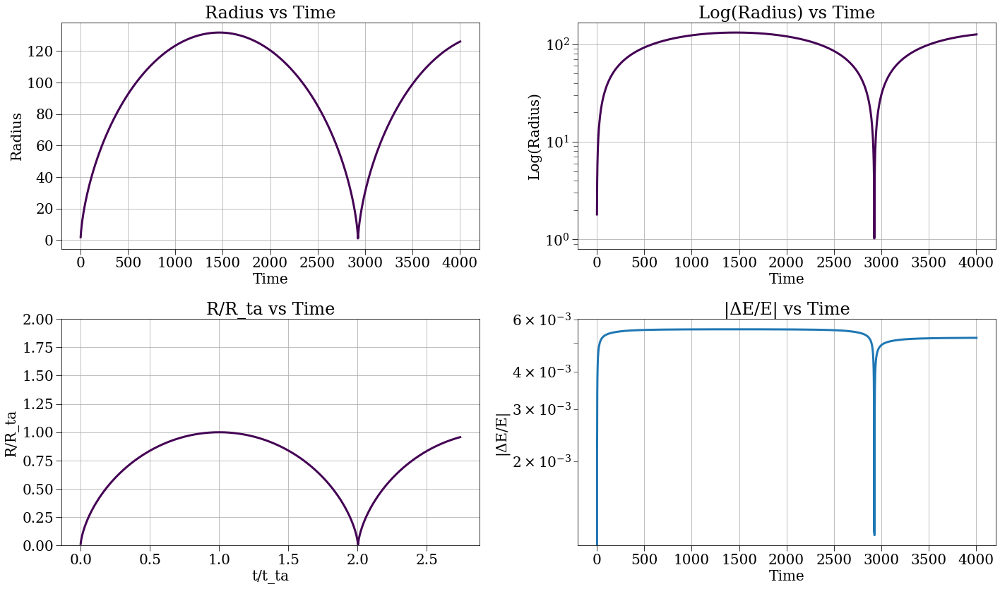

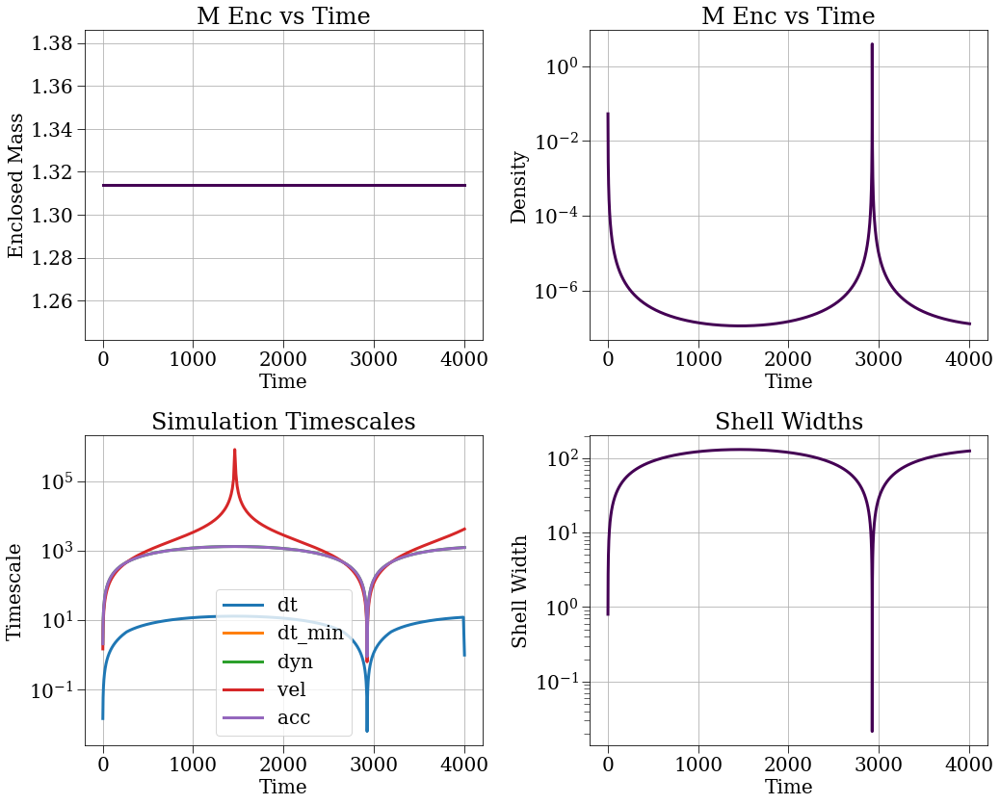

In [7]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-0.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [5]:
def find_turnaround_indices(results):
    r_data = results['r']
    
    # Find turnaround indices for each shell
    ta_indices = []
    for i in range(r_data.shape[1]):
        # Find indices of local maxima for this shell
        maxima_indices = argrelmax(r_data[:, i])[0]
        # If maxima found, use the first one; otherwise use None
        ta_idx = maxima_indices[0] if len(maxima_indices) > 0 else None
        ta_indices.append(ta_idx)
    
    # Process shells that have turnaround points
    valid_shells = [i for i in range(r_data.shape[1]) if ta_indices[i] is not None]
    
    if valid_shells:
        # Calculate r_ta and t_ta only for shells with turnaround points
        r_ta = np.zeros(r_data.shape[1])
        t_ta = np.zeros(r_data.shape[1])
        
        for i in valid_shells:
            r_ta[i] = r_data[ta_indices[i], i]
            t_ta[i] = results['t'][ta_indices[i]]
        r_normalized = np.zeros_like(r_data)
        for i in valid_shells:
            r_normalized[:, i] = r_data[:, i] / r_ta[i]
    return r_ta, t_ta, r_normalized

0.01
(101,) (1000,)


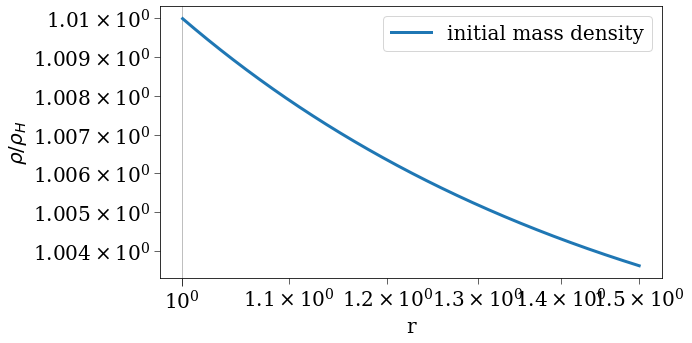

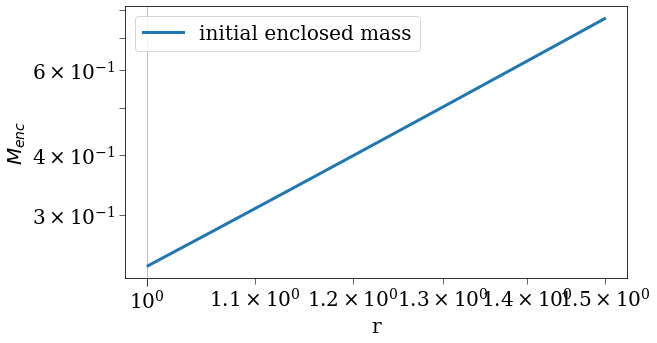

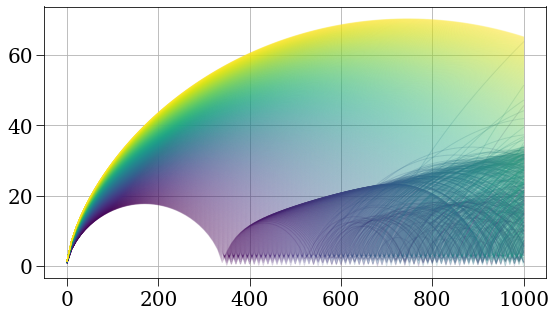

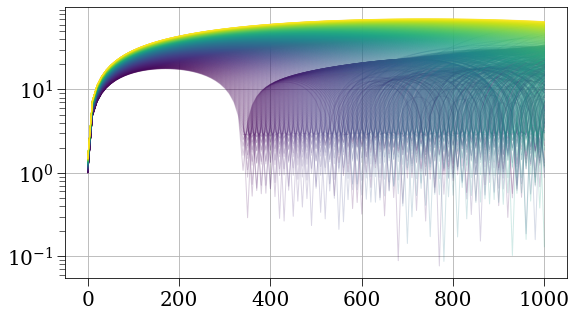

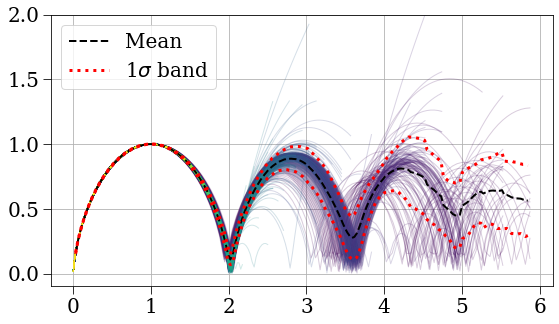

...

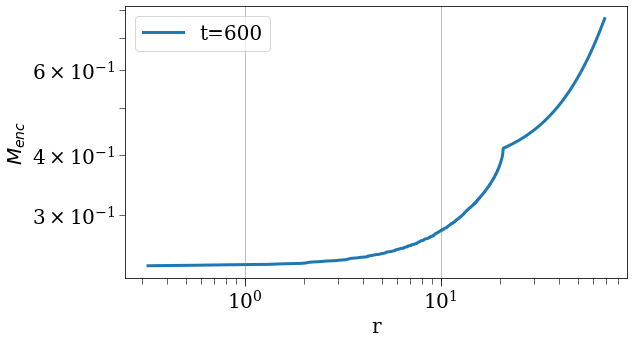

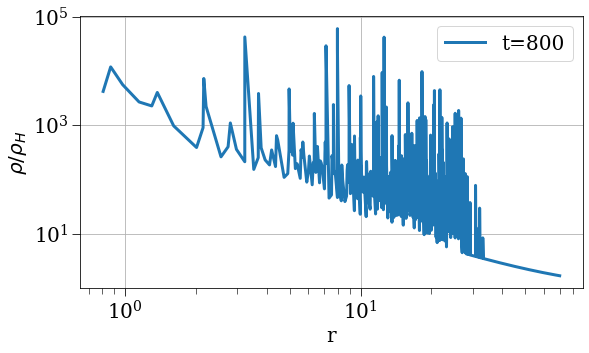

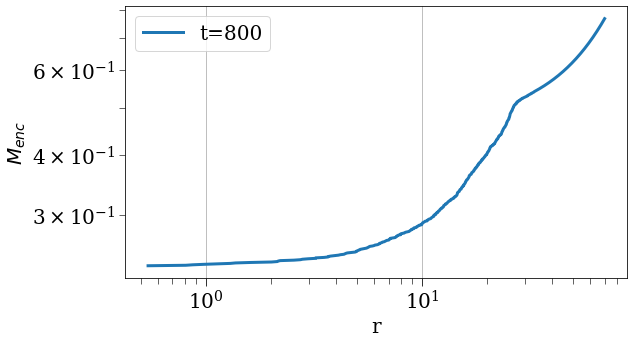

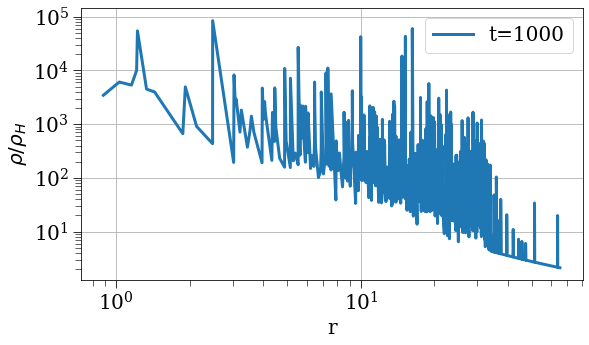

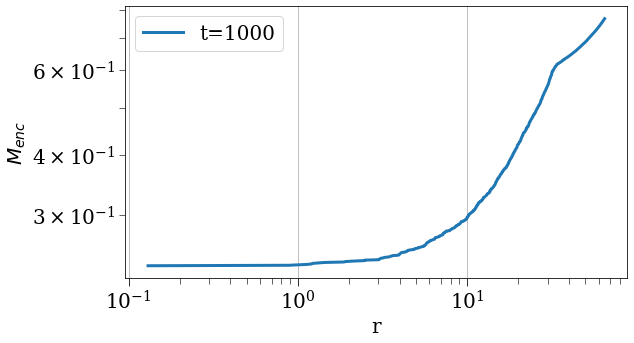

In [35]:
params, results = load_simulation_data('runs/720-3.h5')
#pprint(params)
pprint(params['safety_factor'])


r_ta, t_ta, r_normalized = find_turnaround_indices(results)

tvals = results['t']
rvals = results['r']
mvals = results['m'][0,:]
mvals_w_point_mass = mvals.copy()
mvals_w_point_mass[0] += params['point_mass']
mencvals = results['m_enc']
#volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
rhovals = results['rho_r']

rho0 = results['rho_r'][0,:]
#vol0 = volvals[0,:]
rvals0 = rvals[0,:]
menc0 = mencvals[0,:]

upper_bounds = rvals0
lower_bounds = np.array([1, *rvals0[:-1]])
volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

cmap = plt.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=999)  # assuming i goes from 0 to 999

#plt.plot(rvals0, rho0/rho_H, label='initial profile')
#plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
plt.plot(rvals0, menc0, label='initial enclosed mass')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.semilogy(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
print(tvals.shape, t_ta.shape)
for i in range(1000):
    color = cmap(norm(i))
    plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

# 1. Create a grid of normalized time values
n_points = 200
norm_time_grid = np.linspace(
    0, 
    6, 
    n_points
)

mean_r = np.empty(n_points)
std_r = np.empty(n_points)
median_r = np.empty(n_points)

for j, norm_time in enumerate(norm_time_grid):
    r_values_at_time = []
    for i in range(r_normalized.shape[1]):
        shell_norm_time = (tvals + 1) / t_ta[i]
        # Only interpolate if norm_time is within the shell's time range
        if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
            r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
            r_values_at_time.append(r_val)
    if r_values_at_time:
        mean_r[j] = np.mean(r_values_at_time)
        std_r[j] = np.std(r_values_at_time)
        median_r[j] = np.median(r_values_at_time)
    else:
        mean_r[j] = np.nan
        std_r[j] = np.nan

# 2. Plot, skipping nan values
valid = ~np.isnan(mean_r)
plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
#plt.plot(norm_time_grid[valid], median_r[valid], color='red', label='Median', ls='--', lw=2)
plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
plt.legend()
plt.ylim(None, 2)

plt.figure()
plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
plt.yscale('log')
plt.legend()

num_divisions = 5
for i in range(num_divisions):
    tval = tvals[-1]/num_divisions * (i+1)
    idx = np.argmin(np.abs(tvals - tval))
    rho = results['rho_r'][idx,:]
    rval = rvals[idx,:]
    menc = mencvals[idx,:]


    sorted_indices = np.argsort(rval)
    rval = rval[sorted_indices]
    rho = rho[sorted_indices]
    menc = menc[sorted_indices]
    mvals = mvals[sorted_indices]
    upper_bounds = rval
    lower_bounds = np.array([1, *rval[:-1]])
    vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
    
    plt.figure()
    
    plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rval, menc, label=f't={int(tval)}')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()


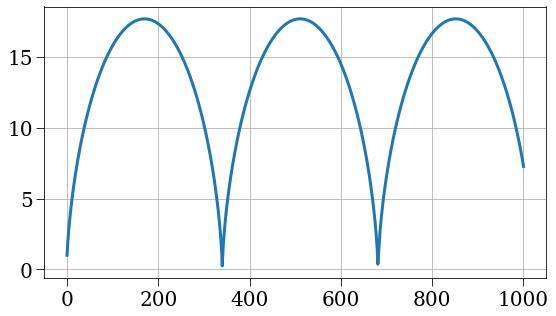

In [11]:
params, results = load_simulation_data('runs/NO_NOTEBOOK_TEST_JOB.h5')
tvals = results['t']
rvals = results['r']
plt.plot(tvals, rvals[:,0])

0.001


(101,) (1000,)


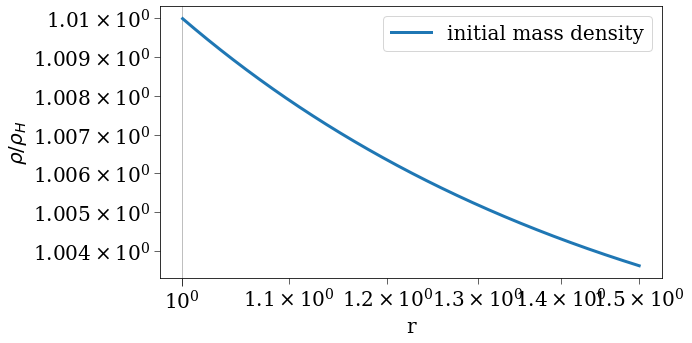

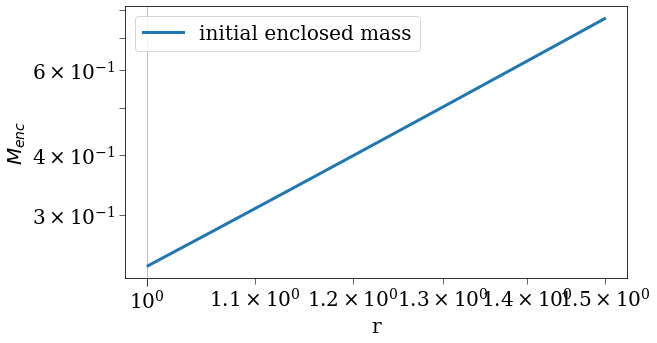

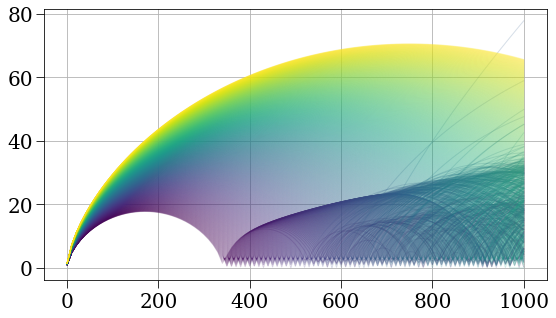

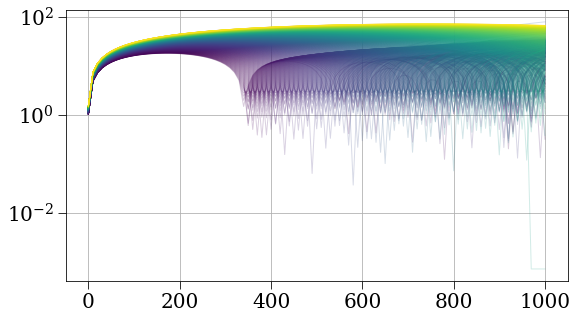

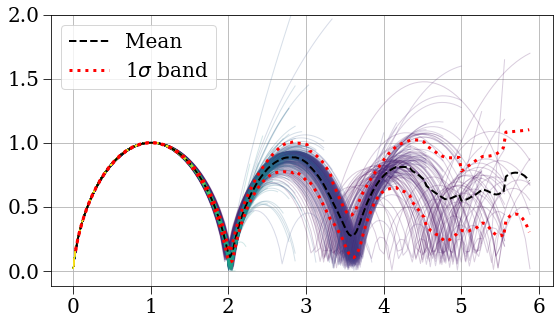

...

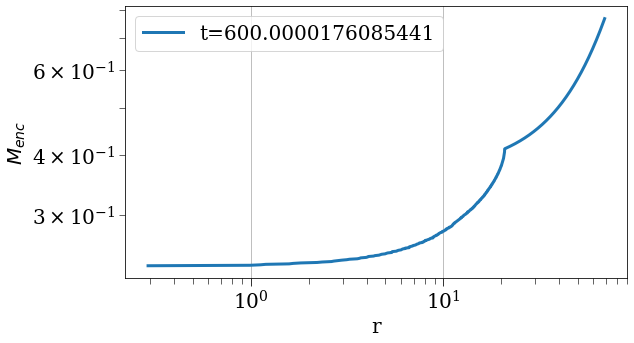

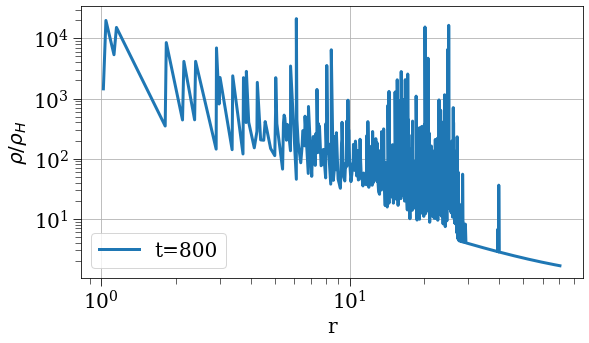

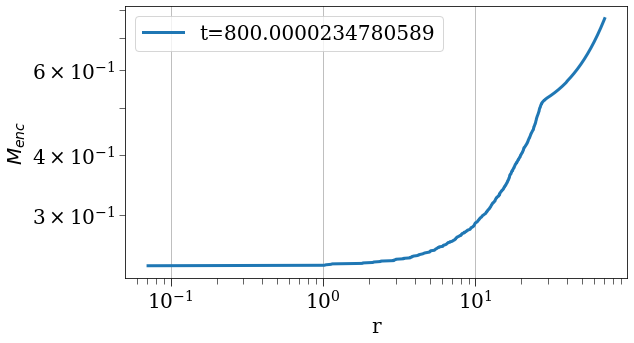

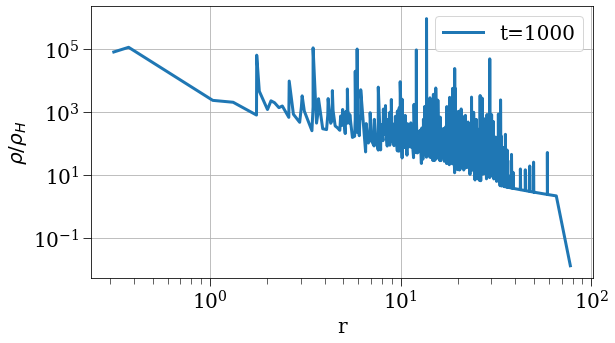

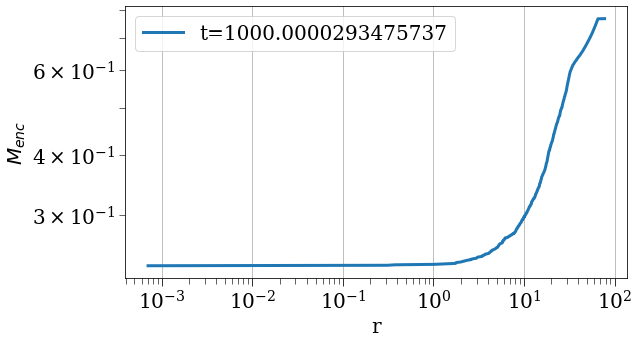

In [33]:
params, results = load_simulation_data('runs/720-5.h5')
#pprint(params)
print(params['safety_factor'])

r_ta, t_ta, r_normalized = find_turnaround_indices(results)

tvals = results['t']
rvals = results['r']
mvals = results['m'][0,:]
mvals_w_point_mass = mvals.copy()
mvals_w_point_mass[0] += params['point_mass']
mencvals = results['m_enc']
#volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
rhovals = results['rho_r']

rho0 = results['rho_r'][0,:]
#vol0 = volvals[0,:]
rvals0 = rvals[0,:]
menc0 = mencvals[0,:]

upper_bounds = rvals0
lower_bounds = np.array([1, *rvals0[:-1]])
volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

cmap = plt.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=999)  # assuming i goes from 0 to 999

#plt.plot(rvals0, rho0/rho_H, label='initial profile')
#plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
plt.plot(rvals0, menc0, label='initial enclosed mass')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.semilogy(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
print(tvals.shape, t_ta.shape)
for i in range(1000):
    color = cmap(norm(i))
    plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

# 1. Create a grid of normalized time values
n_points = 200
norm_time_grid = np.linspace(
    0, 
    6, 
    n_points
)

mean_r = np.empty(n_points)
std_r = np.empty(n_points)
median_r = np.empty(n_points)

for j, norm_time in enumerate(norm_time_grid):
    r_values_at_time = []
    for i in range(r_normalized.shape[1]):
        shell_norm_time = (tvals + 1) / t_ta[i]
        # Only interpolate if norm_time is within the shell's time range
        if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
            r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
            r_values_at_time.append(r_val)
    if r_values_at_time:
        mean_r[j] = np.mean(r_values_at_time)
        std_r[j] = np.std(r_values_at_time)
        median_r[j] = np.median(r_values_at_time)
    else:
        mean_r[j] = np.nan
        std_r[j] = np.nan

# 2. Plot, skipping nan values
valid = ~np.isnan(mean_r)
plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
#plt.plot(norm_time_grid[valid], median_r[valid], color='red', label='Median', ls='--', lw=2)
plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
plt.legend()
plt.ylim(None, 2)

plt.figure()
plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
plt.yscale('log')
plt.legend()

num_divisions = 5
for i in range(num_divisions):
    tval = tvals[-1]/num_divisions * (i+1)
    idx = np.argmin(np.abs(tvals - tval))
    rho = results['rho_r'][idx,:]
    rval = rvals[idx,:]
    menc = mencvals[idx,:]


    sorted_indices = np.argsort(rval)
    rval = rval[sorted_indices]
    rho = rho[sorted_indices]
    menc = menc[sorted_indices]
    mvals = mvals[sorted_indices]
    upper_bounds = rval
    lower_bounds = np.array([1, *rval[:-1]])
    vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
    
    plt.figure()
    
    plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rval, menc, label=f't={tval}')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()


(99,) (1000,)


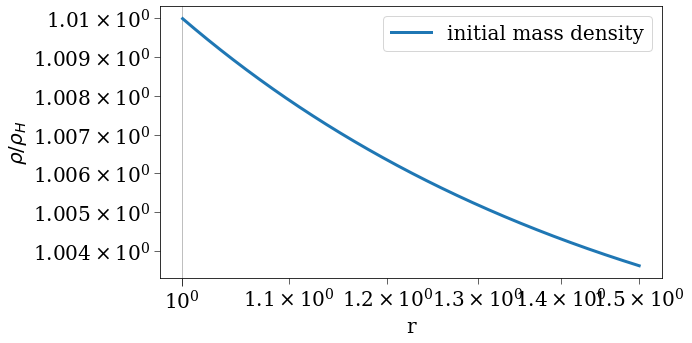

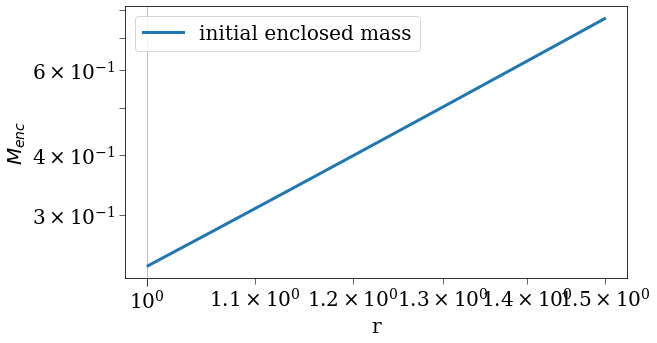

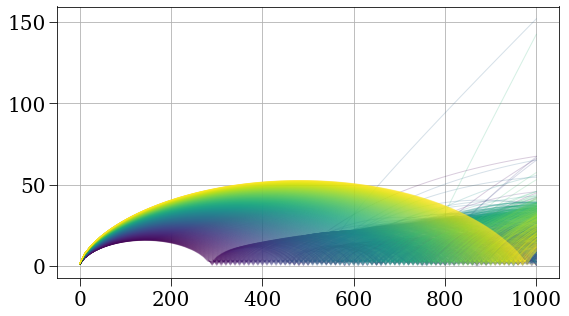

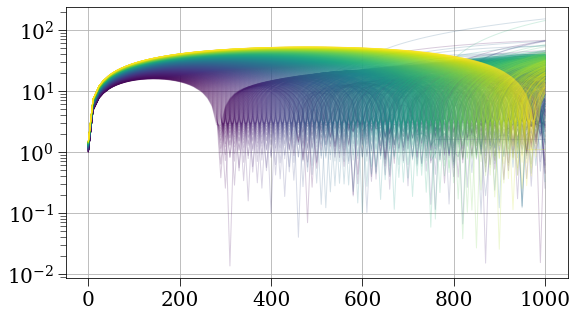

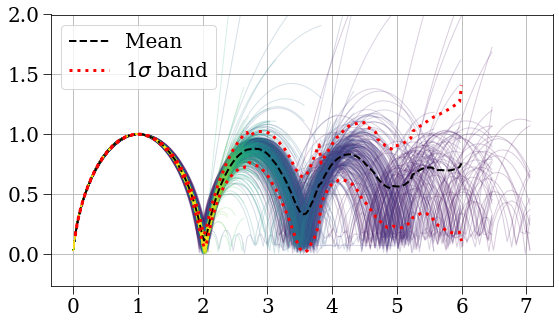

...

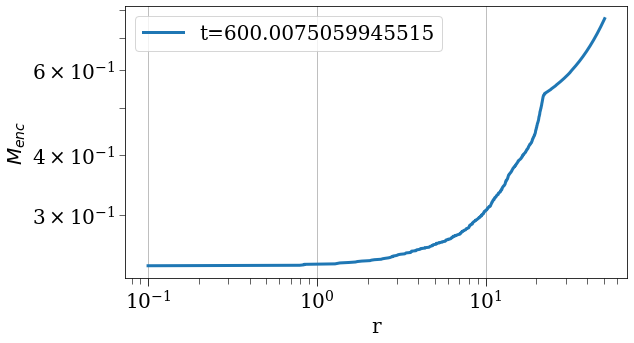

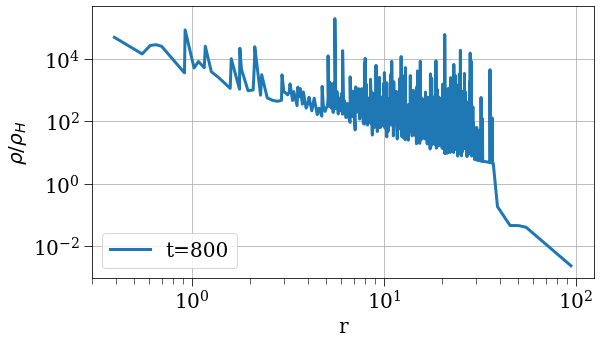

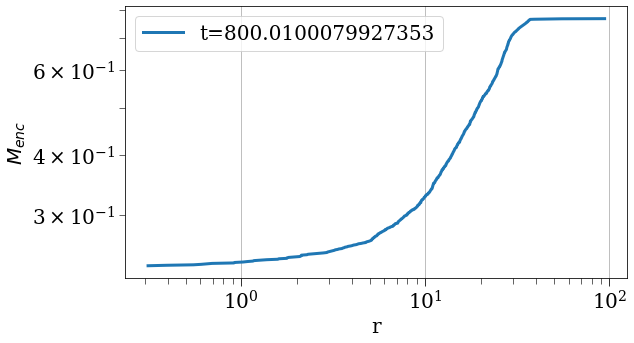

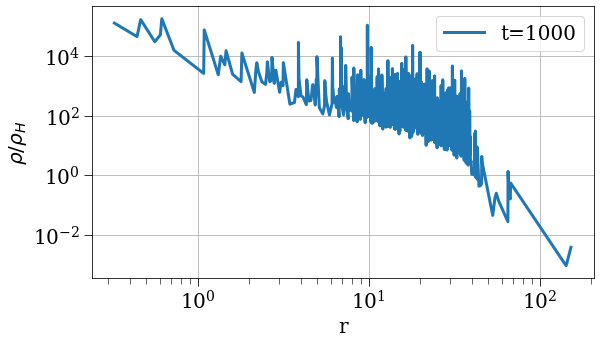

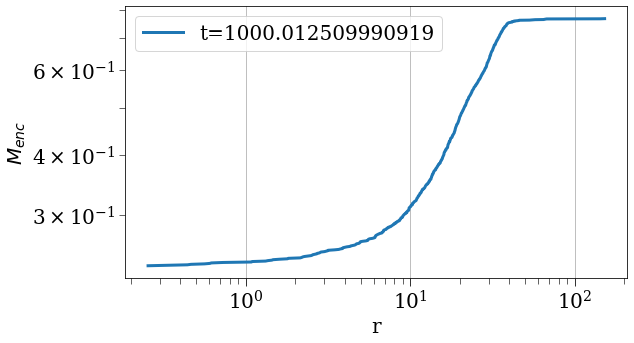

In [31]:
params, results = load_simulation_data('runs/720-4.h5')
#pprint(params)

r_ta, t_ta, r_normalized = find_turnaround_indices(results)

tvals = results['t']
rvals = results['r']
mvals = results['m'][0,:]
mvals_w_point_mass = mvals.copy()
mvals_w_point_mass[0] += params['point_mass']
mencvals = results['m_enc']
#volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
rhovals = results['rho_r']

rho0 = results['rho_r'][0,:]
#vol0 = volvals[0,:]
rvals0 = rvals[0,:]
menc0 = mencvals[0,:]

upper_bounds = rvals0
lower_bounds = np.array([1, *rvals0[:-1]])
volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

cmap = plt.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=999)  # assuming i goes from 0 to 999

#plt.plot(rvals0, rho0/rho_H, label='initial profile')
#plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
plt.plot(rvals0, menc0, label='initial enclosed mass')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.semilogy(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
print(tvals.shape, t_ta.shape)
for i in range(1000):
    color = cmap(norm(i))
    plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

# 1. Create a grid of normalized time values
n_points = 200
norm_time_grid = np.linspace(
    0, 
    6, 
    n_points
)

mean_r = np.empty(n_points)
std_r = np.empty(n_points)
median_r = np.empty(n_points)

for j, norm_time in enumerate(norm_time_grid):
    r_values_at_time = []
    for i in range(r_normalized.shape[1]):
        shell_norm_time = (tvals + 1) / t_ta[i]
        # Only interpolate if norm_time is within the shell's time range
        if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
            r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
            r_values_at_time.append(r_val)
    if r_values_at_time:
        mean_r[j] = np.mean(r_values_at_time)
        std_r[j] = np.std(r_values_at_time)
        median_r[j] = np.median(r_values_at_time)
    else:
        mean_r[j] = np.nan
        std_r[j] = np.nan

# 2. Plot, skipping nan values
valid = ~np.isnan(mean_r)
plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
#plt.plot(norm_time_grid[valid], median_r[valid], color='red', label='Median', ls='--', lw=2)
plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
plt.legend()
plt.ylim(None, 2)

plt.figure()
plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
plt.yscale('log')
plt.legend()


num_divisions = 5
for i in range(num_divisions):
    tval = tvals[-1]/num_divisions * (i+1)
    idx = np.argmin(np.abs(tvals - tval))
    rho = results['rho_r'][idx,:]
    rval = rvals[idx,:]
    menc = mencvals[idx,:]


    sorted_indices = np.argsort(rval)
    rval = rval[sorted_indices]
    rho = rho[sorted_indices]
    menc = menc[sorted_indices]
    mvals = mvals[sorted_indices]
    upper_bounds = rval
    lower_bounds = np.array([1, *rval[:-1]])
    vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
    
    plt.figure()
    
    plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rval, menc, label=f't={tval}')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()


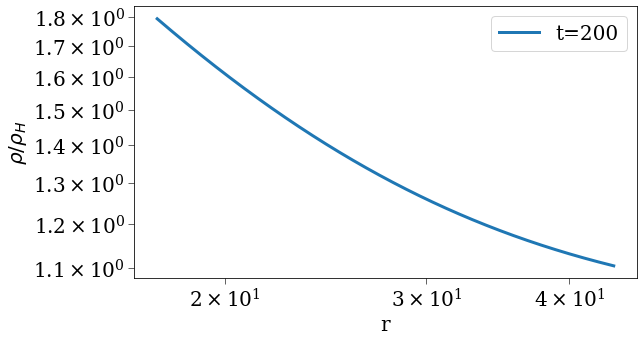

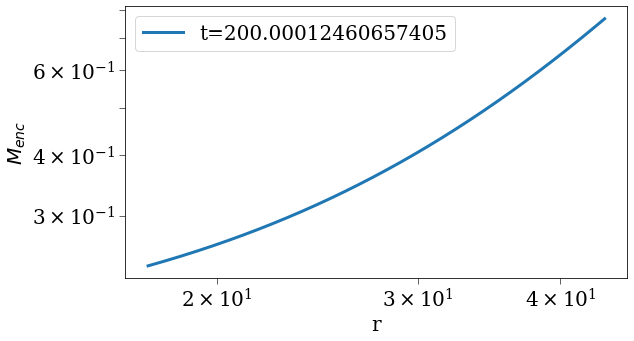

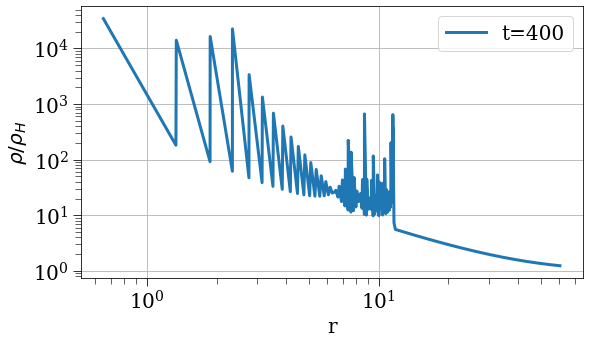

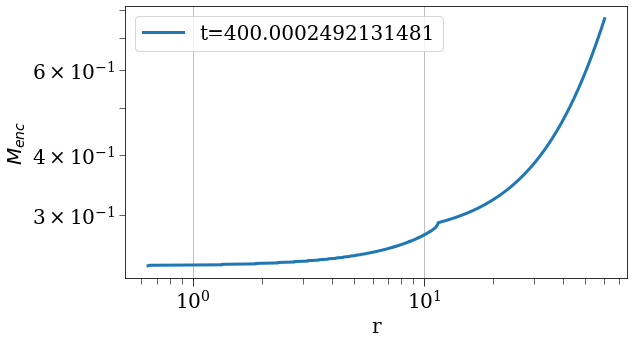

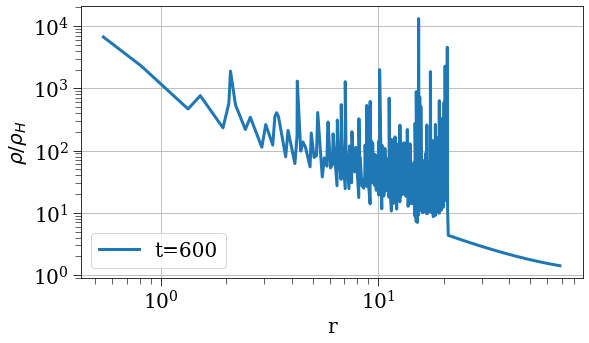

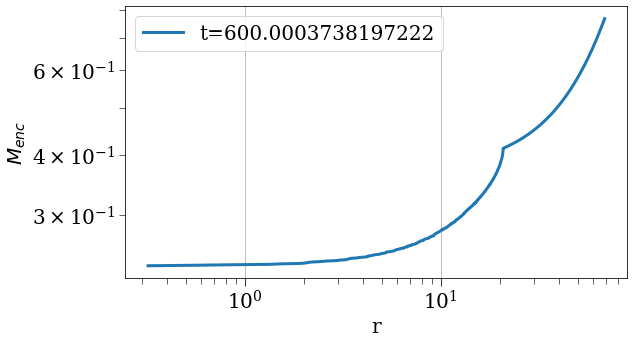

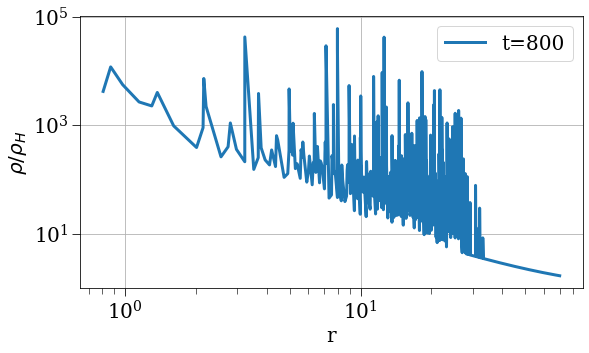

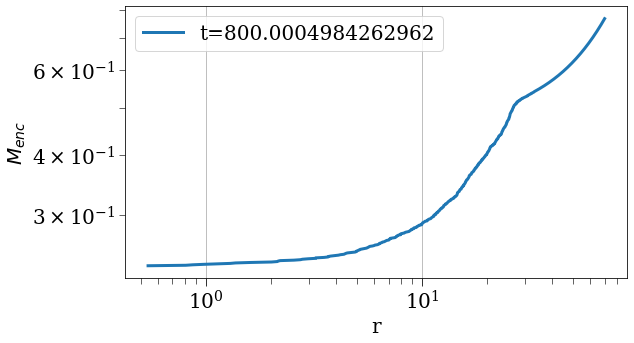

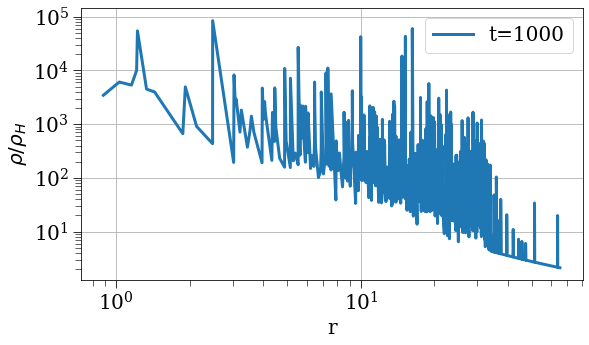

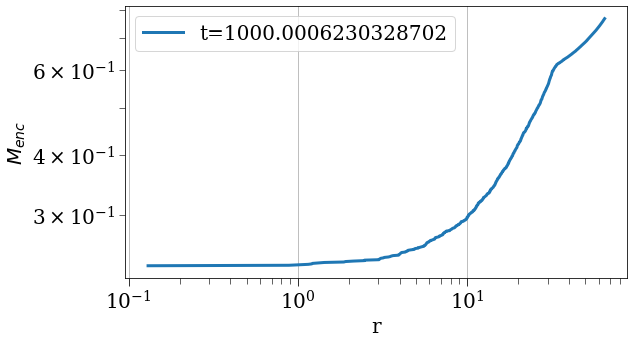

In [14]:
num_divisions = 5
for i in range(num_divisions):
    tval = tvals[-1]/num_divisions * (i+1)
    idx = np.argmin(np.abs(tvals - tval))
    rho = results['rho_r'][idx,:]
    rval = rvals[idx,:]
    menc = mencvals[idx,:]


    sorted_indices = np.argsort(rval)
    rval = rval[sorted_indices]
    rho = rho[sorted_indices]
    menc = menc[sorted_indices]
    mvals = mvals[sorted_indices]
    upper_bounds = rval
    lower_bounds = np.array([1, *rval[:-1]])
    vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
    
    plt.figure()
    
    plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rval, menc, label=f't={tval}')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

(101,) (1000,)


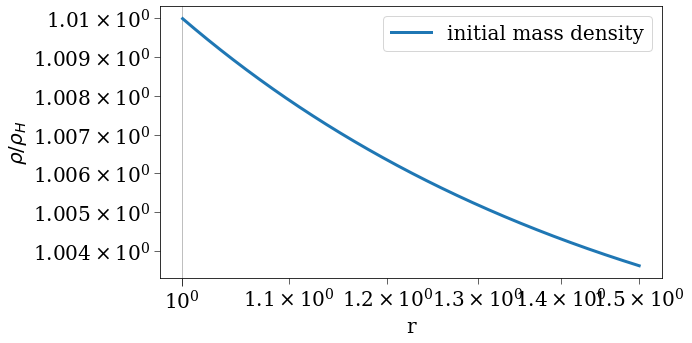

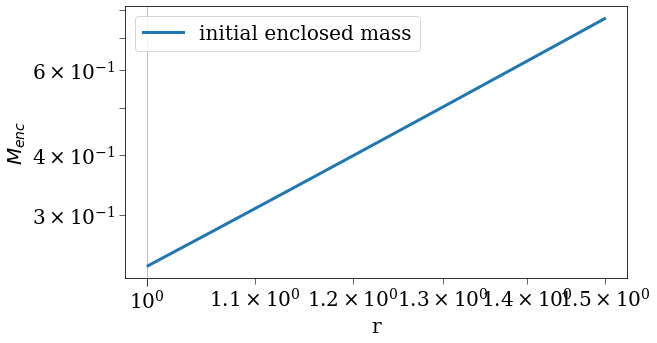

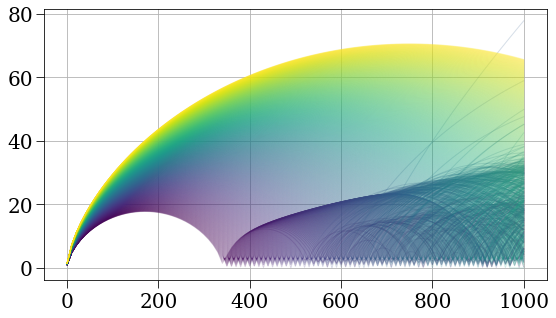

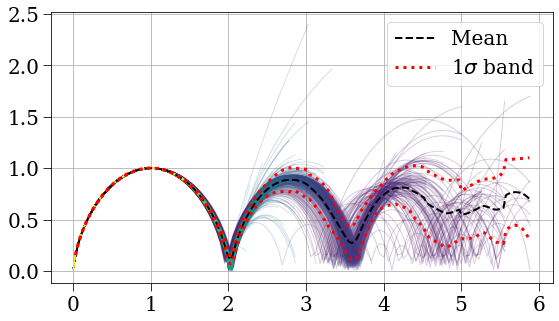

In [9]:
params, results = load_simulation_data('runs/720-5.h5')
#pprint(params)

r_ta, t_ta, r_normalized = find_turnaround_indices(results)

tvals = results['t']
rvals = results['r']
mvals = results['m'][0,:]
mvals_w_point_mass = mvals.copy()
mvals_w_point_mass[0] += params['point_mass']
mencvals = results['m_enc']
#volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
rhovals = results['rho_r']

rho0 = results['rho_r'][0,:]
#vol0 = volvals[0,:]
rvals0 = rvals[0,:]
menc0 = mencvals[0,:]

upper_bounds = rvals0
lower_bounds = np.array([1, *rvals0[:-1]])
volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

cmap = plt.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=999)  # assuming i goes from 0 to 999

#plt.plot(rvals0, rho0/rho_H, label='initial profile')
#plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
plt.plot(rvals0, menc0, label='initial enclosed mass')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

plt.figure()
for i in range(1000):
    color = cmap(norm(i))
    plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

plt.figure()
print(tvals.shape, t_ta.shape)
for i in range(1000):
    color = cmap(norm(i))
    plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

# 1. Create a grid of normalized time values
n_points = 200
norm_time_grid = np.linspace(
    0, 
    6, 
    n_points
)

mean_r = np.empty(n_points)
std_r = np.empty(n_points)
median_r = np.empty(n_points)

for j, norm_time in enumerate(norm_time_grid):
    r_values_at_time = []
    for i in range(r_normalized.shape[1]):
        shell_norm_time = (tvals + 1) / t_ta[i]
        # Only interpolate if norm_time is within the shell's time range
        if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
            r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
            r_values_at_time.append(r_val)
    if r_values_at_time:
        mean_r[j] = np.mean(r_values_at_time)
        std_r[j] = np.std(r_values_at_time)
        median_r[j] = np.median(r_values_at_time)
    else:
        mean_r[j] = np.nan
        std_r[j] = np.nan

# 2. Plot, skipping nan values
valid = ~np.isnan(mean_r)
plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
#plt.plot(norm_time_grid[valid], median_r[valid], color='red', label='Median', ls='--', lw=2)
plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
plt.legend()


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 10,
 'save_filename': 'runs/720-5.h5',
 'save_strategy': '

2025-07-20 19:36:59,169 - collapse - INFO - Simulation setup complete


2025-07-20 21:15:03,747 - DEBUG - Saved dataset t with shape (101,)
2025-07-20 21:15:03,749 - DEBUG - Saved dataset dt with shape (101,)
2025-07-20 21:15:03,756 - DEBUG - Saved dataset r with shape (101, 1000)
2025-07-20 21:15:03,759 - DEBUG - Saved dataset v with shape (101, 1000)
2025-07-20 21:15:03,765 - DEBUG - Saved dataset a with shape (101, 1000)
2025-07-20 21:15:03,770 - DEBUG - Saved dataset m_enc with shape (101, 1000)
2025-07-20 21:15:03,775 - DEBUG - Saved dataset rho_r with shape (101, 1000)
2025-07-20 21:15:03,776 - WARNING - Skipping pressure because all values are None
2025-07-20 21:15:03,777 - WARNING - Skipping dpressure_drho because all values are None
2025-07-20 21:15:03,777 - WARNING - Skipping rho_prime because all values are None
2025-07-20 21:15:03,780 - DEBUG - Saved dataset e_tot with shape (101, 1000)
2025-07-20 21:15:03,785 - DEBUG - Saved dataset e_g with shape (101, 1000)
2025-07-20 21:15:03,790 - DEBUG - Saved dataset e_k with shape (101, 1000)
2025-07-20

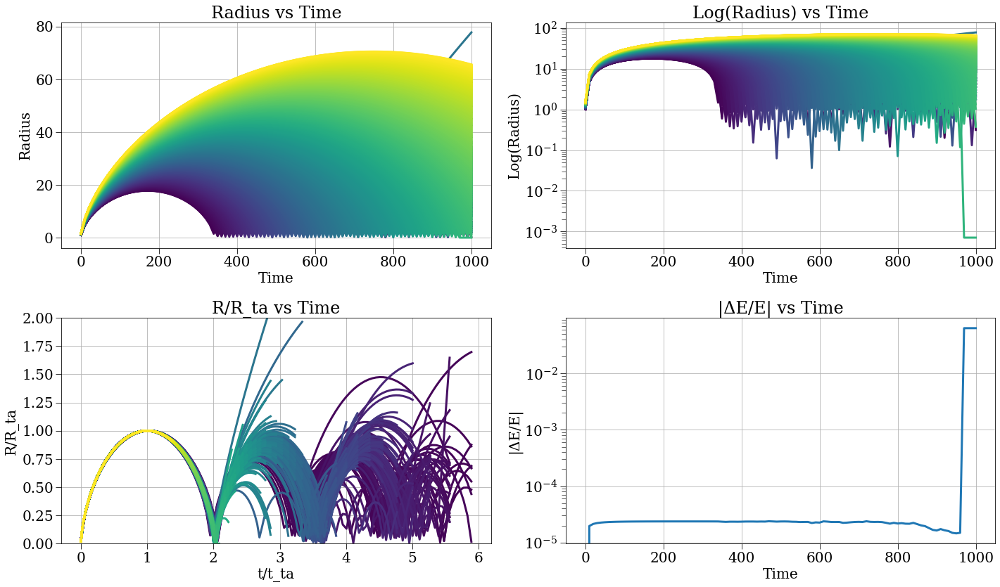

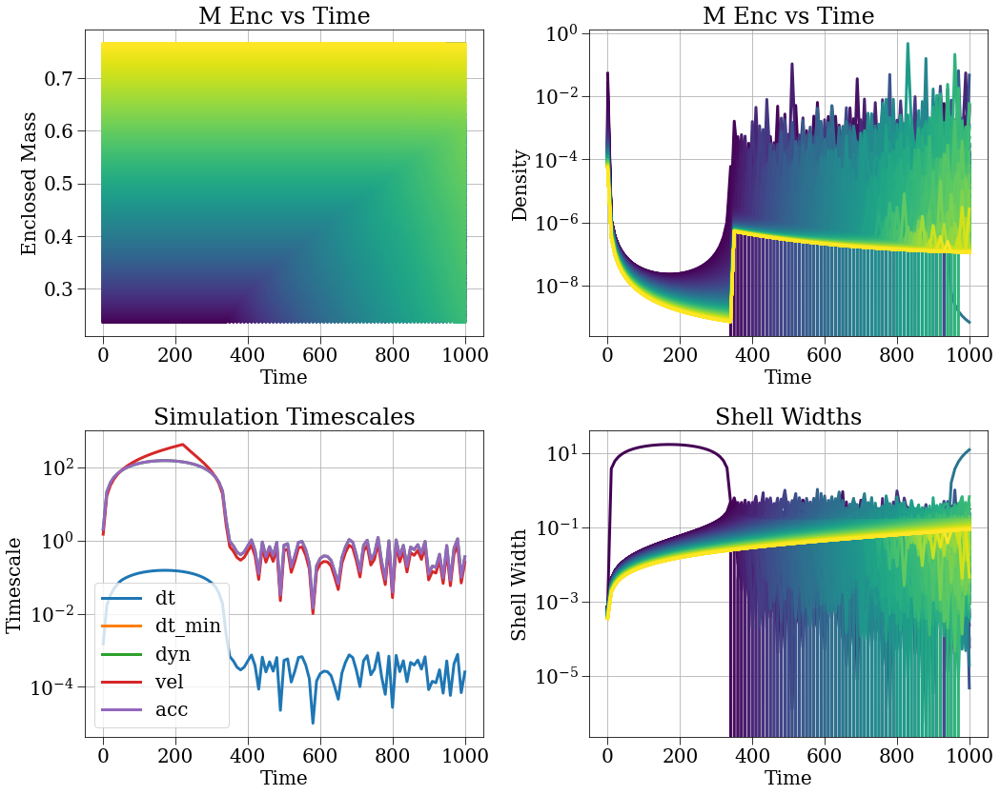

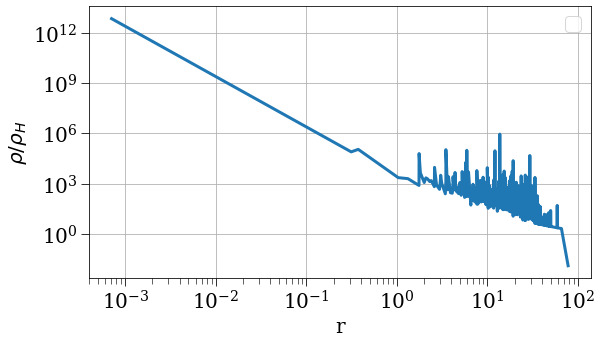

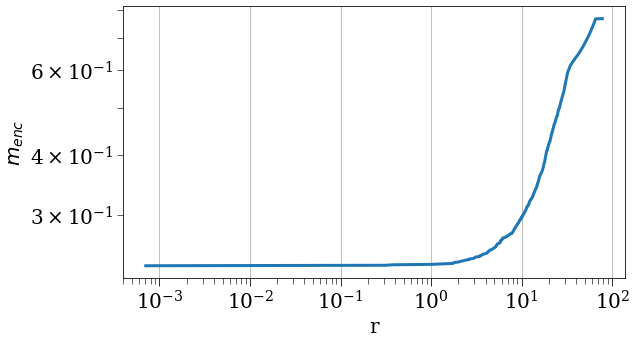

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/720-5.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.1,
 'save_dt': 10,
 'save_filename': 'runs/720-4.h5',
 'save_strategy': 'vf

2025-07-20 19:31:08,158 - collapse - INFO - Simulation setup complete


2025-07-20 19:33:16,193 - DEBUG - Saved dataset t with shape (99,)
2025-07-20 19:33:16,195 - DEBUG - Saved dataset dt with shape (99,)
2025-07-20 19:33:16,204 - DEBUG - Saved dataset r with shape (99, 1000)
2025-07-20 19:33:16,208 - DEBUG - Saved dataset v with shape (99, 1000)
2025-07-20 19:33:16,213 - DEBUG - Saved dataset a with shape (99, 1000)
2025-07-20 19:33:16,218 - DEBUG - Saved dataset m_enc with shape (99, 1000)
2025-07-20 19:33:16,223 - DEBUG - Saved dataset rho_r with shape (99, 1000)
2025-07-20 19:33:16,224 - WARNING - Skipping pressure because all values are None
2025-07-20 19:33:16,225 - WARNING - Skipping dpressure_drho because all values are None
2025-07-20 19:33:16,226 - WARNING - Skipping rho_prime because all values are None
2025-07-20 19:33:16,230 - DEBUG - Saved dataset e_tot with shape (99, 1000)
2025-07-20 19:33:16,235 - DEBUG - Saved dataset e_g with shape (99, 1000)
2025-07-20 19:33:16,240 - DEBUG - Saved dataset e_k with shape (99, 1000)
2025-07-20 19:33:16,

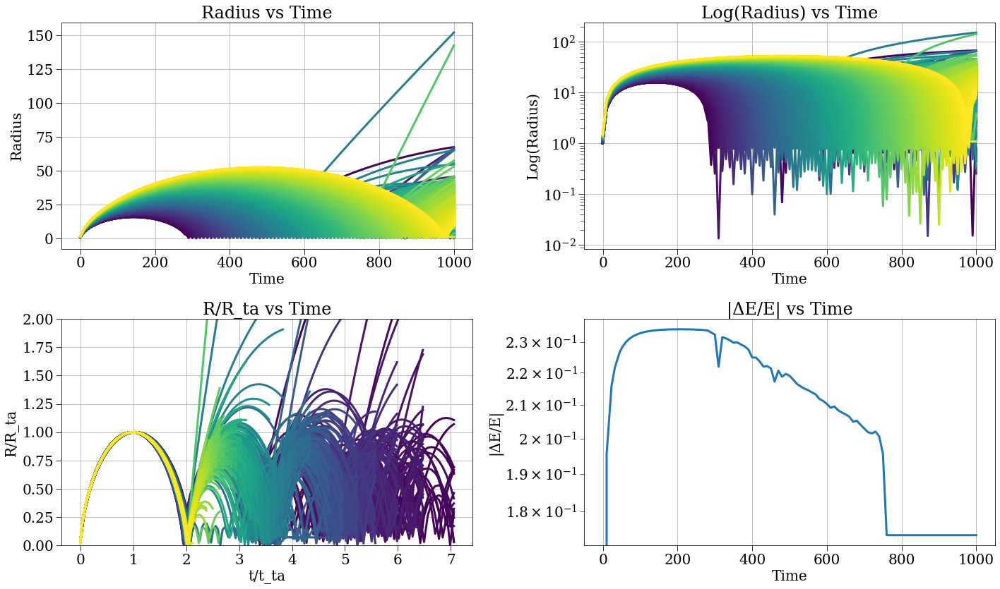

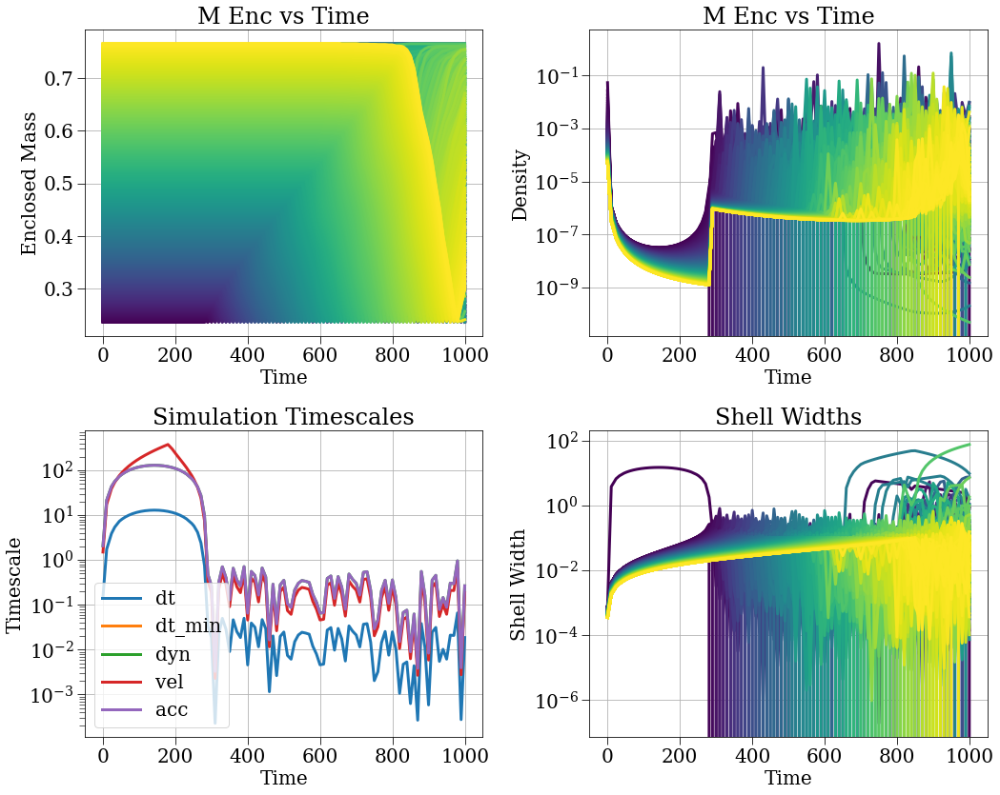

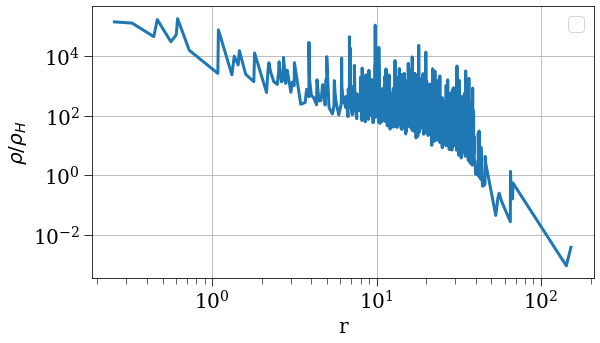

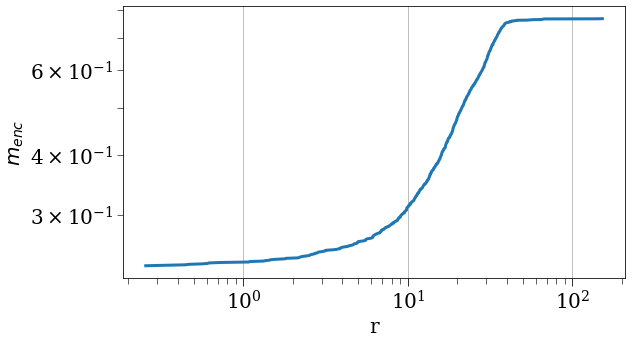

In [5]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/720-4.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

(99, 1000) (1000,)


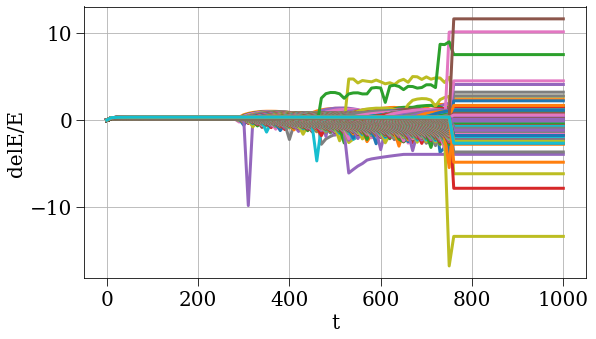

[     0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.      0.      0.      0.
      0.      0.      0.      0.      0.      0.   

In [7]:
evals = results['e_tot']
e0vals = evals[0,:]
print(evals.shape, e0vals.shape)
deles = (evals - e0vals)/e0vals
plt.plot(results['t'], deles)
plt.xlabel('t')
plt.ylabel('delE/E')
plt.show()
print(sc.problem_idx)
print(sc.absorbed)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/720-3.h5',
 'save_strategy': '

2025-07-20 18:58:32,535 - collapse - INFO - Simulation setup complete


2025-07-20 19:07:14,898 - DEBUG - Saved dataset t with shape (101,)
2025-07-20 19:07:14,900 - DEBUG - Saved dataset dt with shape (101,)
2025-07-20 19:07:14,909 - DEBUG - Saved dataset r with shape (101, 1000)
2025-07-20 19:07:14,913 - DEBUG - Saved dataset v with shape (101, 1000)
2025-07-20 19:07:14,919 - DEBUG - Saved dataset a with shape (101, 1000)
2025-07-20 19:07:14,924 - DEBUG - Saved dataset m_enc with shape (101, 1000)
2025-07-20 19:07:14,930 - DEBUG - Saved dataset rho_r with shape (101, 1000)
2025-07-20 19:07:14,931 - WARNING - Skipping pressure because all values are None
2025-07-20 19:07:14,931 - WARNING - Skipping dpressure_drho because all values are None
2025-07-20 19:07:14,932 - WARNING - Skipping rho_prime because all values are None
2025-07-20 19:07:14,936 - DEBUG - Saved dataset e_tot with shape (101, 1000)
2025-07-20 19:07:14,941 - DEBUG - Saved dataset e_g with shape (101, 1000)
2025-07-20 19:07:14,951 - DEBUG - Saved dataset e_k with shape (101, 1000)
2025-07-20

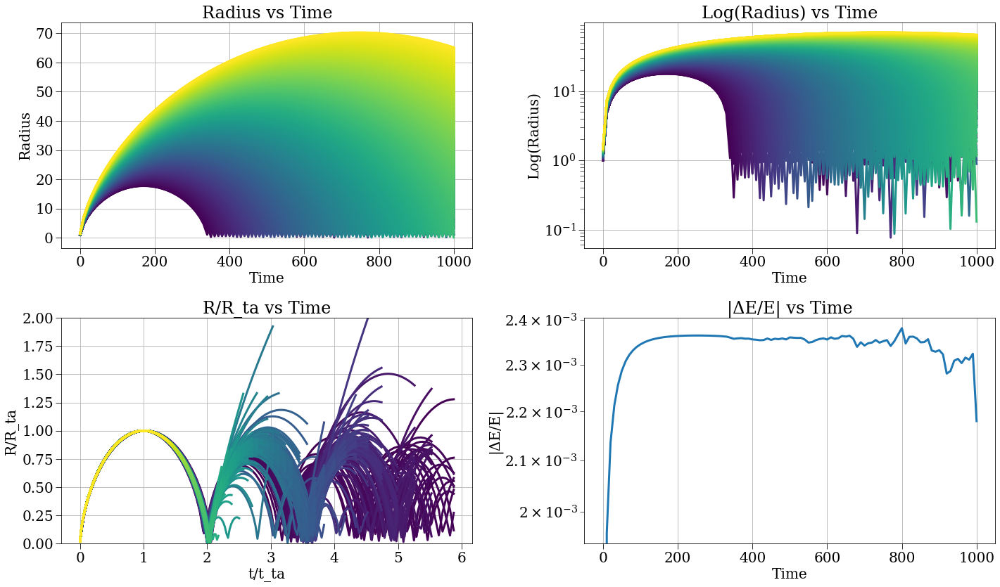

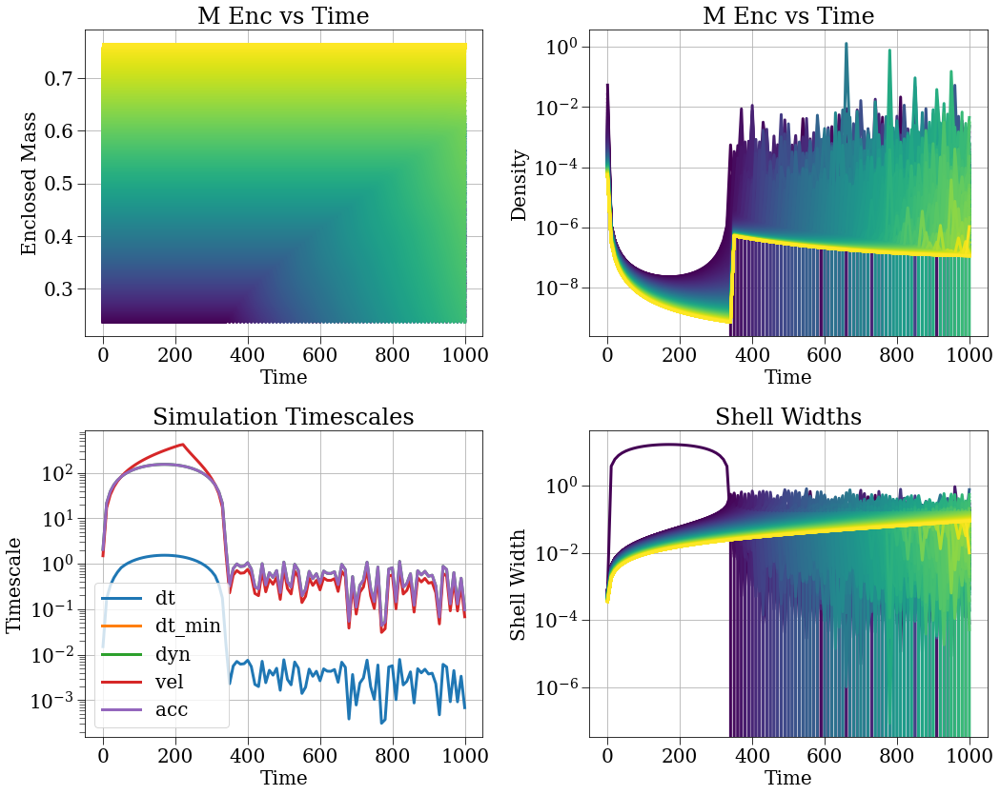

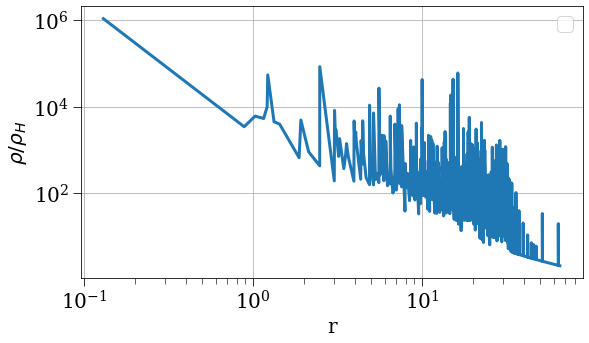

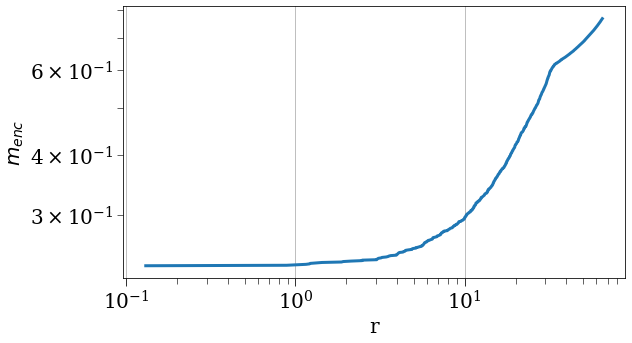

In [18]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/720-3.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

2025-07-20 18:48:04,004 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 20,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.2,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/720-2.h5',
 'save_strategy': 'vflip',
 

2025-07-20 18:54:09,803 - DEBUG - Saved dataset t with shape (1644,)
2025-07-20 18:54:09,805 - DEBUG - Saved dataset dt with shape (1644,)
2025-07-20 18:54:09,811 - DEBUG - Saved dataset r with shape (1644, 20)
2025-07-20 18:54:09,814 - DEBUG - Saved dataset v with shape (1644, 20)
2025-07-20 18:54:09,816 - DEBUG - Saved dataset a with shape (1644, 20)
2025-07-20 18:54:09,819 - DEBUG - Saved dataset m_enc with shape (1644, 20)
2025-07-20 18:54:09,821 - DEBUG - Saved dataset rho_r with shape (1644, 20)
2025-07-20 18:54:09,822 - WARNING - Skipping pressure because all values are None
2025-07-20 18:54:09,823 - WARNING - Skipping dpressure_drho because all values are None
2025-07-20 18:54:09,823 - WARNING - Skipping rho_prime because all values are None
2025-07-20 18:54:09,826 - DEBUG - Saved dataset e_tot with shape (1644, 20)
2025-07-20 18:54:09,829 - DEBUG - Saved dataset e_g with shape (1644, 20)
2025-07-20 18:54:09,831 - DEBUG - Saved dataset e_k with shape (1644, 20)
2025-07-20 18:54

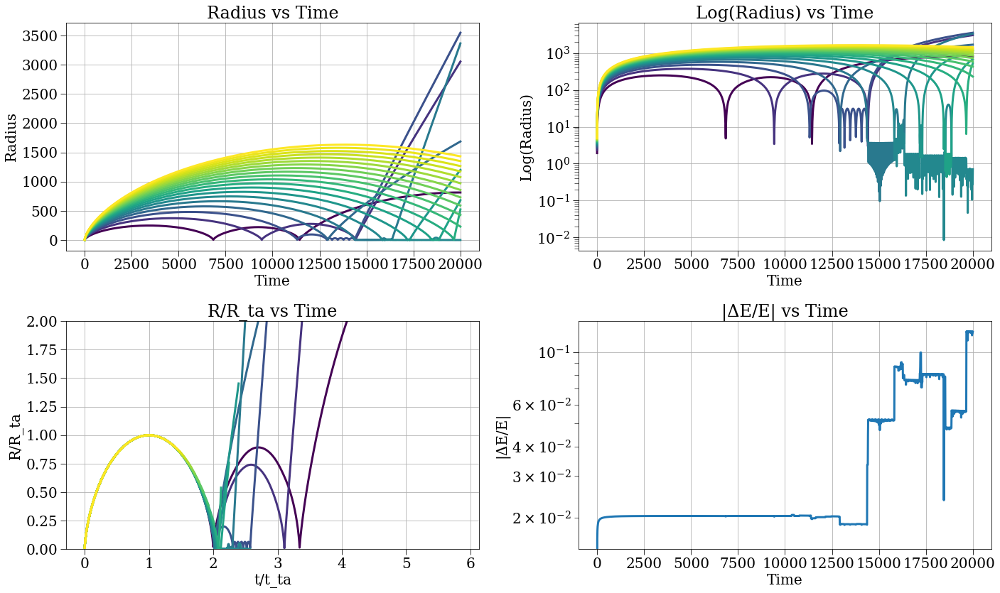

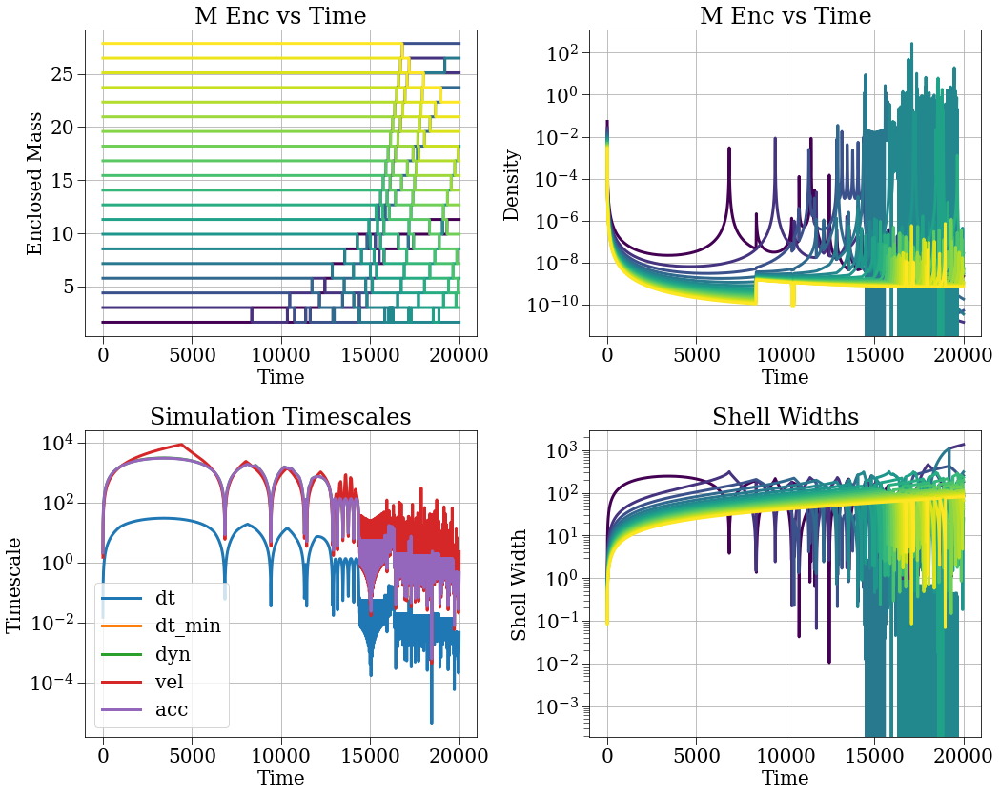

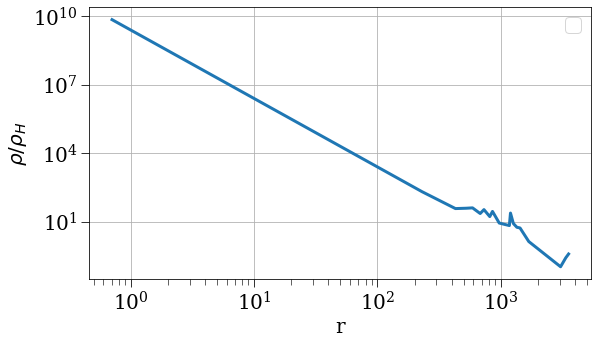

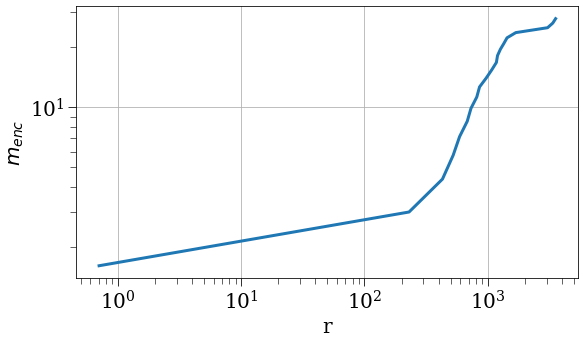

In [12]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/720-2.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

2025-07-20 18:47:38,124 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 20,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.2,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/720-1.h5',
 'save_strategy': 'vflip',
 '

2025-07-20 18:47:45,602 - DEBUG - Saved dataset t with shape (1644,)
2025-07-20 18:47:45,603 - DEBUG - Saved dataset dt with shape (1644,)
2025-07-20 18:47:45,609 - DEBUG - Saved dataset r with shape (1644, 20)
2025-07-20 18:47:45,611 - DEBUG - Saved dataset v with shape (1644, 20)
2025-07-20 18:47:45,614 - DEBUG - Saved dataset a with shape (1644, 20)
2025-07-20 18:47:45,616 - DEBUG - Saved dataset m_enc with shape (1644, 20)
2025-07-20 18:47:45,619 - DEBUG - Saved dataset rho_r with shape (1644, 20)
2025-07-20 18:47:45,619 - WARNING - Skipping pressure because all values are None
2025-07-20 18:47:45,620 - WARNING - Skipping dpressure_drho because all values are None
2025-07-20 18:47:45,621 - WARNING - Skipping rho_prime because all values are None
2025-07-20 18:47:45,623 - DEBUG - Saved dataset e_tot with shape (1644, 20)
2025-07-20 18:47:45,625 - DEBUG - Saved dataset e_g with shape (1644, 20)
2025-07-20 18:47:45,628 - DEBUG - Saved dataset e_k with shape (1644, 20)
2025-07-20 18:47

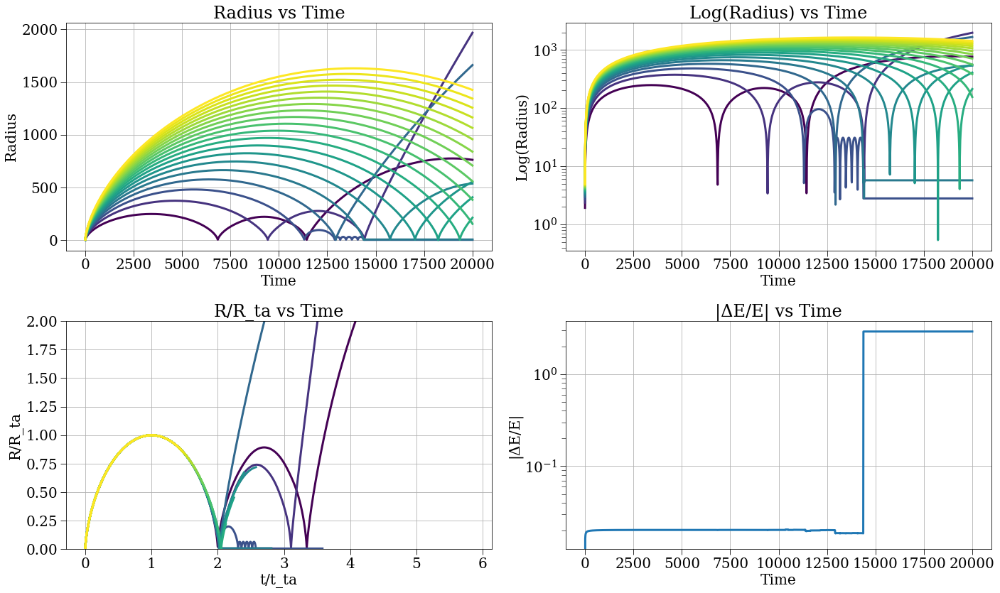

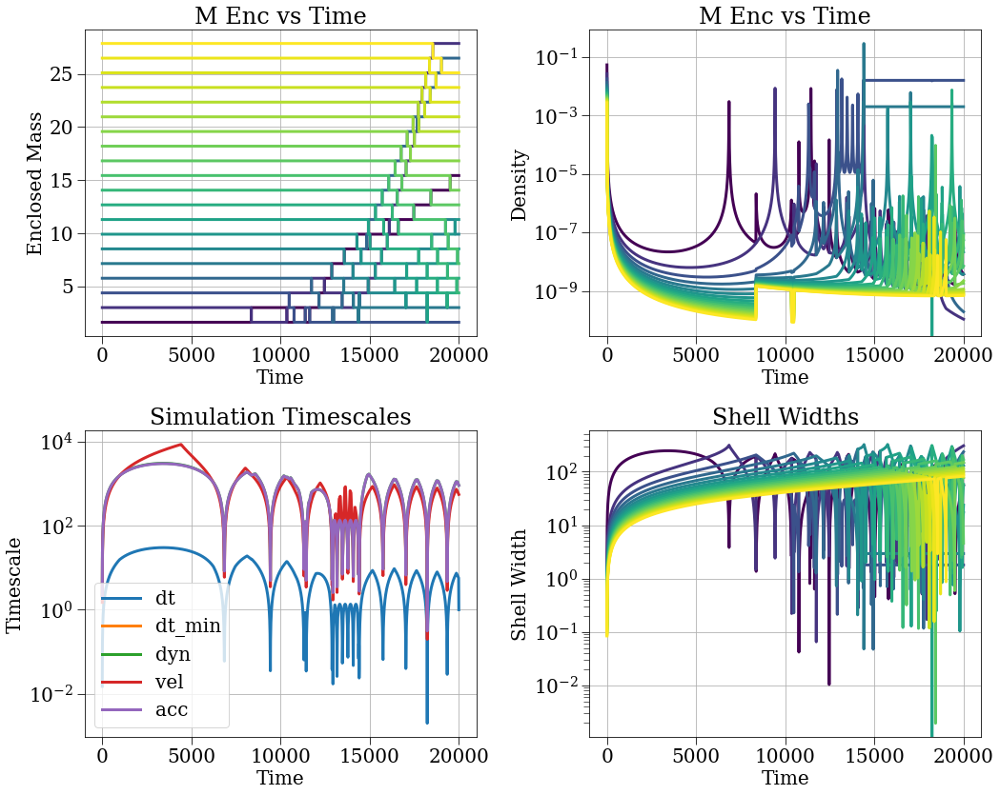

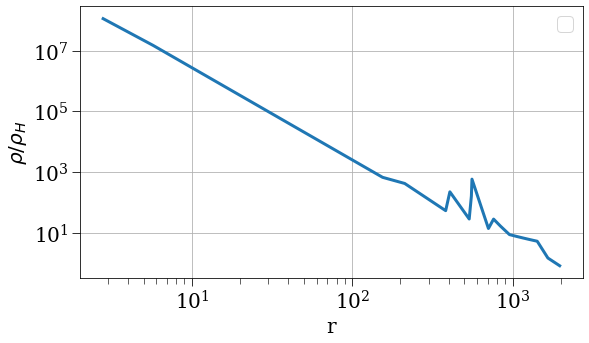

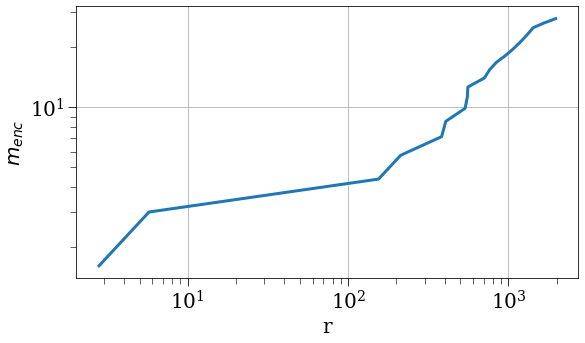

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/720-1.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

In [6]:
print(sc.problem_idx)

[    0.     0. 21194.     0. 15947.     0.     0.     0.     0.     0.
     0.     0.     0.     0.     0.     0.     0.     0.     0.     0.]


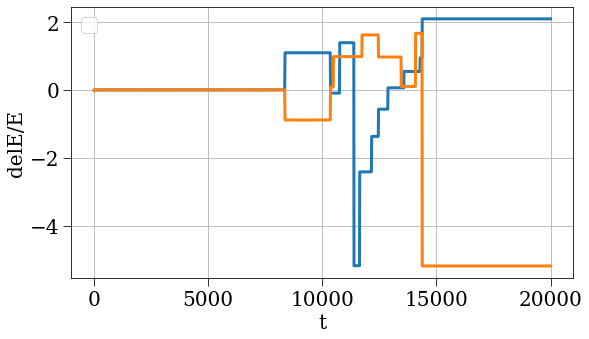

In [7]:
e1 = results['e_tot'][:,0]
e2 = results['e_tot'][:,1]
del1 = (e1-e1[0])/e1[0]
del2 = (e2-e2[0])/e2[0]
plt.plot(results['t'], del1)
plt.plot(results['t'], del2)
plt.legend()
plt.xlabel('t')
plt.ylabel('delE/E')
plt.show()

In [8]:
sc.absorbed

array([False, False,  True, False,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False])

In [5]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-8.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 20,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.2,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-8.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_

2025-07-17 02:43:03,196 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

2025-07-17 02:40:07,130 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 2.373227743697057,
 'r_max': 2.373227743697057,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-8.h5',
 'save_strategy': 'vflip',
 'shell_density_strateg

2025-07-17 02:40:08,158 - DEBUG - Saved dataset t with shape (1078,)
2025-07-17 02:40:08,160 - DEBUG - Saved dataset dt with shape (1078,)
2025-07-17 02:40:08,163 - DEBUG - Saved dataset r with shape (1078, 1)
2025-07-17 02:40:08,165 - DEBUG - Saved dataset v with shape (1078, 1)
2025-07-17 02:40:08,167 - DEBUG - Saved dataset a with shape (1078, 1)
2025-07-17 02:40:08,170 - DEBUG - Saved dataset m_enc with shape (1078, 1)
2025-07-17 02:40:08,172 - DEBUG - Saved dataset rho_r with shape (1078, 1)
2025-07-17 02:40:08,173 - WARNING - Skipping pressure because all values are None
2025-07-17 02:40:08,174 - WARNING - Skipping dpressure_drho because all values are None
2025-07-17 02:40:08,176 - WARNING - Skipping rho_prime because all values are None
2025-07-17 02:40:08,179 - DEBUG - Saved dataset e_tot with shape (1078, 1)
2025-07-17 02:40:08,190 - DEBUG - Saved dataset e_g with shape (1078, 1)
2025-07-17 02:40:08,193 - DEBUG - Saved dataset e_k with shape (1078, 1)
2025-07-17 02:40:08,194 

         731135 function calls (731025 primitive calls) in 1.125 seconds

   Ordered by: cumulative time
   List reduced from 198 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.009    0.009    1.125    1.125 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
     7828    0.035    0.000    0.925    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
     7828    0.025    0.000    0.615    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
    15656    0.154    0.000    0.375    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
    15656    0.090    0.000    0.310    0.000 /home/jsipple/one_d_spherical_collapse/one

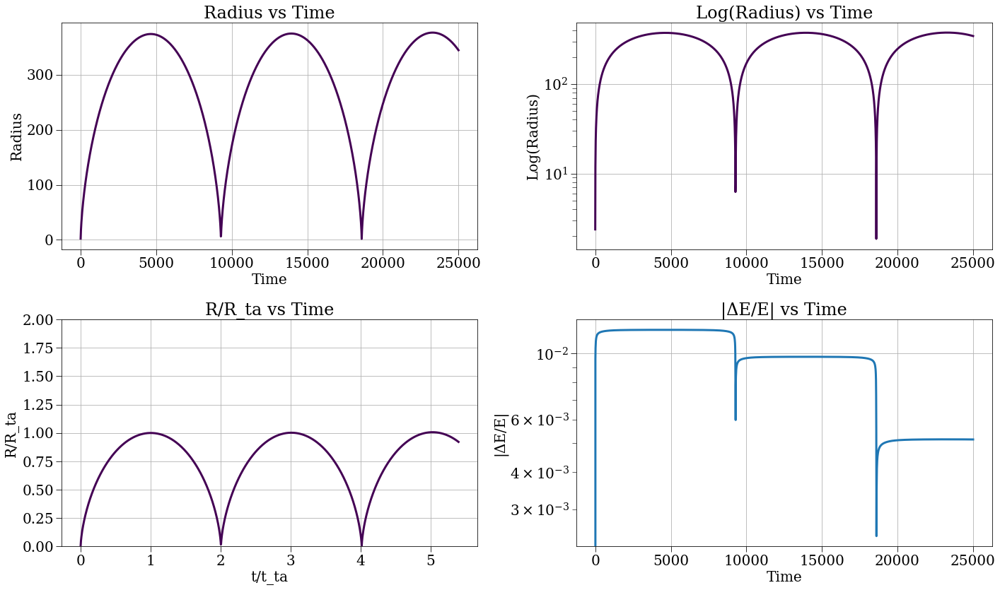

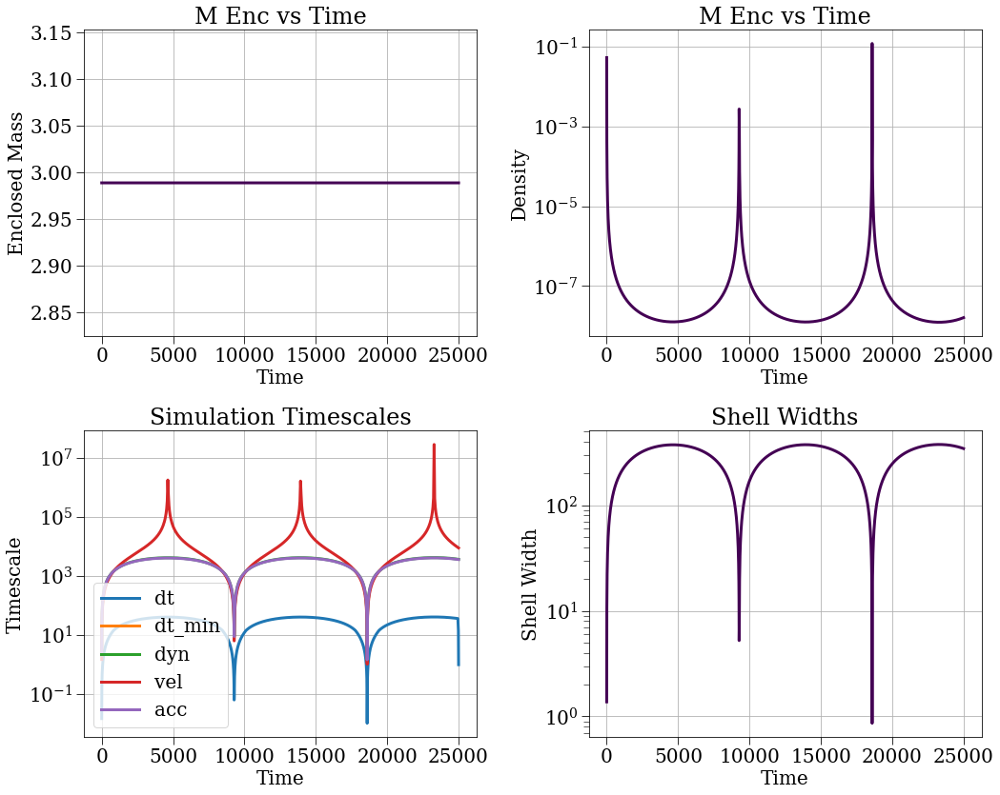

In [16]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-8.h5', show_progress=False)
sc, results, plotter = run_sc(config, profile=True, plot=True)

2025-07-17 02:39:43,192 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.001,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 2.373227743697057,
 'r_max': 2.373227743697057,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-8.h5',
 'save_strategy': 'vflip',
 'shell_density_strate

2025-07-17 02:39:44,426 - DEBUG - Saved dataset t with shape (1026,)
2025-07-17 02:39:44,429 - DEBUG - Saved dataset dt with shape (1026,)
2025-07-17 02:39:44,432 - DEBUG - Saved dataset r with shape (1026, 1)
2025-07-17 02:39:44,436 - DEBUG - Saved dataset v with shape (1026, 1)
2025-07-17 02:39:44,439 - DEBUG - Saved dataset a with shape (1026, 1)
2025-07-17 02:39:44,442 - DEBUG - Saved dataset m_enc with shape (1026, 1)
2025-07-17 02:39:44,445 - DEBUG - Saved dataset rho_r with shape (1026, 1)
2025-07-17 02:39:44,447 - WARNING - Skipping pressure because all values are None
2025-07-17 02:39:44,448 - WARNING - Skipping dpressure_drho because all values are None
2025-07-17 02:39:44,450 - WARNING - Skipping rho_prime because all values are None
2025-07-17 02:39:44,453 - DEBUG - Saved dataset e_tot with shape (1026, 1)
2025-07-17 02:39:44,456 - DEBUG - Saved dataset e_g with shape (1026, 1)
2025-07-17 02:39:44,459 - DEBUG - Saved dataset e_k with shape (1026, 1)
2025-07-17 02:39:44,463 

         867763 function calls (867653 primitive calls) in 1.338 seconds

   Ordered by: cumulative time
   List reduced from 198 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.011    0.011    1.338    1.338 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
     9620    0.043    0.000    1.118    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
     9620    0.030    0.000    0.730    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
    19240    0.171    0.000    0.440    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
    19240    0.111    0.000    0.379    0.000 /home/jsipple/one_d_spherical_collapse/one

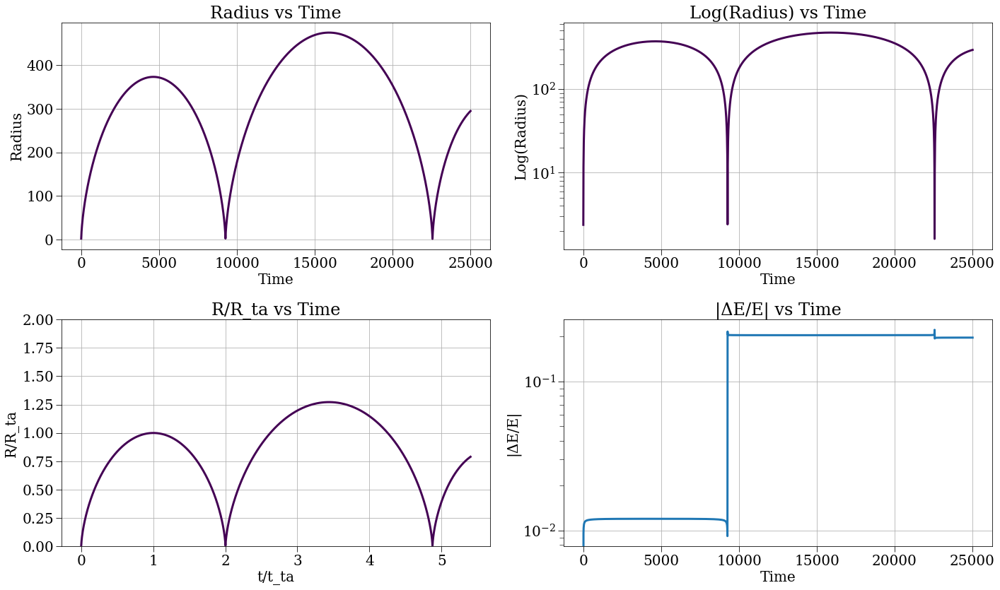

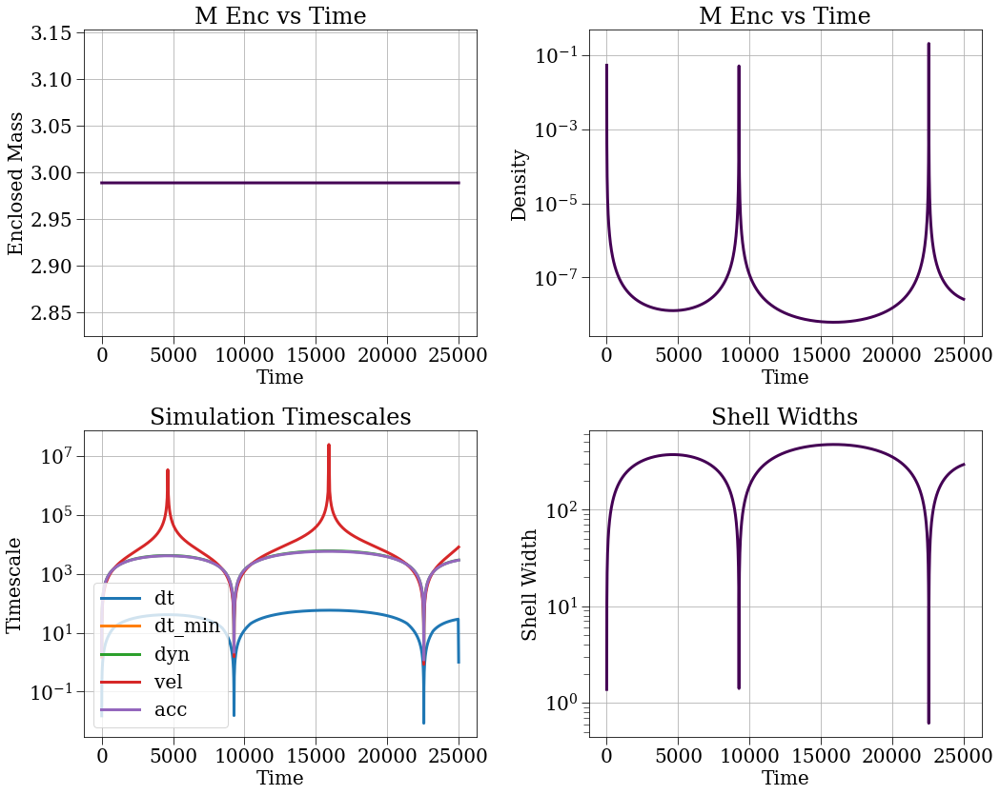

In [14]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-8.h5', show_progress=False)
sc, results, plotter = run_sc(config, profile=True, plot=True)

2025-07-16 23:29:52,285 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 10,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.4,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 10,
 'save_filename': 'runs/716-7.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell

2025-07-16 23:41:31,989 - DEBUG - Saved dataset t with shape (2501,)
2025-07-16 23:41:31,991 - DEBUG - Saved dataset dt with shape (2501,)
2025-07-16 23:41:31,997 - DEBUG - Saved dataset r with shape (2501, 10)
2025-07-16 23:41:32,002 - DEBUG - Saved dataset v with shape (2501, 10)
2025-07-16 23:41:32,006 - DEBUG - Saved dataset a with shape (2501, 10)
2025-07-16 23:41:32,009 - DEBUG - Saved dataset m_enc with shape (2501, 10)
2025-07-16 23:41:32,013 - DEBUG - Saved dataset rho_r with shape (2501, 10)
2025-07-16 23:41:32,014 - WARNING - Skipping pressure because all values are None
2025-07-16 23:41:32,015 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 23:41:32,015 - WARNING - Skipping rho_prime because all values are None
2025-07-16 23:41:32,020 - DEBUG - Saved dataset e_tot with shape (2501, 10)
2025-07-16 23:41:32,025 - DEBUG - Saved dataset e_g with shape (2501, 10)
2025-07-16 23:41:32,029 - DEBUG - Saved dataset e_k with shape (2501, 10)


2025-07-16 23:41:32,034 - DEBUG - Saved dataset e_r with shape (2501, 10)
2025-07-16 23:41:32,035 - WARNING - Skipping e_p because all values are None
2025-07-16 23:41:32,036 - WARNING - Skipping e_q because all values are None
2025-07-16 23:41:32,037 - DEBUG - Saved dataset t_dyn with shape (2501,)
2025-07-16 23:41:32,039 - DEBUG - Saved dataset t_vel with shape (2501,)
2025-07-16 23:41:32,040 - DEBUG - Saved dataset t_acc with shape (2501,)
2025-07-16 23:41:32,041 - WARNING - Skipping t_cross because all values are None
2025-07-16 23:41:32,042 - WARNING - Skipping t_crossa because all values are None
2025-07-16 23:41:32,043 - WARNING - Skipping t_cross2 because all values are None
2025-07-16 23:41:32,044 - WARNING - Skipping t_zero because all values are None
2025-07-16 23:41:32,044 - WARNING - Skipping t_rmin because all values are None
2025-07-16 23:41:32,045 - WARNING - Skipping t_rmina because all values are None
2025-07-16 23:41:32,046 - WARNING - Skipping t_ref because all valu

         499144 function calls (493371 primitive calls) in 699.826 seconds

   Ordered by: cumulative time
   List reduced from 365 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.026    0.026  699.826  699.826 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
      828  698.963    0.844  698.977    0.844 /home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/tqdm/std.py:1320(set_postfix)
     5172    0.024    0.000    0.714    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
     5172    0.018    0.000    0.490    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
    10344    0.106    0.000    0.304    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-ma

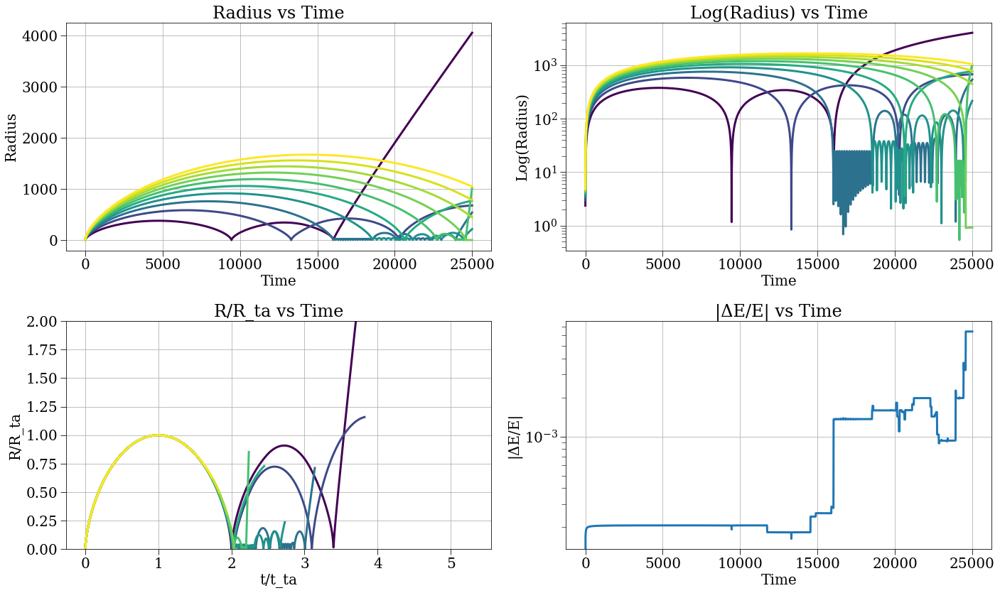

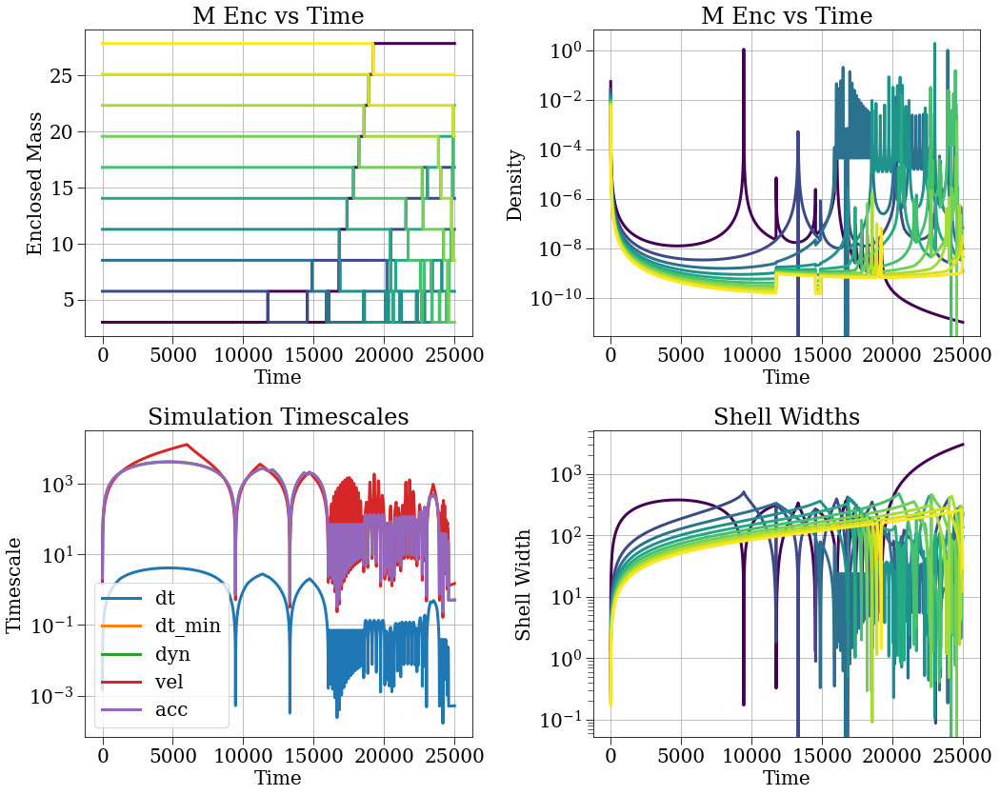

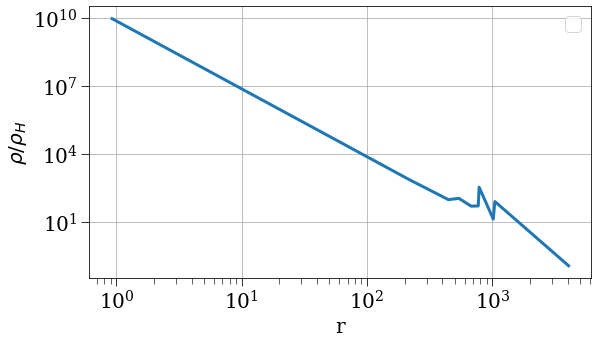

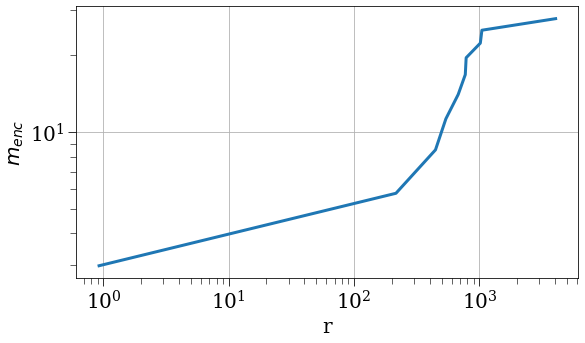

In [16]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-7.h5')
sc, results, plotter = run_sc(config, profile=True, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

In [12]:
params, snapshots = load_simulation_data('runs/716-6.h5')
print(params)
print(snapshots.keys())
rvals = snapshots['r']
print(rvals[0,0])
print(params['j_coef'])

{'G': 1, 'H': 0.6666666666666666, 'N': 10, 'accel_strategy': 'soft_grav', 'ang_mom_strategy': 'const', 'delta': 0.01, 'density_strategy': 'background_plus_power_law', 'deque_size': 0, 'drhodr_strategy': 'finite_diff', 'dt': 1e-05, 'dt_min': 1e-16, 'energy_strategy': 'kin_grav_rot', 'gamma': -1, 'hbar2_over_m2': 0, 'initial_mass_strategy': 'integrated_mass', 'initial_radius_strategy': 'equal_mass', 'initial_v_strategy': 'hubble', 'j_coef': 0.001, 'm_enc_strategy': 'inclusive', 'm_pert': 1, 'next_save_time': 0, 'num_crossing': 0, 'point_mass': 0, 'point_mass_strategy': 'rmin_rho_r', 'polytropic_coef': 0, 'polytropic_index': -1, 'pressure_strategy': 'zero', 'r0_min': 1.4, 'r_max': 5, 'r_min': 1, 'r_min_strategy': 'nothing', 'r_ta_strategy': 'r_ta_cycloid', 'relaxation_time': 0, 'rho_bar': 0.05305164769729845, 'safety_factor': 0.001, 'save_dt': 10, 'save_filename': 'runs/716-6.h5', 'save_strategy': 'vflip', 'shell_density_strategy': 'shell_density', 'shell_volume_strategy': 'inner_not_zero

2025-07-16 20:22:51,649 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 10,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.001,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.4,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 10,
 'save_filename': 'runs/716-6.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 '

2025-07-16 20:23:04,049 - DEBUG - Saved dataset t with shape (1501,)
2025-07-16 20:23:04,050 - DEBUG - Saved dataset dt with shape (1501,)
2025-07-16 20:23:04,055 - DEBUG - Saved dataset r with shape (1501, 10)
2025-07-16 20:23:04,057 - DEBUG - Saved dataset v with shape (1501, 10)
2025-07-16 20:23:04,060 - DEBUG - Saved dataset a with shape (1501, 10)
2025-07-16 20:23:04,062 - DEBUG - Saved dataset m_enc with shape (1501, 10)
2025-07-16 20:23:04,064 - DEBUG - Saved dataset rho_r with shape (1501, 10)
2025-07-16 20:23:04,065 - WARNING - Skipping pressure because all values are None
2025-07-16 20:23:04,066 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 20:23:04,067 - WARNING - Skipping rho_prime because all values are None
2025-07-16 20:23:04,070 - DEBUG - Saved dataset e_tot with shape (1501, 10)
2025-07-16 20:23:04,072 - DEBUG - Saved dataset e_g with shape (1501, 10)
2025-07-16 20:23:04,074 - DEBUG - Saved dataset e_k with shape (1501, 10)
2025-07-16 20:23


         8015205 function calls (8009232 primitive calls) in 12.486 seconds

   Ordered by: cumulative time
   List reduced from 487 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.257    0.257   12.486   12.486 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
    94346    0.430    0.000   11.047    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
    94346    0.317    0.000    7.109    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
   188692    1.620    0.000    4.274    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
   188692    1.100    0.000    3.884    0.000 /home/jsipple/one_d_spherical_collapse

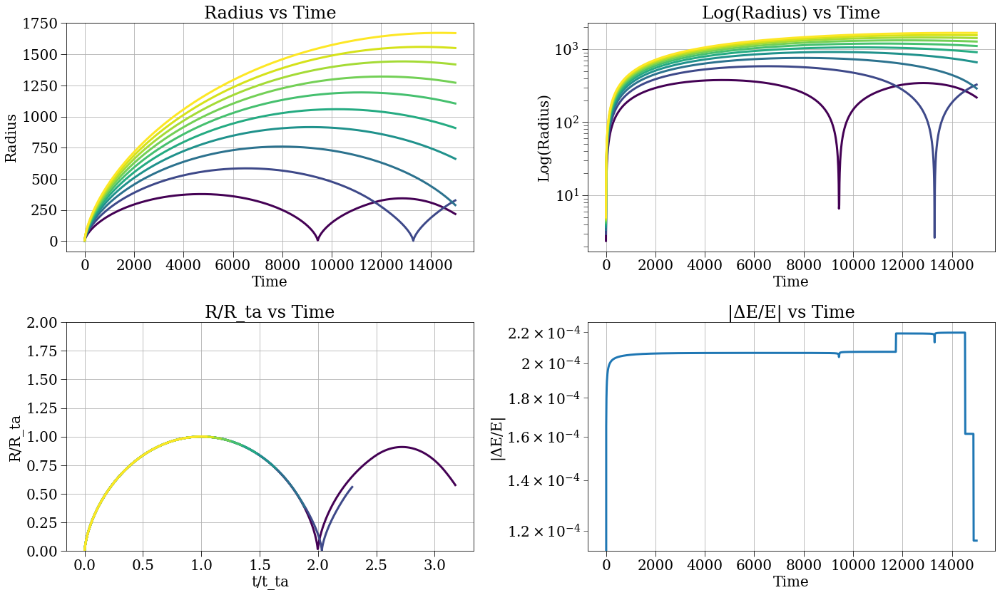

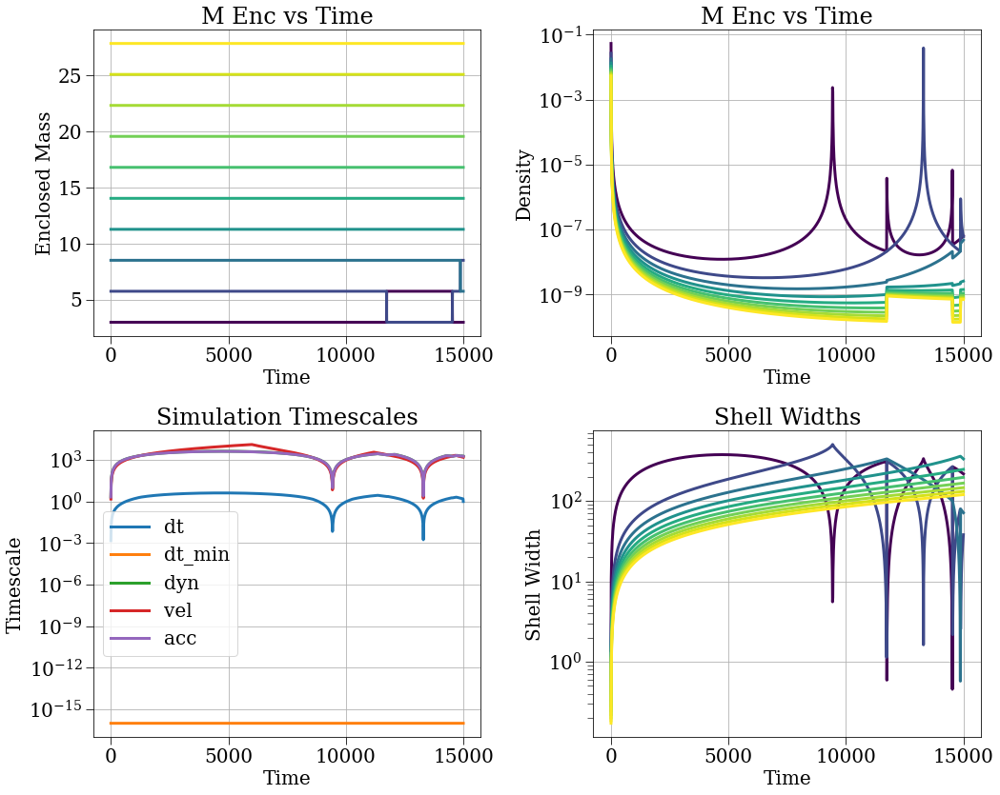

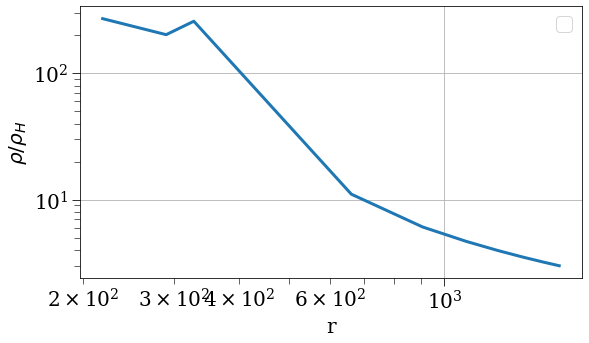

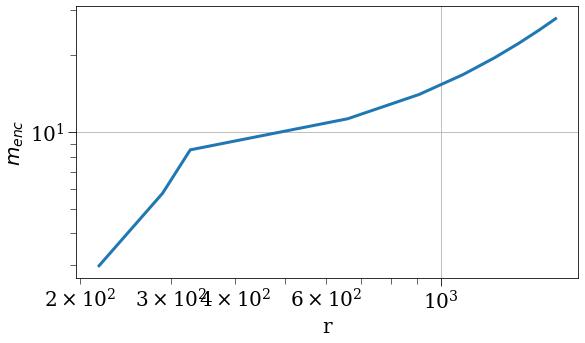

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-6.h5')
sc, results, plotter = run_sc(config, profile=True, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

2025-07-16 20:13:27,125 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 10,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.001,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.4,
 'r_max': 5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-5.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 's

2025-07-16 20:13:35,424 - DEBUG - Saved dataset t with shape (1809,)
2025-07-16 20:13:35,426 - DEBUG - Saved dataset dt with shape (1809,)
2025-07-16 20:13:35,432 - DEBUG - Saved dataset r with shape (1809, 10)
2025-07-16 20:13:35,435 - DEBUG - Saved dataset v with shape (1809, 10)
2025-07-16 20:13:35,438 - DEBUG - Saved dataset a with shape (1809, 10)
2025-07-16 20:13:35,441 - DEBUG - Saved dataset m_enc with shape (1809, 10)
2025-07-16 20:13:35,444 - DEBUG - Saved dataset rho_r with shape (1809, 10)
2025-07-16 20:13:35,445 - WARNING - Skipping pressure because all values are None
2025-07-16 20:13:35,446 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 20:13:35,447 - WARNING - Skipping rho_prime because all values are None
2025-07-16 20:13:35,451 - DEBUG - Saved dataset e_tot with shape (1809, 10)
2025-07-16 20:13:35,453 - DEBUG - Saved dataset e_g with shape (1809, 10)
2025-07-16 20:13:35,456 - DEBUG - Saved dataset e_k with shape (1809, 10)
2025-07-16 20:13


         5163771 function calls (5157792 primitive calls) in 8.421 seconds

   Ordered by: cumulative time
   List reduced from 487 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.167    0.167    8.421    8.421 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
    59769    0.270    0.000    7.376    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
    59769    0.201    0.000    4.733    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
   119538    1.070    0.000    2.876    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
   119538    0.716    0.000    2.505    0.000 /home/jsipple/one_d_spherical_collapse/

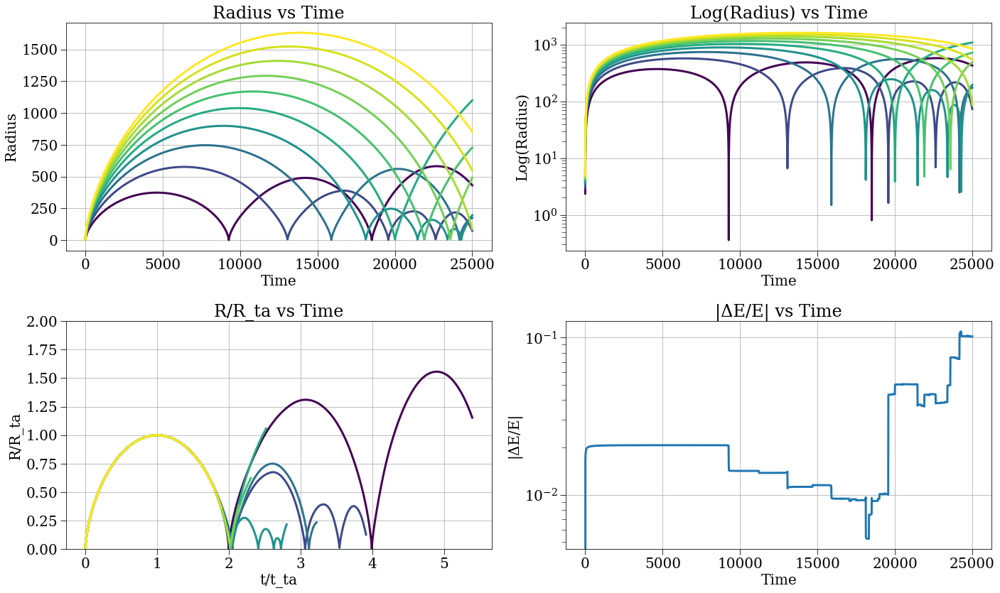

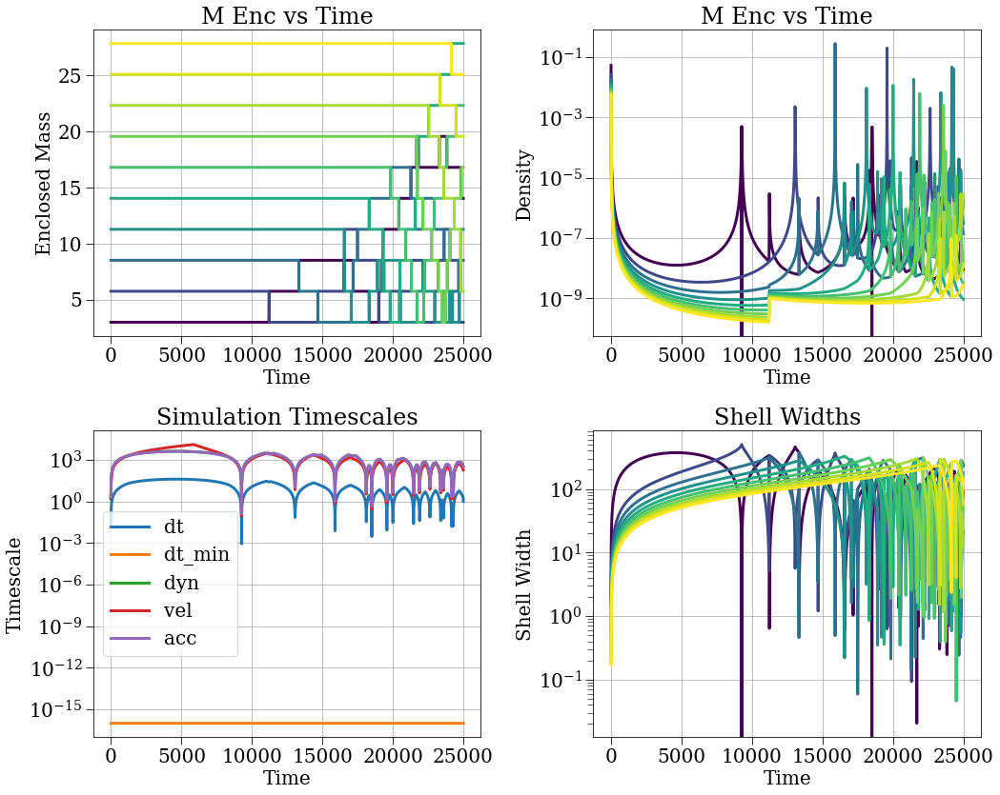

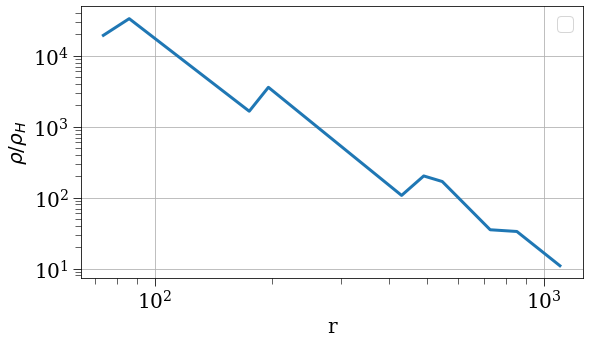

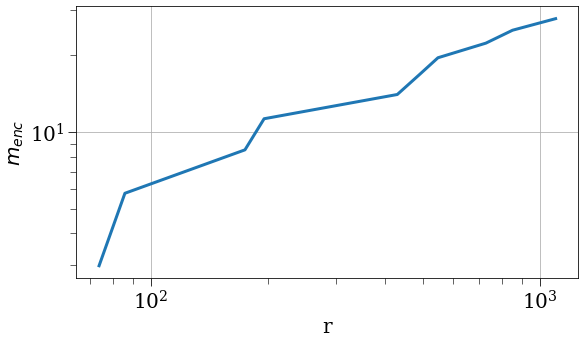

In [68]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-5.h5')
sc, results, plotter = run_sc(config, profile=True, plot=True)

idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
#plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.002,
 'r_max': 3,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-4.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',


2025-07-16 18:01:26,403 - collapse - INFO - Simulation setup complete


2025-07-16 19:46:53,316 - DEBUG - Saved dataset t with shape (488,)
2025-07-16 19:46:53,318 - DEBUG - Saved dataset dt with shape (488,)
2025-07-16 19:46:53,346 - DEBUG - Saved dataset r with shape (488, 1000)
2025-07-16 19:46:53,356 - DEBUG - Saved dataset v with shape (488, 1000)
2025-07-16 19:46:53,375 - DEBUG - Saved dataset a with shape (488, 1000)
2025-07-16 19:46:53,395 - DEBUG - Saved dataset m_enc with shape (488, 1000)
2025-07-16 19:46:53,413 - DEBUG - Saved dataset rho_r with shape (488, 1000)
2025-07-16 19:46:53,415 - WARNING - Skipping pressure because all values are None
2025-07-16 19:46:53,416 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 19:46:53,417 - WARNING - Skipping rho_prime because all values are None
2025-07-16 19:46:53,430 - DEBUG - Saved dataset e_tot with shape (488, 1000)
2025-07-16 19:46:53,448 - DEBUG - Saved dataset e_g with shape (488, 1000)
2025-07-16 19:46:53,464 - DEBUG - Saved dataset e_k with shape (488, 1000)


2025-07-16 19:46:53,481 - DEBUG - Saved dataset e_r with shape (488, 1000)
2025-07-16 19:46:53,482 - WARNING - Skipping e_p because all values are None
2025-07-16 19:46:53,483 - WARNING - Skipping e_q because all values are None
2025-07-16 19:46:53,484 - DEBUG - Saved dataset t_dyn with shape (488,)
2025-07-16 19:46:53,495 - DEBUG - Saved dataset t_vel with shape (488,)
2025-07-16 19:46:53,497 - DEBUG - Saved dataset t_acc with shape (488,)
2025-07-16 19:46:53,498 - WARNING - Skipping t_cross because all values are None
2025-07-16 19:46:53,499 - WARNING - Skipping t_crossa because all values are None
2025-07-16 19:46:53,499 - WARNING - Skipping t_cross2 because all values are None
2025-07-16 19:46:53,500 - WARNING - Skipping t_zero because all values are None
2025-07-16 19:46:53,501 - WARNING - Skipping t_rmin because all values are None
2025-07-16 19:46:53,502 - WARNING - Skipping t_rmina because all values are None
2025-07-16 19:46:53,503 - WARNING - Skipping t_ref because all values

         972274222 function calls (972261451 primitive calls) in 6327.177 seconds

   Ordered by: cumulative time
   List reduced from 487 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1   21.255   21.255 6327.177 6327.177 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
 12290435   73.858    0.000 6199.915    0.001 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
 12290435   90.609    0.000 2723.633    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:493(__call__)
 12290435   27.871    0.000 2633.024    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:468(__call__)
 12290435 2605.154    0.000 2605.154    0.000 /home/jsipple/one_d_spherical_collaps

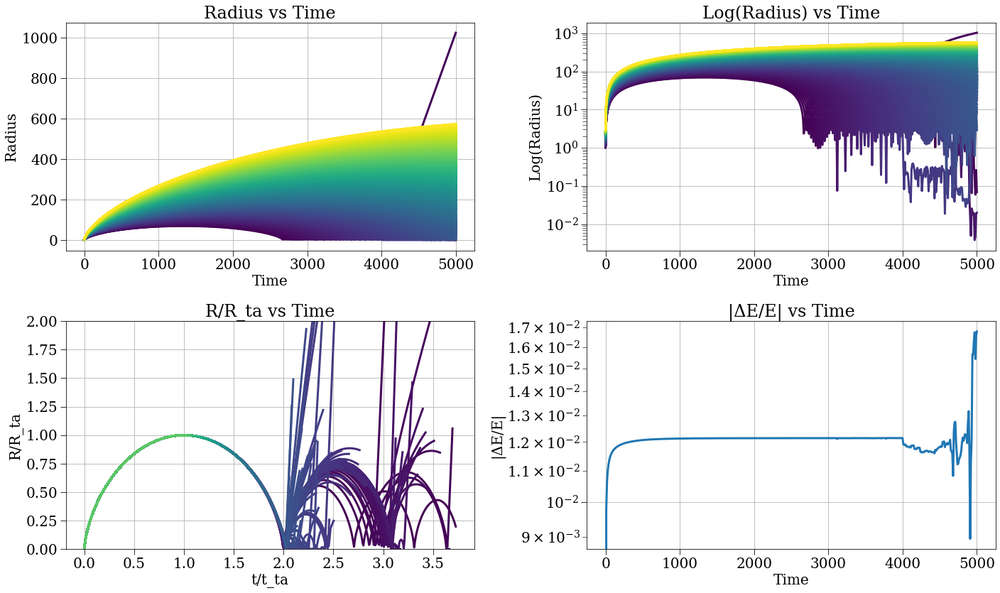

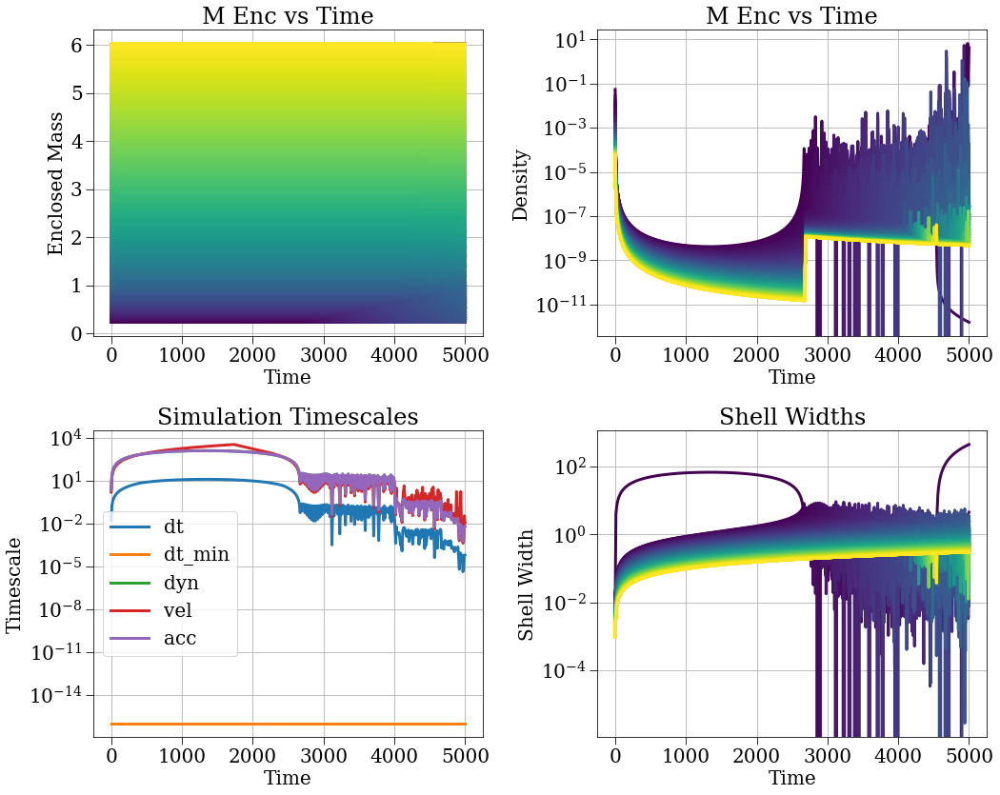

In [17]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-4.h5')
sc, results, plotter = run_sc(config, profile=True, plot=True)

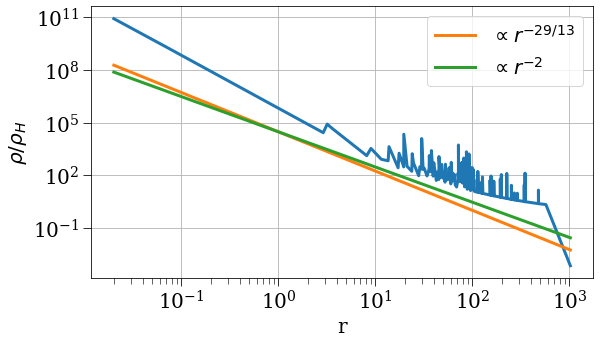

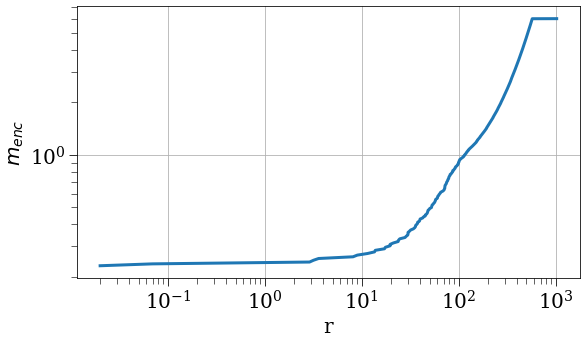

In [18]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.02,
 'r_max': 3,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-3.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 '

2025-07-16 17:34:29,013 - collapse - INFO - Simulation setup complete


2025-07-16 17:35:10,368 - DEBUG - Saved dataset t with shape (776,)
2025-07-16 17:35:10,370 - DEBUG - Saved dataset dt with shape (776,)
2025-07-16 17:35:10,378 - DEBUG - Saved dataset r with shape (776, 100)
2025-07-16 17:35:10,382 - DEBUG - Saved dataset v with shape (776, 100)
2025-07-16 17:35:10,386 - DEBUG - Saved dataset a with shape (776, 100)
2025-07-16 17:35:10,390 - DEBUG - Saved dataset m_enc with shape (776, 100)
2025-07-16 17:35:10,395 - DEBUG - Saved dataset rho_r with shape (776, 100)
2025-07-16 17:35:10,396 - WARNING - Skipping pressure because all values are None
2025-07-16 17:35:10,397 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 17:35:10,398 - WARNING - Skipping rho_prime because all values are None
2025-07-16 17:35:10,402 - DEBUG - Saved dataset e_tot with shape (776, 100)
2025-07-16 17:35:10,406 - DEBUG - Saved dataset e_g with shape (776, 100)
2025-07-16 17:35:10,410 - DEBUG - Saved dataset e_k with shape (776, 100)
2025-07-16 17:35:1


         22641690 function calls (22635507 primitive calls) in 41.459 seconds

   Ordered by: cumulative time
   List reduced from 487 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.550    0.550   41.459   41.459 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
   280315    1.275    0.000   38.279    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
   280315    0.959    0.000   23.882    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
   560630    4.948    0.000   14.624    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
   560630    3.262    0.000   13.086    0.000 /home/jsipple/one_d_spherical_collap

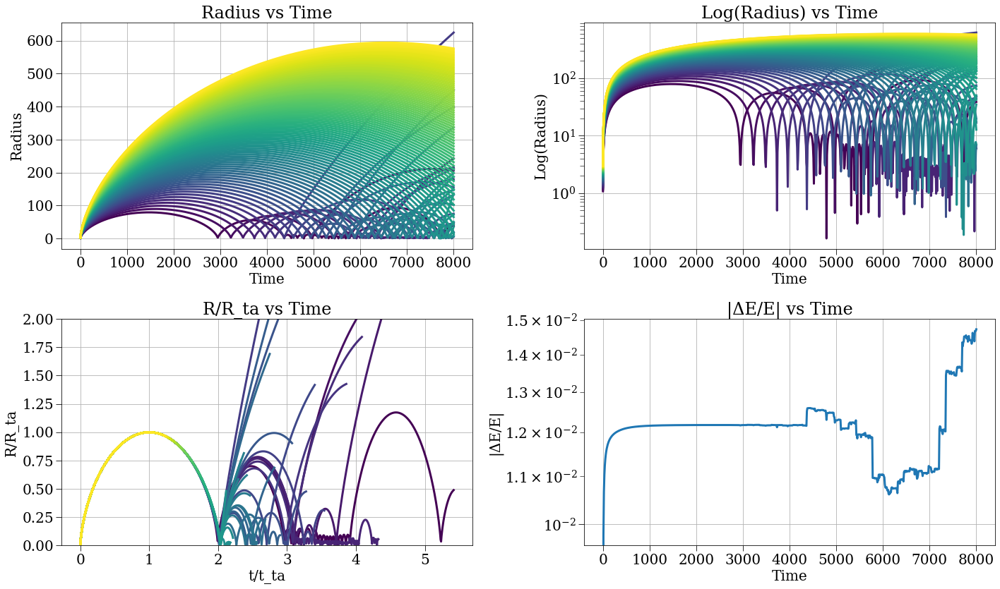

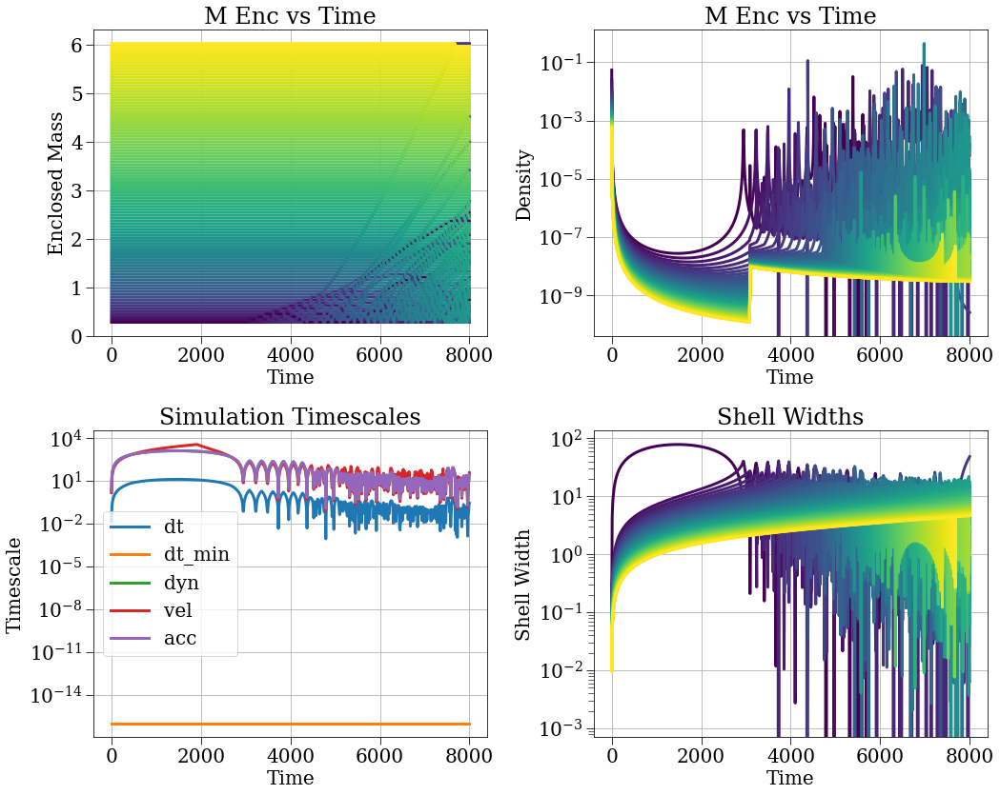

In [15]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-3.h5')
sc, results, plotter = run_sc(config, profile=True, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/716-2.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density

2025-07-16 17:02:48,971 - collapse - INFO - Simulation setup complete


2025-07-16 17:14:57,029 - DEBUG - Saved dataset t with shape (490,)
2025-07-16 17:14:57,031 - DEBUG - Saved dataset dt with shape (490,)
2025-07-16 17:14:57,055 - DEBUG - Saved dataset r with shape (490, 1000)
2025-07-16 17:14:57,063 - DEBUG - Saved dataset v with shape (490, 1000)
2025-07-16 17:14:57,082 - DEBUG - Saved dataset a with shape (490, 1000)
2025-07-16 17:14:57,098 - DEBUG - Saved dataset m_enc with shape (490, 1000)
2025-07-16 17:14:57,113 - DEBUG - Saved dataset rho_r with shape (490, 1000)
2025-07-16 17:14:57,115 - WARNING - Skipping pressure because all values are None
2025-07-16 17:14:57,115 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 17:14:57,116 - WARNING - Skipping rho_prime because all values are None
2025-07-16 17:14:57,129 - DEBUG - Saved dataset e_tot with shape (490, 1000)
2025-07-16 17:14:57,145 - DEBUG - Saved dataset e_g with shape (490, 1000)
2025-07-16 17:14:57,160 - DEBUG - Saved dataset e_k with shape (490, 1000)
2025-07-16

2025-07-16 17:14:57,197 - WARNING - Skipping t_j because all values are None
2025-07-16 17:14:57,198 - WARNING - Skipping t_jeans because all values are None
2025-07-16 17:14:57,200 - DEBUG - Saved dataset num_crossing with shape (490,)
2025-07-16 17:14:57,224 - DEBUG - Saved dataset m with shape (490, 1000)
2025-07-16 17:14:57,227 - DEBUG - Saved dataset deque with shape (490, 0)
2025-07-16 17:14:57,233 - INFO - Saved simulation data and parameters to runs/716-2.h5


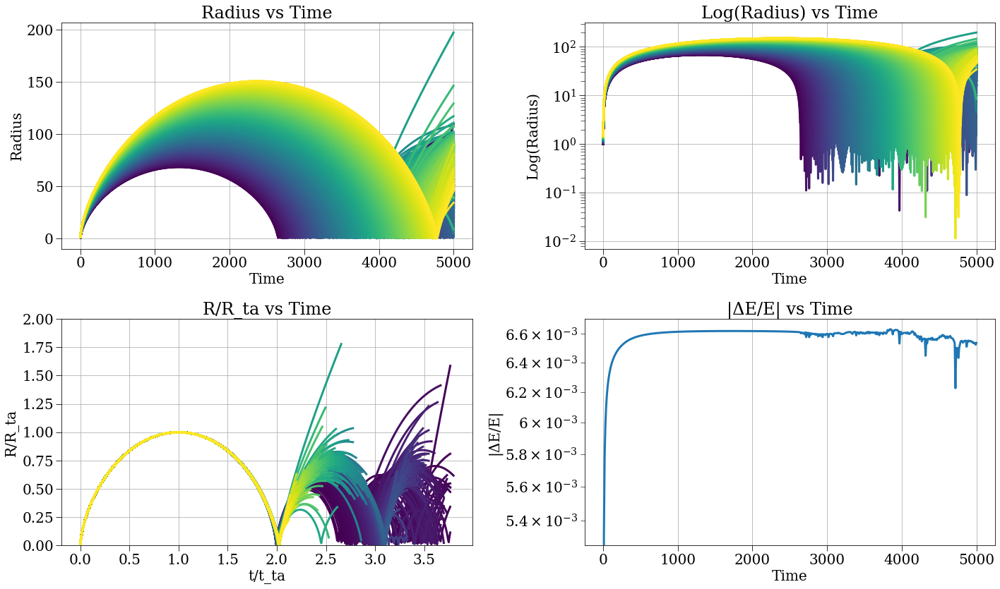

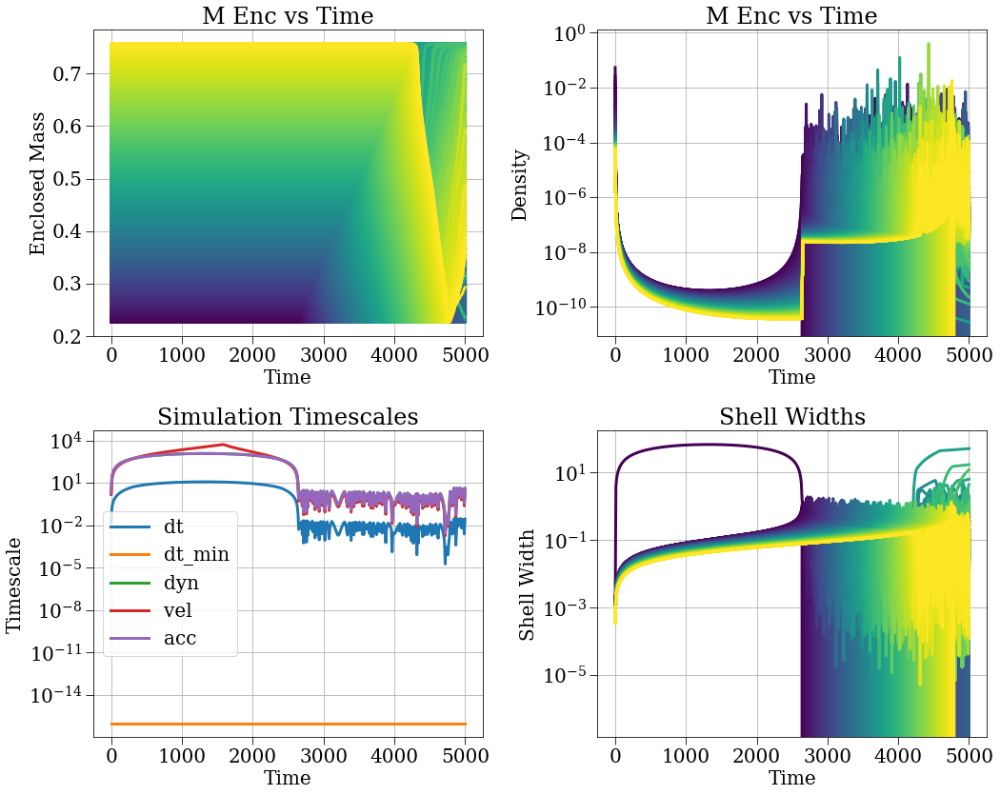

In [21]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-2.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [ ]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -2.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.01,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 0.001,
 'save_filename': 'runs/716-1.h5',
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density

2025-07-16 02:16:27,328 - collapse - INFO - Simulation setup complete


2025-07-16 02:42:38,412 - DEBUG - Saved dataset t with shape (426641,)
2025-07-16 02:42:38,470 - DEBUG - Saved dataset dt with shape (426641,)
2025-07-16 02:42:39,617 - DEBUG - Saved dataset r with shape (426641, 100)
2025-07-16 02:42:40,476 - DEBUG - Saved dataset v with shape (426641, 100)
2025-07-16 02:42:41,392 - DEBUG - Saved dataset a with shape (426641, 100)
2025-07-16 02:42:42,418 - DEBUG - Saved dataset m_enc with shape (426641, 100)
2025-07-16 02:42:43,524 - DEBUG - Saved dataset rho_r with shape (426641, 100)
2025-07-16 02:42:43,549 - WARNING - Skipping pressure because all values are None
2025-07-16 02:42:43,574 - WARNING - Skipping dpressure_drho because all values are None
2025-07-16 02:42:43,599 - WARNING - Skipping rho_prime because all values are None
2025-07-16 02:42:44,646 - DEBUG - Saved dataset e_tot with shape (426641, 100)
2025-07-16 02:42:45,811 - DEBUG - Saved dataset e_g with shape (426641, 100)
2025-07-16 02:42:46,991 - DEBUG - Saved dataset e_k with shape (4

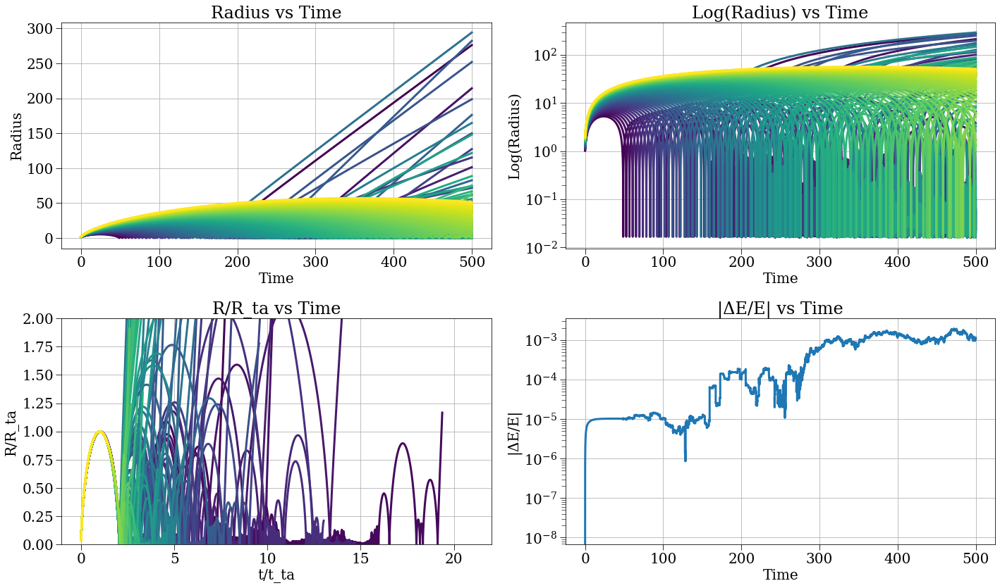

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:575: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


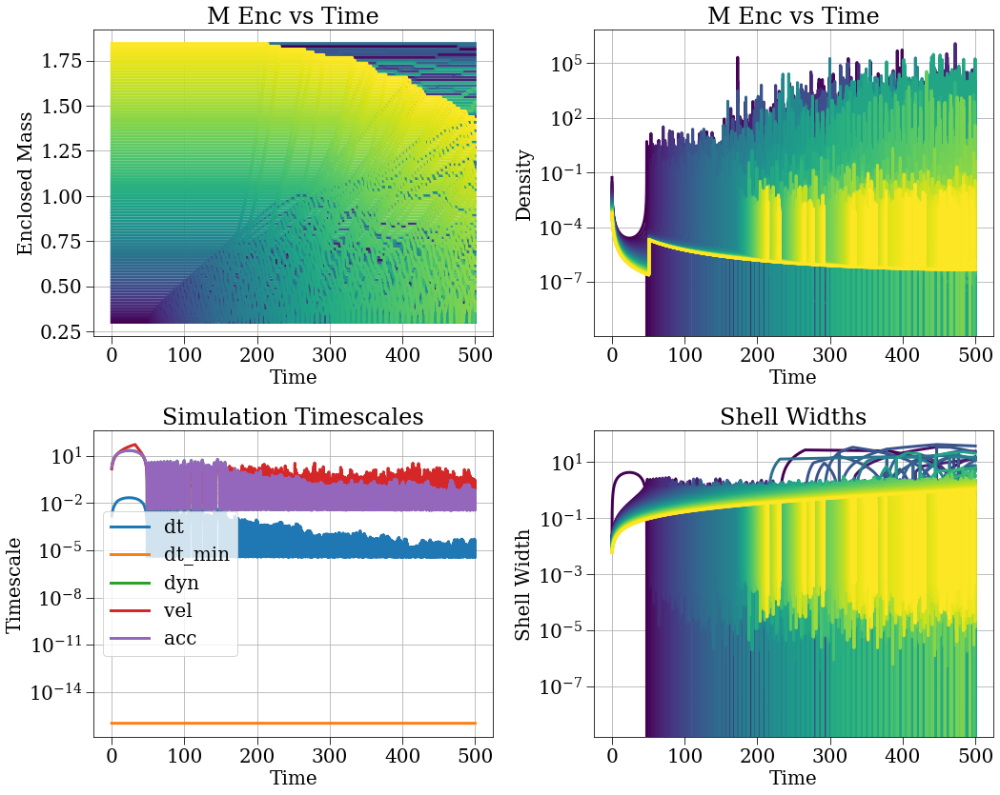

In [74]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/716-1.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

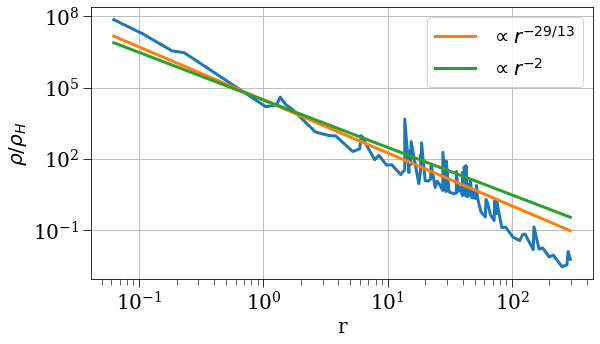

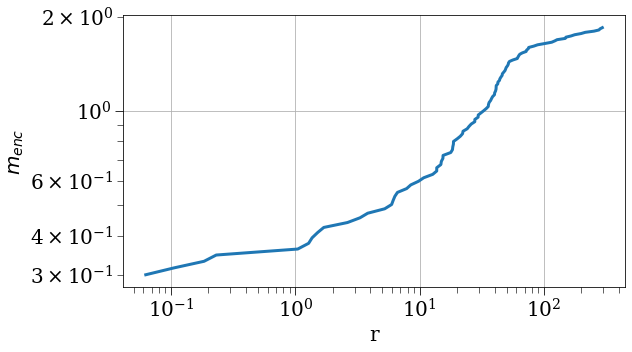

In [78]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
pivot, pivot_val = 1e0, 3e4
plt.plot(rvals, pivot_val*(rvals/pivot)**(-29/13), label=r'$\propto r^{-29/13}$')
plt.plot(rvals, pivot_val*(rvals/pivot)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 0.6*(rvals/1e1)**(10/13), label=r'$r^{10/13}$')
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.02,
 'r_max': 3,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inner_not_

2025-07-15 20:14:03,217 - collapse - INFO - Simulation setup complete


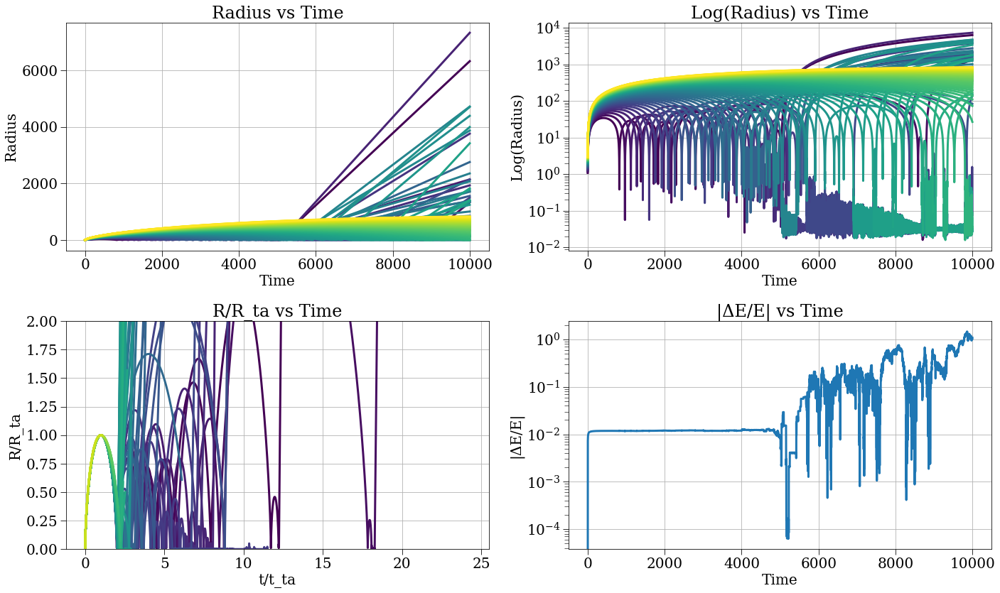

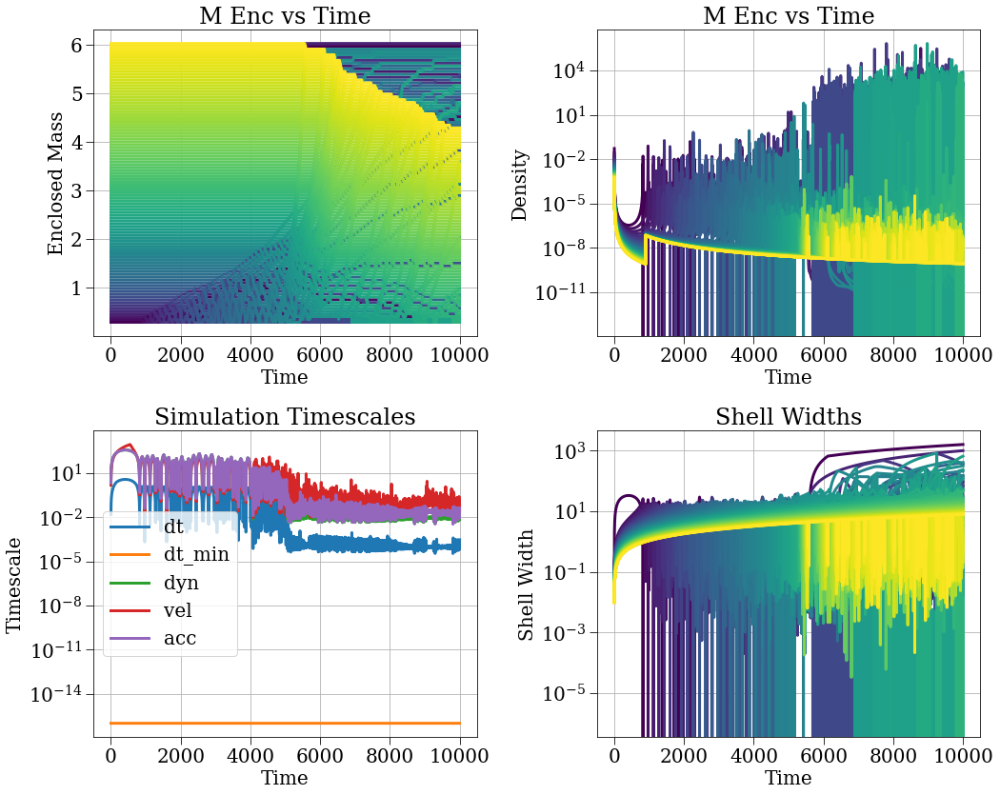

In [7]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inn

2025-07-15 19:05:51,735 - collapse - INFO - Simulation setup complete


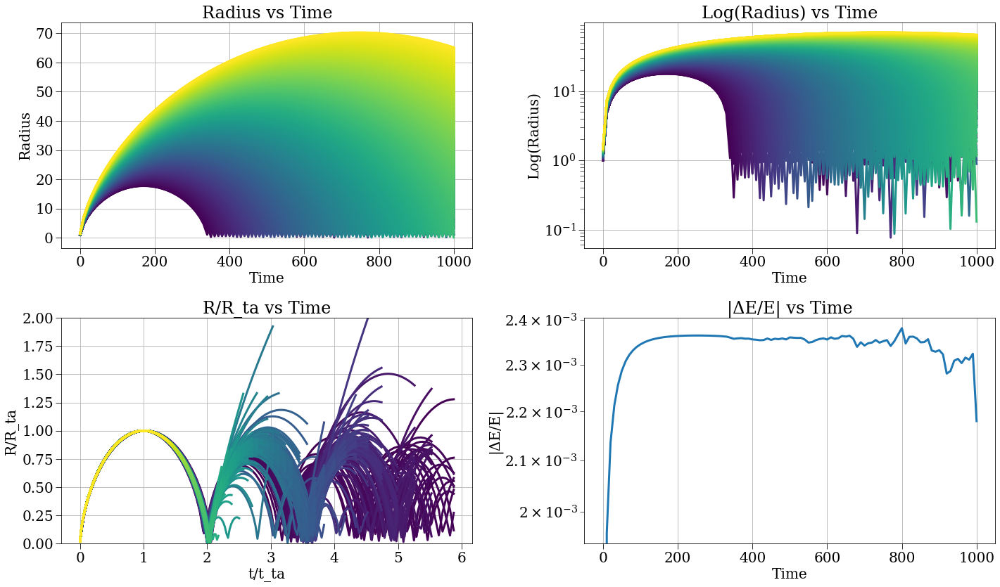

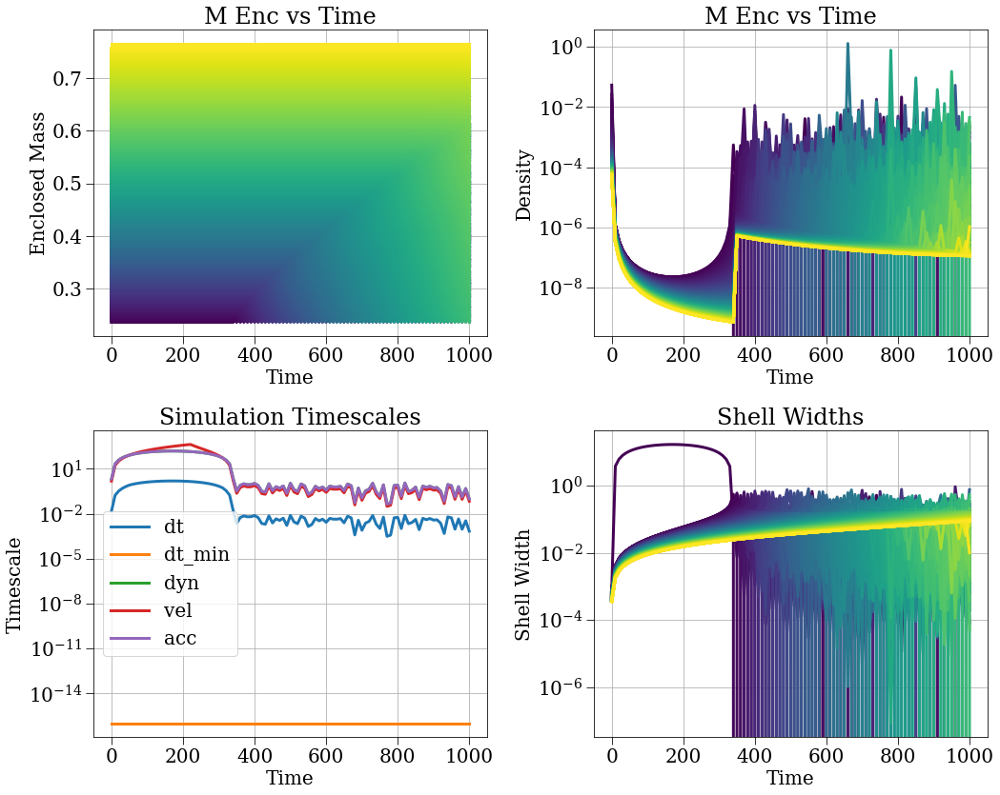

In [103]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.001,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 10.01,
 'r_max': 20,
 'r_min': 10,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 100,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inne

2025-07-15 17:12:54,246 - collapse - INFO - Simulation setup complete


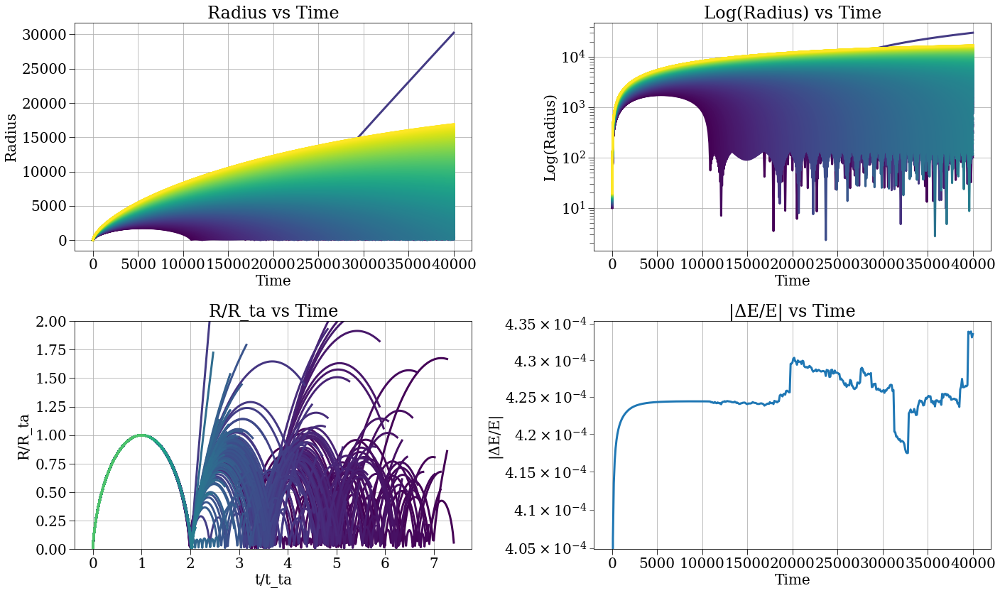

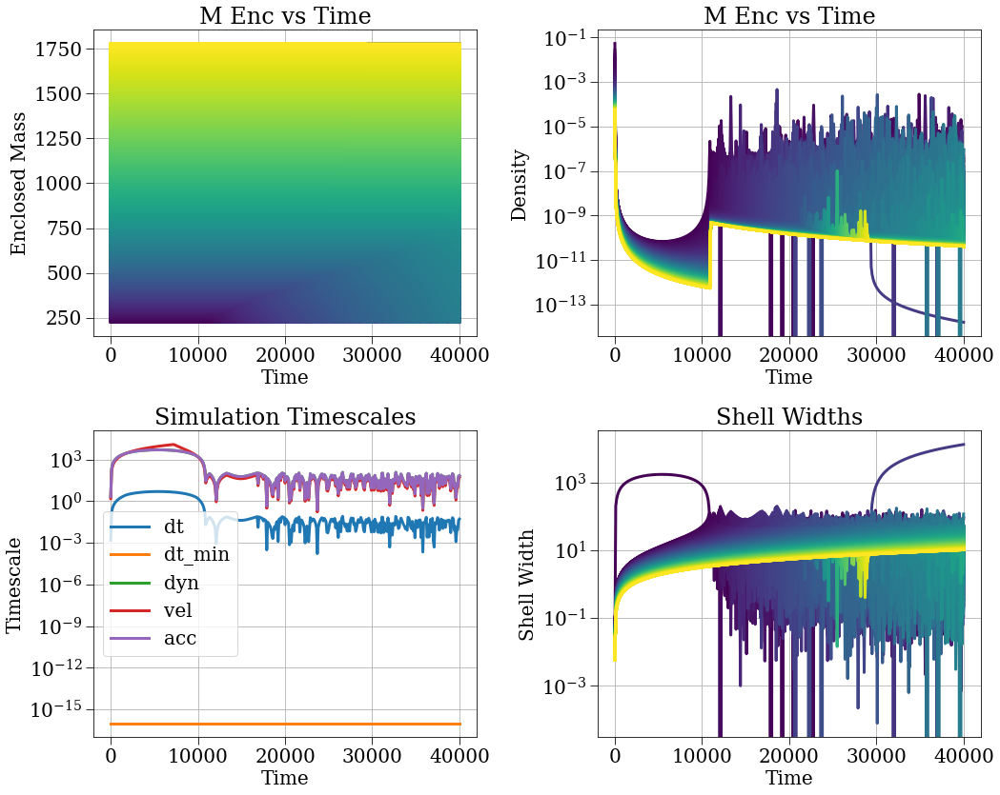

In [37]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.001,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 10.01,
 'r_max': 20,
 'r_min': 10,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 100,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inner_

2025-07-15 03:39:08,167 - collapse - INFO - Simulation setup complete


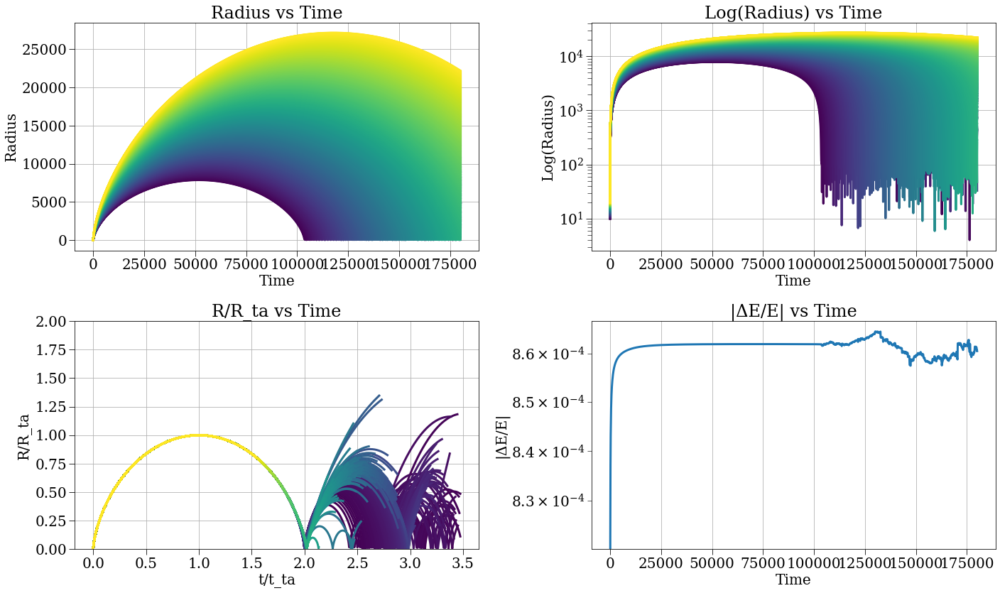

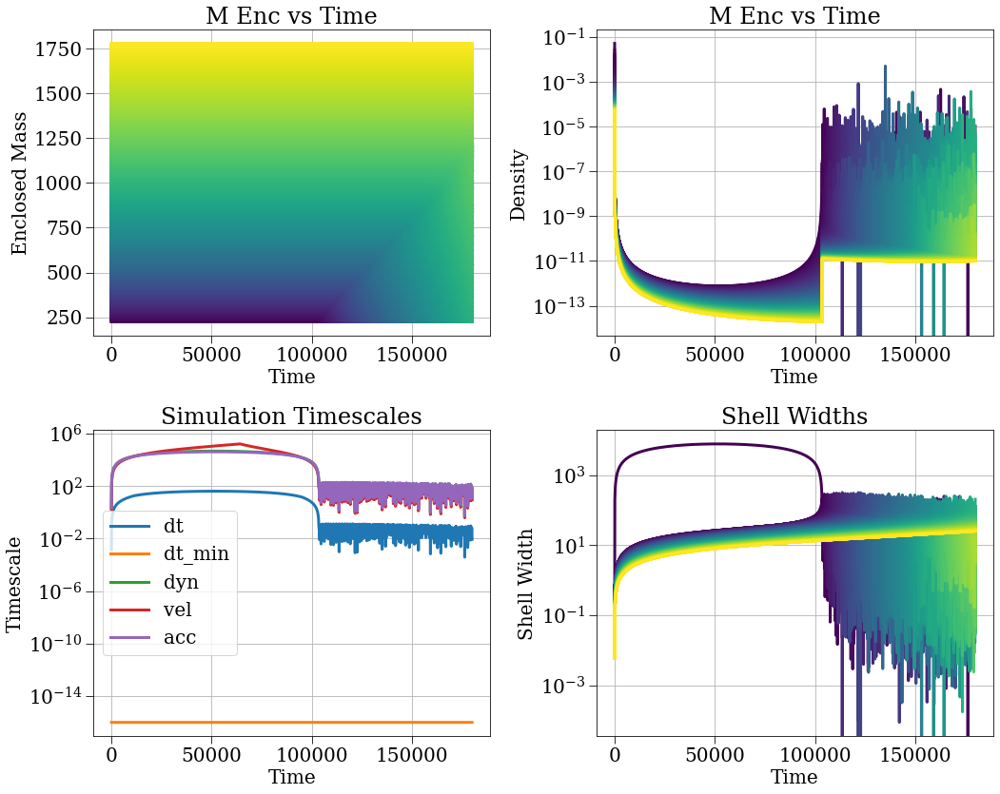

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.001,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 10.01,
 'r_max': 20,
 'r_min': 10,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 100,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inner_n

2025-07-15 02:37:55,925 - collapse - INFO - Simulation setup complete


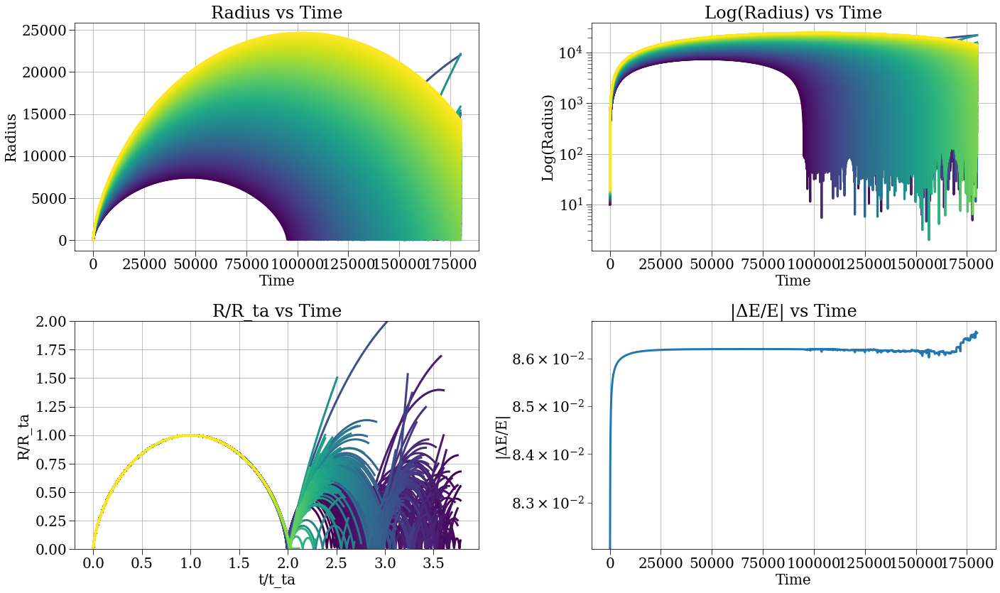

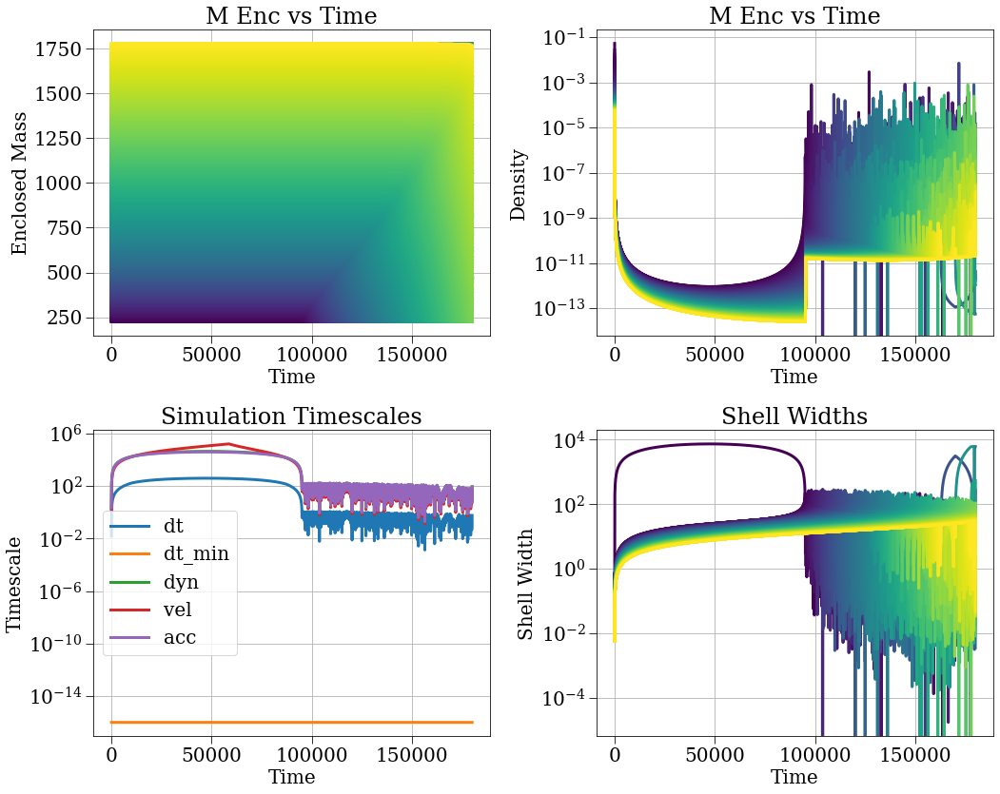

In [5]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [9]:
save_to_hdf5(sc, '~/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/notebooks/test_run_gamma_minus_2_5_1_3.h5')

2025-07-15 21:18:43,597 - DEBUG - Saved dataset t with shape (9562,)
2025-07-15 21:18:43,600 - DEBUG - Saved dataset dt with shape (9562,)
2025-07-15 21:18:43,623 - DEBUG - Saved dataset r with shape (9562, 100)
2025-07-15 21:18:43,653 - DEBUG - Saved dataset v with shape (9562, 100)
2025-07-15 21:18:43,680 - DEBUG - Saved dataset a with shape (9562, 100)
2025-07-15 21:18:43,709 - DEBUG - Saved dataset m_enc with shape (9562, 100)
2025-07-15 21:18:43,735 - DEBUG - Saved dataset rho_r with shape (9562, 100)
2025-07-15 21:18:43,737 - WARNING - Skipping pressure because all values are None
2025-07-15 21:18:43,738 - WARNING - Skipping dpressure_drho because all values are None
2025-07-15 21:18:43,739 - WARNING - Skipping rho_prime because all values are None
2025-07-15 21:18:43,762 - DEBUG - Saved dataset e_tot with shape (9562, 100)
2025-07-15 21:18:43,788 - DEBUG - Saved dataset e_g with shape (9562, 100)
2025-07-15 21:18:43,818 - DEBUG - Saved dataset e_k with shape (9562, 100)
2025-07-

In [15]:
[plt.plot(results['t'], results['r'][:,i], alpha=0.1) for i in range(results['r'].shape[1])]
plt.yscale('log')
plt.figure()

<Figure size 648x360 with 0 Axes>

: 

: 

: 

In [10]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config, profile=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.001,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 1e-16,
 'energy_strategy': 'kin_grav_rot',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'r0_min': 10.01,
 'r_max': 20,
 'r_min': 10,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_strategy': 'vflip',
 'shell_density_strategy': 'shell_density',
 'shell_volume_strategy': 'inner_not

2025-07-14 18:44:52,512 - collapse - INFO - Simulation setup complete



         1788821923 function calls (1788806328 primitive calls) in 11076.350 seconds

   Ordered by: cumulative time
   List reduced from 390 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1   43.151   43.151 11076.350 11076.350 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:258(run)
 22284626  154.276    0.000 10817.348    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:311(_update_simulation)
 22284626   93.357    0.000 6006.199    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:675(__call__)
 44569252  479.302    0.000 4609.525    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:688(_do_kdk_step)
 22284626  167.161    0.000 3008.393    0.000 /home/jsipple/one_d_spheri

: 

: 

: 

In [1]:
results.shape

NameError: name 'results' is not defined

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

2025-07-10 01:55:50,172 - collapse - INFO - Simulation setup complete


r=[10.00790875 10.01580502 10.02368887 10.03156035 10.03941949 10.04726636
 10.05510099 10.06292345 10.07073376 10.07853198 10.08631817 10.09409235
 10.10185459 10.10960491 10.11734339 10.12507004 10.13278493 10.14048809
 10.14817958 10.15585942 10.16352768 10.17118439 10.17882959 10.18646333
 10.19408565 10.2016966  10.20929621 10.21688453 10.2244616  10.23202747
 10.23958216 10.24712573 10.25465822 10.26217966 10.2696901  10.27718957
 10.28467812 10.29215579 10.29962261 10.30707862 10.31452387 10.32195839
 10.32938223 10.33679541 10.34419798 10.35158997 10.35897143 10.36634239
 10.37370288 10.38105295 10.38839264 10.39572197 10.40304098 10.41034972
 10.41764821 10.4249365  10.43221461 10.43948259 10.44674046 10.45398827
 10.46122605 10.46845384 10.47567166 10.48287955 10.49007755 10.49726569
 10.504444   10.51161252 10.51877128 10.52592031 10.53305966 10.54018934
 10.54730939 10.55441985 10.56152074 10.5686121  10.57569397 10.58276637
 10.58982933 10.59688288 10.60392707 10.61096191 

In [39]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_kdk',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs,)
sc, results, plotter = run_sc(config)

2025-07-09 14:32:47,088 - collapse - INFO - Simulation setup complete


r=[10.10910417 10.21591092 10.32053751 10.42309189 10.52367373 10.6223752
 10.71928182 10.81447302 10.90802275 11.        ], m=[7.40688889 7.40688889 7.40688889 7.40688889 7.40688889 7.40688889
 7.40688889 7.40688889 7.40688889 7.40688889], point_mass=224.6669985918533, m_enc=[232.07388748 239.48077637 246.88766526 254.29455415 261.70144304
 269.10833193 276.51522081 283.9221097  291.32899859 298.73588748]


KeyboardInterrupt: 

2025-07-09 16:47:15,387 - collapse - INFO - Simulation setup complete


r=[10.12527982 10.24753589 10.36694431 10.48366532 10.59784521 10.70961792
 10.81910646 10.92642406 11.03167523 11.13495667 11.23635802 11.33596258
 11.43384788 11.53008626 11.62474528 11.71788818 11.80957426 11.89985918
 11.98879526 12.0764318  12.16281524 12.24798943 12.33199585 12.41487369
 12.49666013 12.57739039 12.65709793 12.73581454 12.81357045 12.89039445
 12.96631397 13.04135517 13.11554302 13.18890138 13.26145304 13.33321984
 13.40422265 13.47448149 13.54401554 13.61284322 13.6809822  13.74844945
 13.81526127 13.88143338 13.94698085 14.01191823 14.07625951 14.14001819
 14.20320729 14.26583935 14.3279265  14.38948042 14.45051243 14.51103345
 14.57105404 14.63058443 14.68963449 14.7482138  14.80633163 14.86399698
 14.92121853 14.97800473 15.03436378 15.09030361 15.14583193 15.20095623
 15.25568378 15.31002164 15.36397668 15.41755556 15.47076478 15.52361064
 15.57609929 15.6282367  15.6800287  15.73148094 15.78259894 15.83338808
 15.8838536  15.9340006  15.98383406 16.03335884 

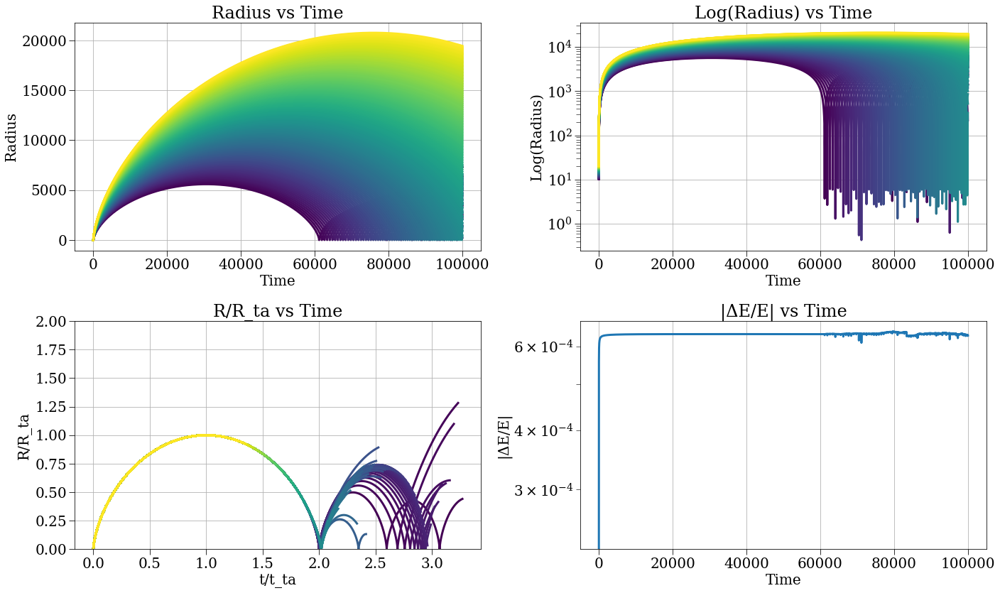

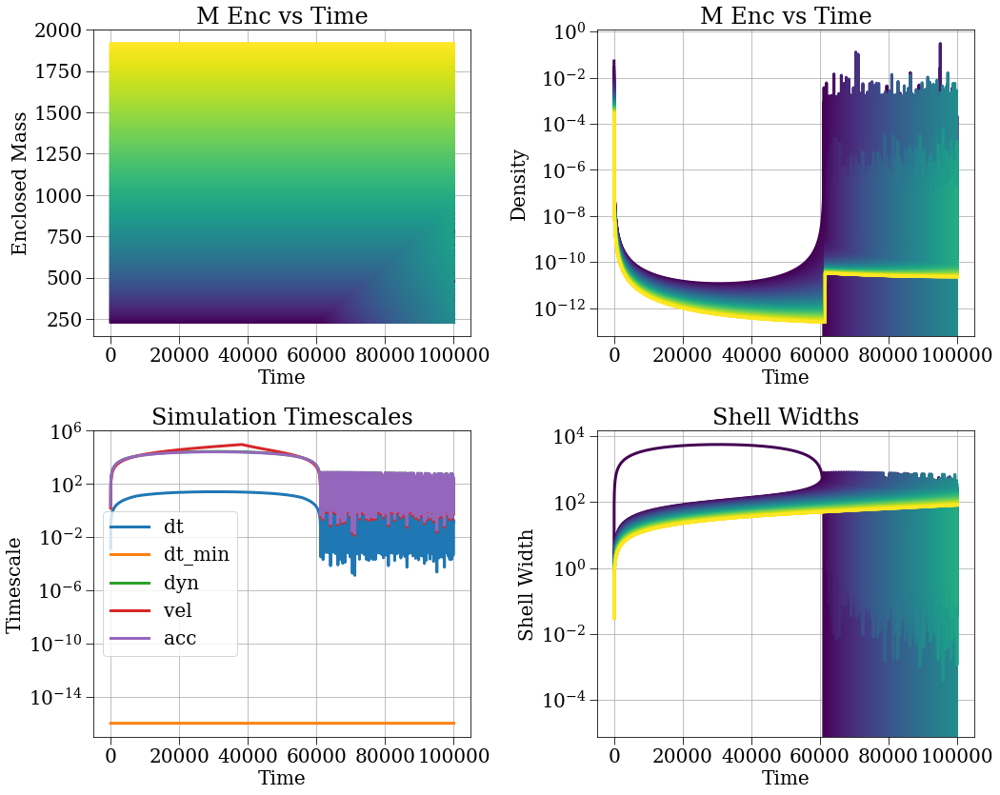

In [37]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

2025-07-09 16:23:09,929 - collapse - INFO - Simulation setup complete


r=[10.08583538 10.17023551 10.25325891 10.33496041 10.41539138 10.4946001
 10.57263197 10.64952976 10.72533379 10.80008215 10.87381084 10.94655393
 11.01834373 11.08921085 11.15918439 11.228292   11.29655998 11.36401337
 11.43067605 11.49657079 11.56171933 11.62614245 11.68986    11.752891
 11.81525365 11.87696538 11.93804292 11.99850231 12.05835897 12.11762768
 12.17632269 12.23445768 12.29204582 12.34909978 12.40563178 12.46165361
 12.51717662 12.57221176 12.62676962 12.6808604  12.73449399 12.78767991
 12.8404274  12.89274538 12.94464249 12.99612709 13.04720729 13.09789092
 13.14818561 13.19809872 13.24763742 13.29680864 13.34561913 13.39407543
 13.4421839  13.4899507  13.53738186 13.58448319 13.63126038 13.67771895
 13.72386426 13.76970154 13.81523588 13.86047224 13.90541545 13.95007021
 13.99444111 14.0385326  14.08234906 14.12589473 14.16917375 14.21219017
 14.25494794 14.29745091 14.33970284 14.38170741 14.42346821 14.46498873
 14.50627242 14.54732262 14.58814259 14.62873555 14.

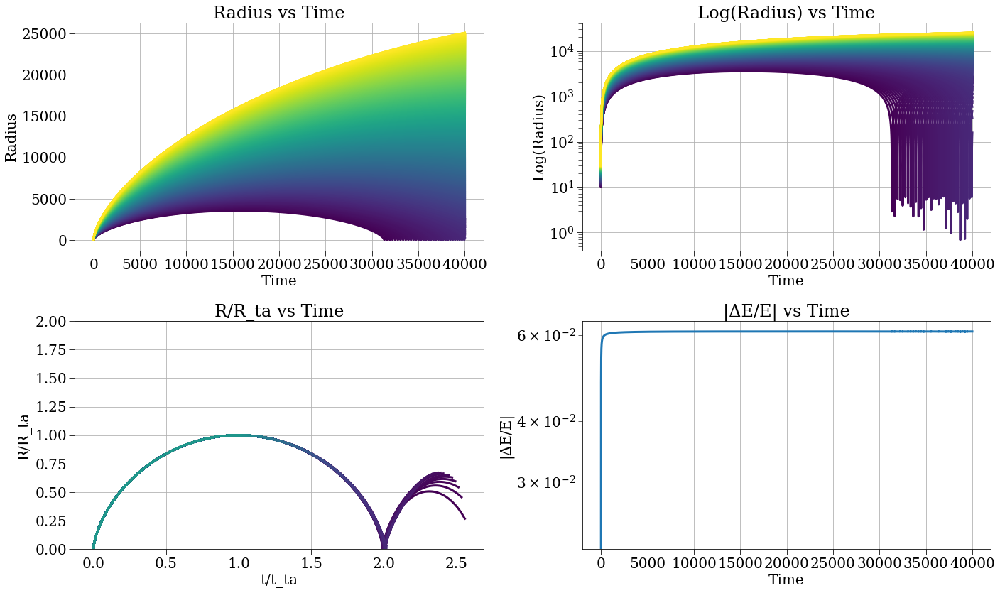

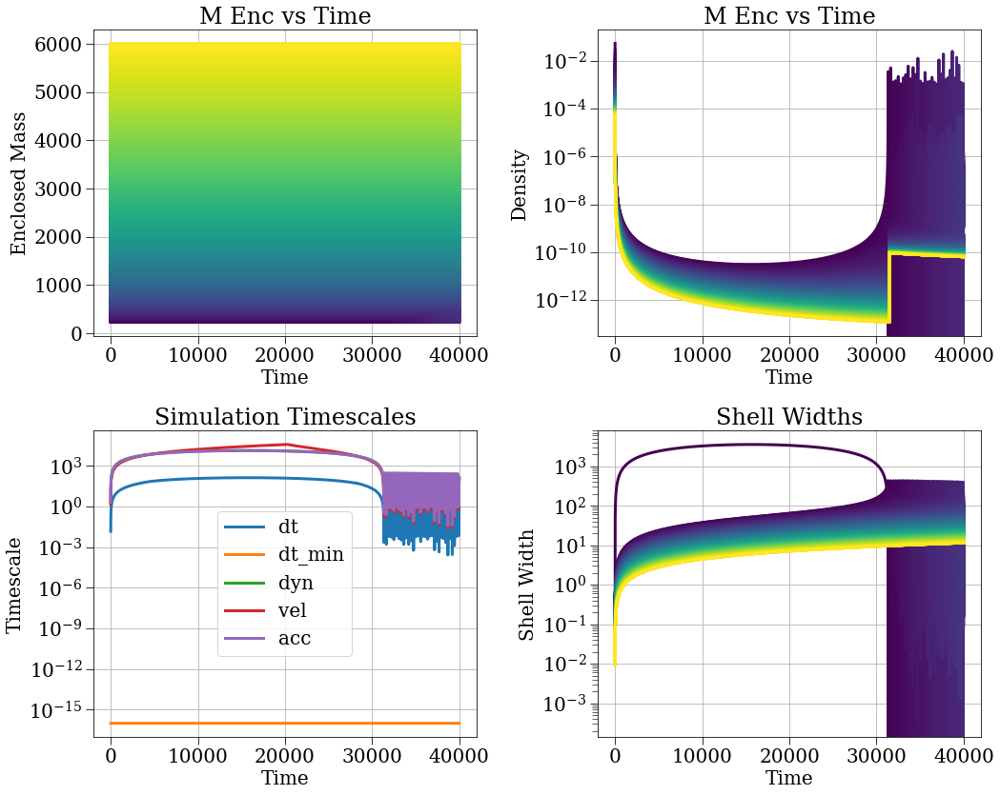

In [14]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

2025-07-09 16:16:30,210 - collapse - INFO - Simulation setup complete


r=[10.80008215 11.49657079 12.11762768 12.6808604  13.19809872 13.67771895
 14.12589473 14.54732262 14.94566835 15.32385443 15.68425284 16.02881826
 16.35918279 16.67672497 16.9826209  17.27788306 17.56339005 17.83990974
 18.10811768 18.36861164 18.62192343 18.86852853 19.10885398 19.34328488
 19.57216992 19.79582587 20.01454154 20.22858103 20.43818653 20.64358078
 20.84496914 21.04254138 21.23647332 21.42692814 21.61405762 21.79800322
 21.97889701 22.15686251 22.33201541 22.50446428 22.67431113 22.84165194
 23.00657715 23.1691721  23.32951739 23.48768925 23.64375989 23.79779771
 23.94986764 24.10003137 24.24834751 24.39487189 24.53965764 24.68275545
 24.82421366 24.96407846 25.10239396 25.23920238 25.3745441  25.50845782
 25.64098061 25.77214804 25.90199425 26.03055201 26.15785281 26.28392694
 26.40880352 26.5325106  26.65507518 26.77652328 26.89687997 27.01616946
 27.1344151  27.25163941 27.36786418 27.48311045 27.59739855 27.71074814
 27.82317828 27.93470737 28.04535326 28.15513323 

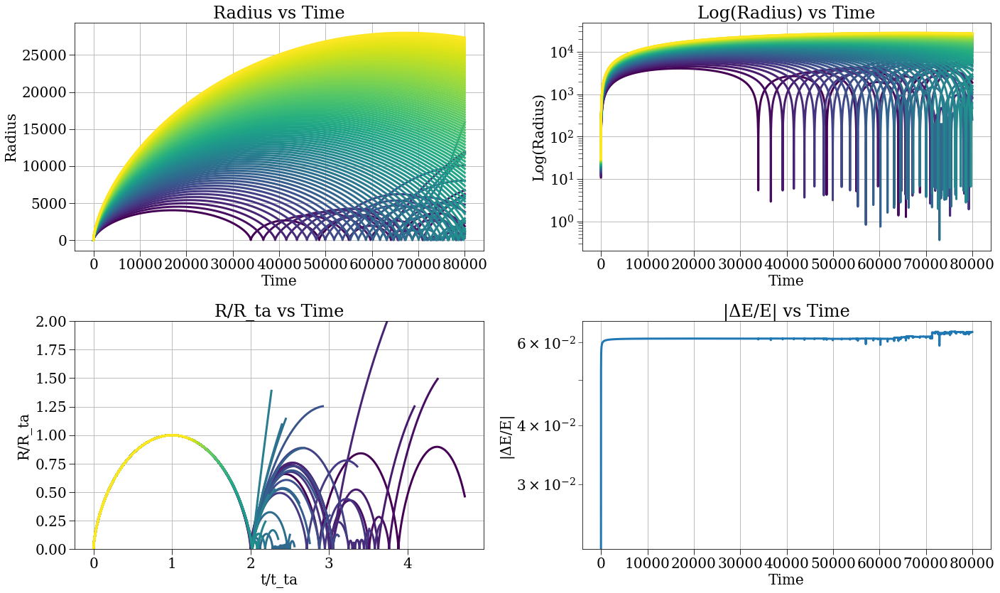

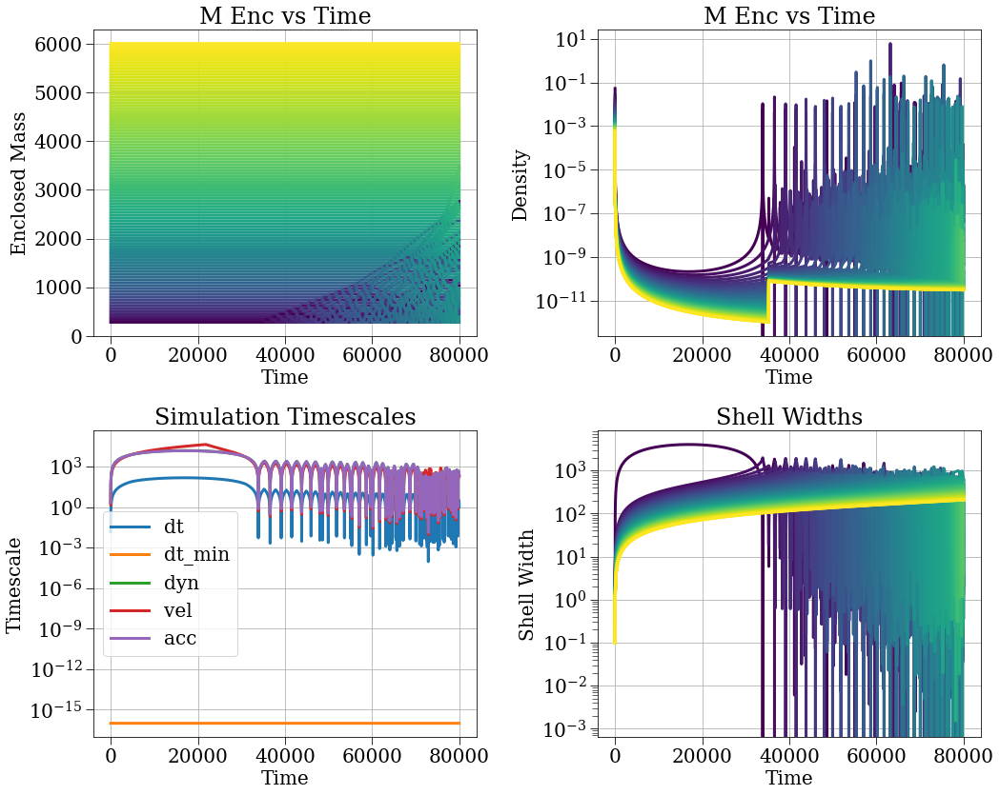

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

# profiles

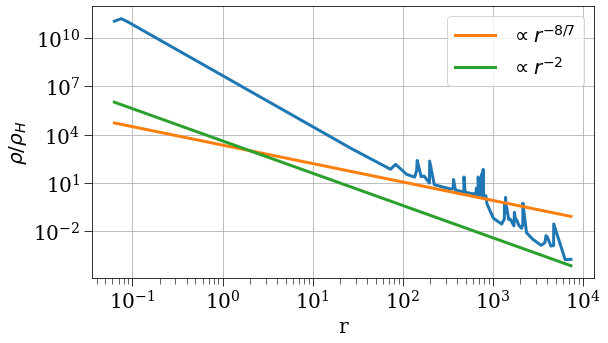

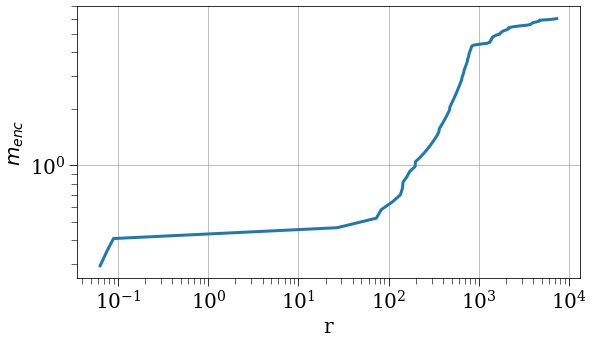

In [10]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
plt.plot(rvals, 1e3*(rvals/2e0)**(-8/7), label=r'$\propto r^{-8/7}$')
plt.plot(rvals, 1e3*(rvals/2e0)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, 3e-1*(rvals/1e1)**(13/7))
#plt.plot(rvals, 3e-1*(rvals/1e1))

plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
#plt.ylim(2e-1, 1e0)
plt.xscale('log')
plt.yscale('log')

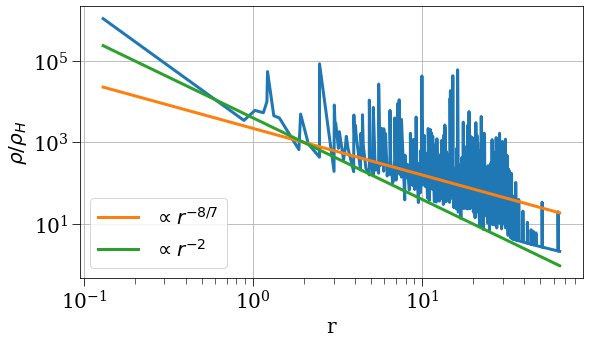

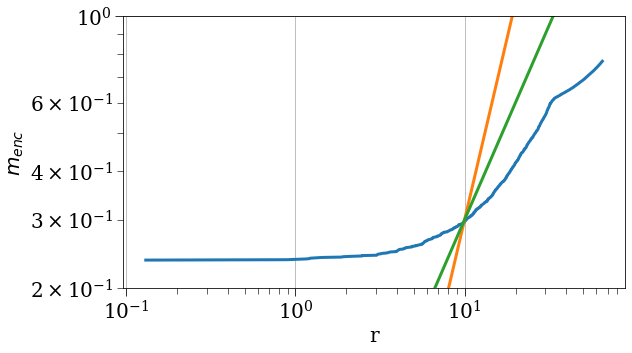

In [115]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
plt.plot(rvals, 1e3*(rvals/2e0)**(-8/7), label=r'$\propto r^{-8/7}$')
plt.plot(rvals, 1e3*(rvals/2e0)**(-2), label=r'$\propto r^{-2}$')
plt.legend()
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
plt.plot(rvals, 3e-1*(rvals/1e1)**(13/7))
plt.plot(rvals, 3e-1*(rvals/1e1))

plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.ylim(2e-1, 1e0)
plt.xscale('log')
plt.yscale('log')

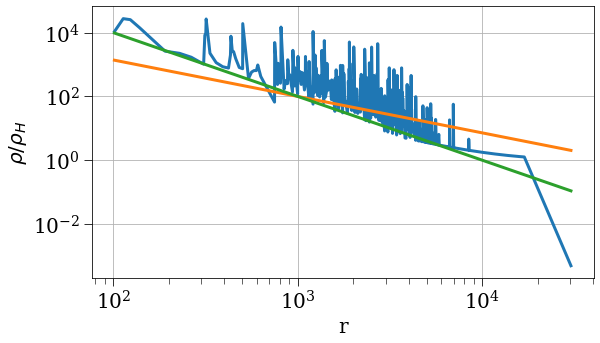

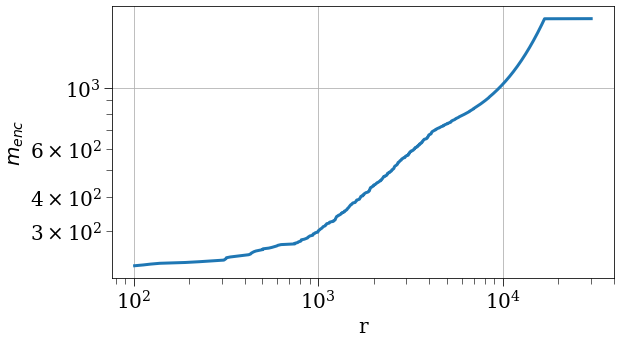

In [41]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
plt.plot(rvals, 1e2*(rvals/10**3)**(-8/7))
plt.plot(rvals, 1e2*(rvals/10**3)**(-2))
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

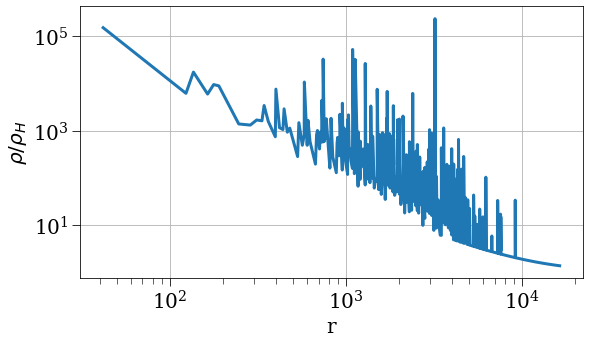

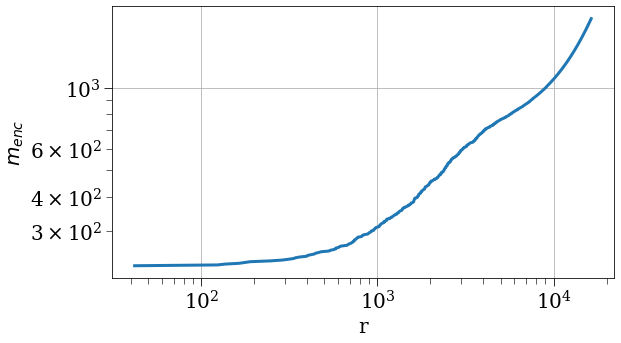

In [24]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
plt.plot(rvals, densityvals/rho_H * (tval+1)**2)
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

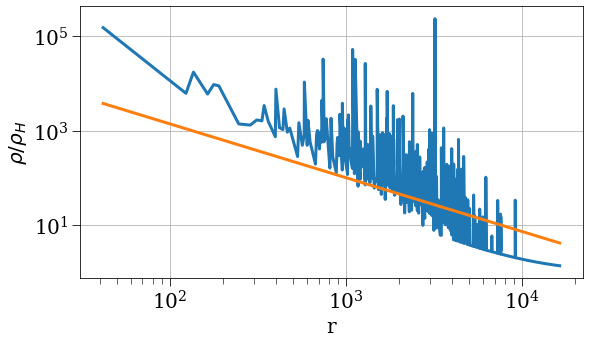

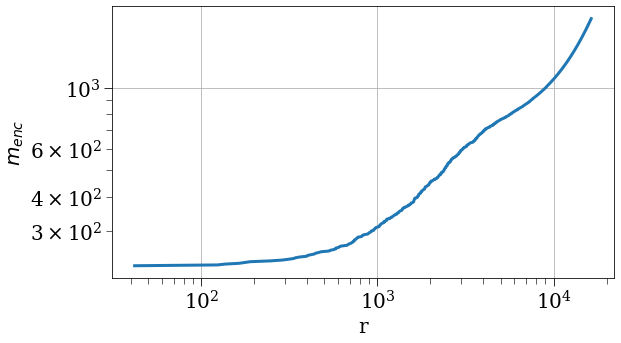

In [35]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
normalized_densityvals = densityvals/rho_H * (tval+1)**2
plt.plot(rvals, normalized_densityvals)
plt.plot(rvals, 1e2*(rvals/10**3)**(-8/7))
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
#plt.figure()
#plt.plot(rvals[:-1], np.diff(np.log(normalized_densityvals)/np.log(rvals)))
plt.xscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

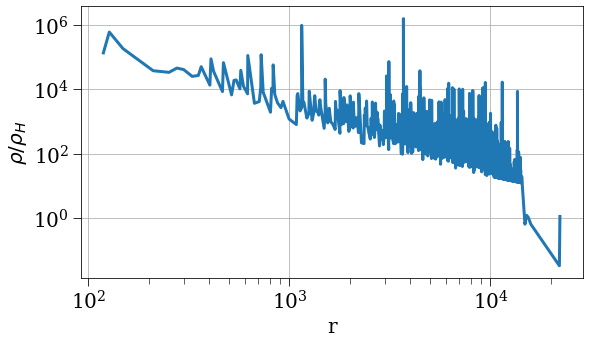

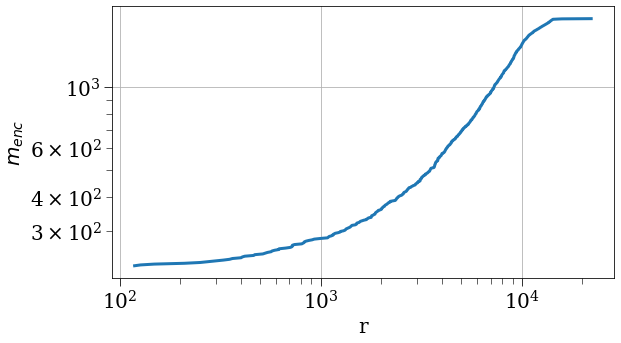

In [6]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
plt.plot(rvals, densityvals/rho_H * (tval+1)**2)
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

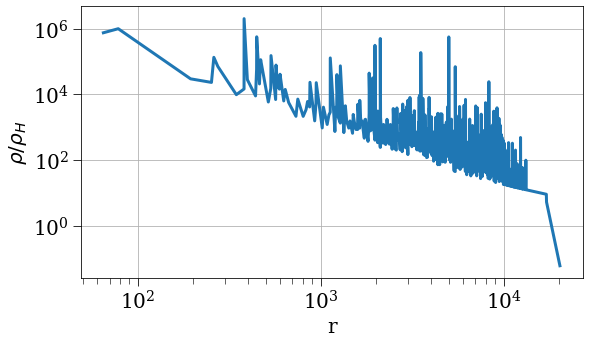

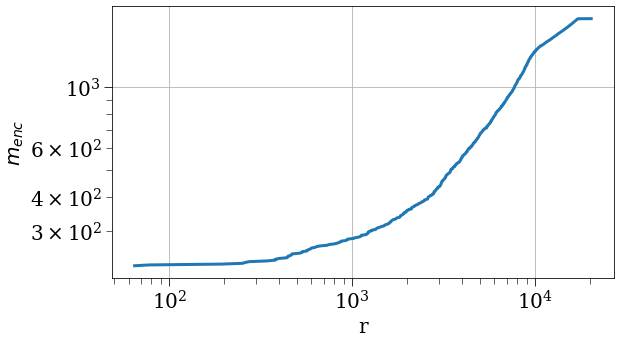

In [7]:
idx = -100
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
plt.plot(rvals, densityvals/rho_H * (tval+1)**2)
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

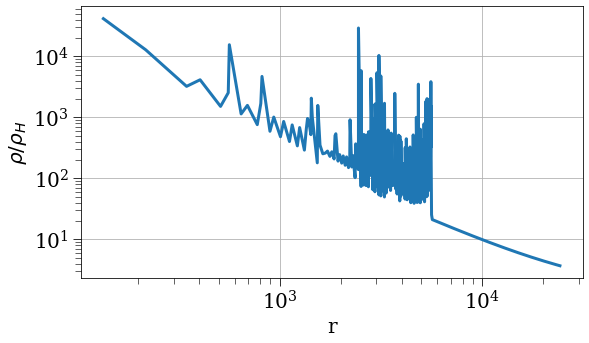

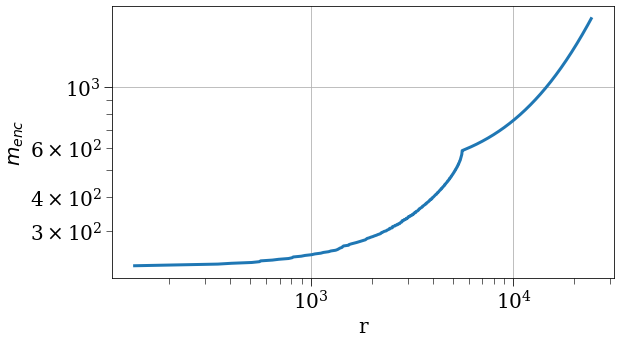

In [8]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
plt.plot(rvals, densityvals/rho_H * (tval+1)**2)
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

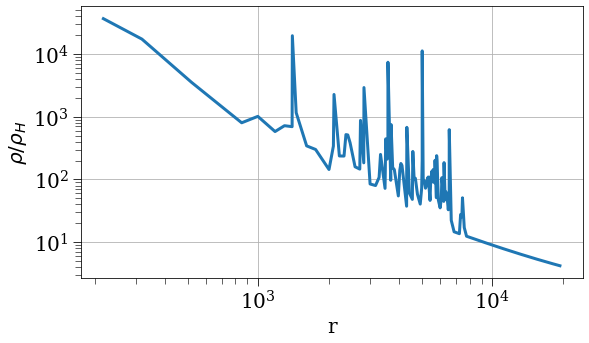

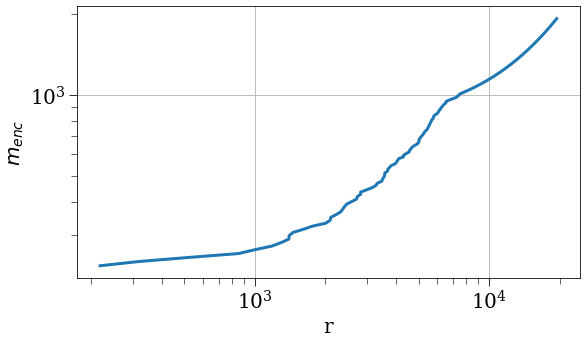

In [38]:
idx = -1
tval = results['t'][idx]
sorted_indices = np.argsort(results['r'][idx,:])
m = results['m'][0,0]
rvals = results['r'][idx,:][sorted_indices]
mencvals = results['m_enc'][idx,:][sorted_indices]
volvals = 4/3 * np.pi * np.diff(np.array([0, *rvals])**3)
densityvals = m / volvals
plt.plot(rvals, densityvals/rho_H * (tval+1)**2)
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.xscale('log')
plt.yscale('log')
plt.figure()
plt.plot(rvals, mencvals)
#plt.plot(rvals, rvals**(3/4))
plt.xlabel('r')
plt.ylabel(r'$m_{enc}$')
plt.xscale('log')
plt.yscale('log')

### Jacobian Calculations

$$
\mathcal E = \frac{1}{2}v^2 - \frac{GM}{r} + \mathcal E_{other}
$$
$$
\frac{\partial\mathcal E}{\partial R_0} = v\dot s + GM \frac{s}{r^2} - 4\pi G R_0^2 \rho_0(R_0) \frac{1}{r} + \frac{\partial\mathcal E_{other}}{\partial R_0}
$$

0.3485372508864725 0.4444444444444444
0.08841941282883074 0.08320713949536328
The solver successfully reached the end of the integration interval.


(-1.0, 10.0)

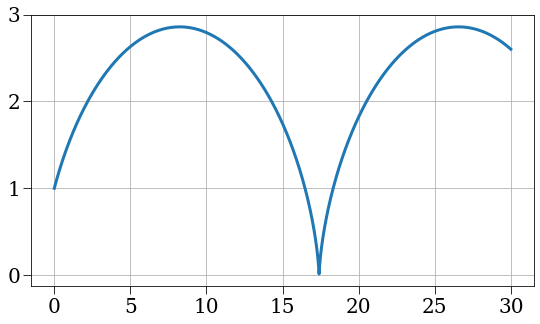

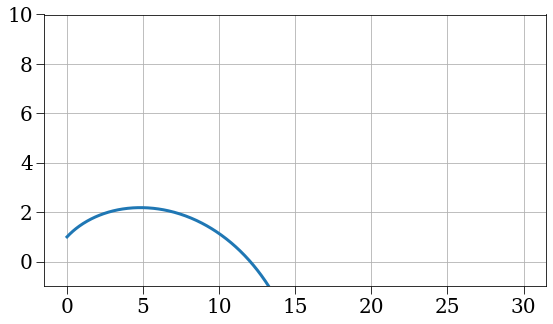

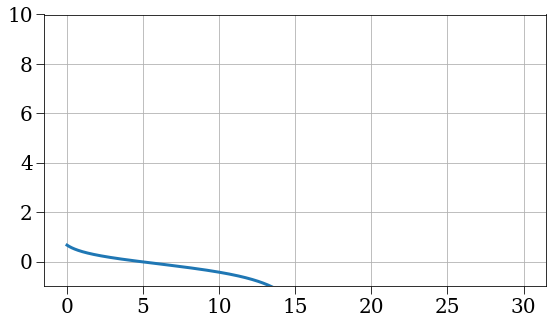

In [8]:
from scipy.integrate import solve_ivp

def a_grav(y, R0, menc0, G=1, j=1e-1):
    r, v, s, sdot = y
    return -G * menc0 / r**2 + j**2/r**3

def s_double_dot_grav(y, R0, menc0, rho0, G=1):
    r, v, s, sdot = y
    return 2*G*menc0 * 1/r**3 * s - 4*np.pi*G*rho0*R0**2 * 1/r**2

# def s_double_dot_grav(y, R0, menc0, rho0, G=1):
#     r, v, s, sdot = y
#     return 2/r**3 * s - 3/r**2

def f(t, y, a_func, R0, menc0, rho0, dsdotdt_func, G=1):
    r, v, s, sdot = y
    drdt = v
    dvdt = a_func(y, R0, menc0)
    dsdt = sdot
    dsdotdt = dsdotdt_func(y, R0, menc0, rho0)
    return np.array([drdt, dvdt, dsdt, dsdotdt])

def rho0_background_plus_power_law(R0, delta0, r_max, gamma, rho_bar=rho_H):
    power_law_part = delta0 * (3+gamma)/3 * (R0/r_max)**gamma
    retval = rho_bar * (1 + power_law_part)
    return retval

def rho0_background_plus_gaussian(R0, delta0, r_gaussian, rho_bar=rho_H):
    gaussian_part = np.exp(-(R0 / r_gaussian)**2)
    retval = rho_bar * (1 + delta0 * gaussian_part)
    return retval

R0 = 1
gamma = -1
r_max = 1
r_gaussian = 1
delta0 = 1
rho0 = rho0_background_plus_power_law(R0, delta0, r_max, gamma)
n_points = 10_000
eps = 1e-12 # avoid potential singularity at r=0
r_grid = np.logspace(np.log10(eps), np.log10(R0), n_points)

# Calculate density on the grid
# rho_grid = rho0_background_plus_power_law(r_grid, delta0, r_max, gamma, rho_bar=rho_H)
rho_grid = rho0_background_plus_power_law(r_grid, delta0, r_gaussian, rho_bar=rho_H)


M_enc_grid = 4*np.pi * integrate.cumulative_trapezoid(
    rho_grid * r_grid**2, 
    r_grid,
    initial=0
)
menc0 = M_enc_grid[-1]
print(menc0, 2/9 * (1+delta0))
t_end = 30
t_eval = np.linspace(0, t_end, int(1e7))
y0 = np.array([R0, 2/3 * R0, 1, 2/3])
args = (a_grav, R0, menc0, rho0, s_double_dot_grav)
print(rho0, menc0/(4/3*np.pi*R0**3))
sol = solve_ivp(f, [0, t_end], y0, args=args, method='BDF', atol=1e-10, rtol=1e-10)
print(sol.message)
plt.plot(sol.t, sol.y[0])
plt.figure()
plt.plot(sol.t, sol.y[2])
plt.ylim(-1,10)
plt.figure()
plt.plot(sol.t, sol.y[3])
plt.ylim(-1,10)

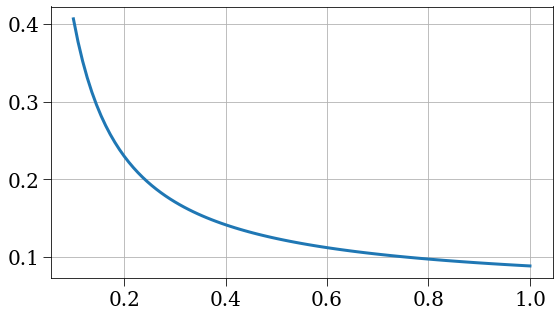

In [104]:
R0vals = np.linspace(0.1, 1, 100)
rhos = rho0_background_plus_power_law(R0vals, delta0, r_max, gamma, rho_bar=rho_H)
plt.plot(R0vals, rhos)

2025-07-08 00:43:26,554 - collapse - INFO - Simulation setup complete


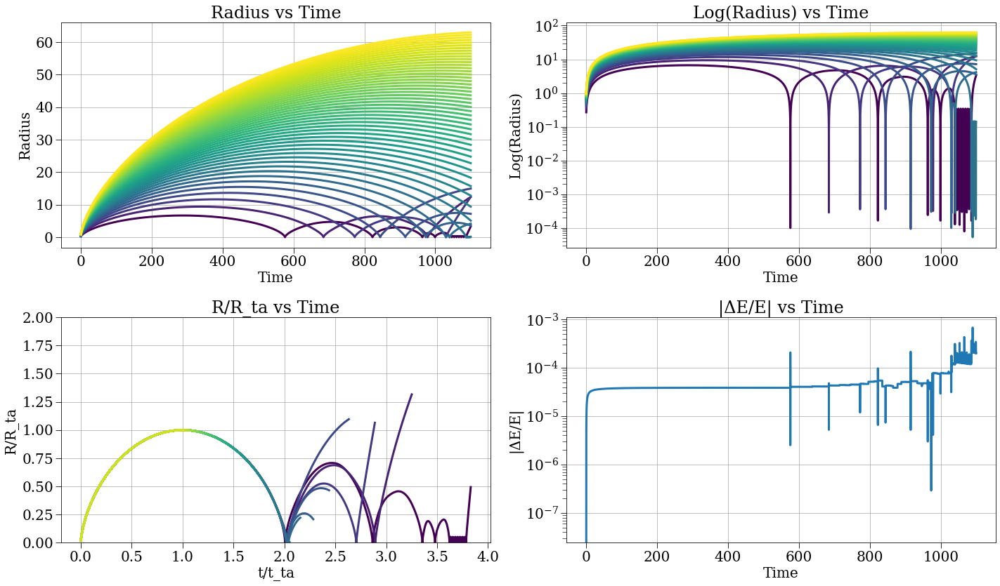

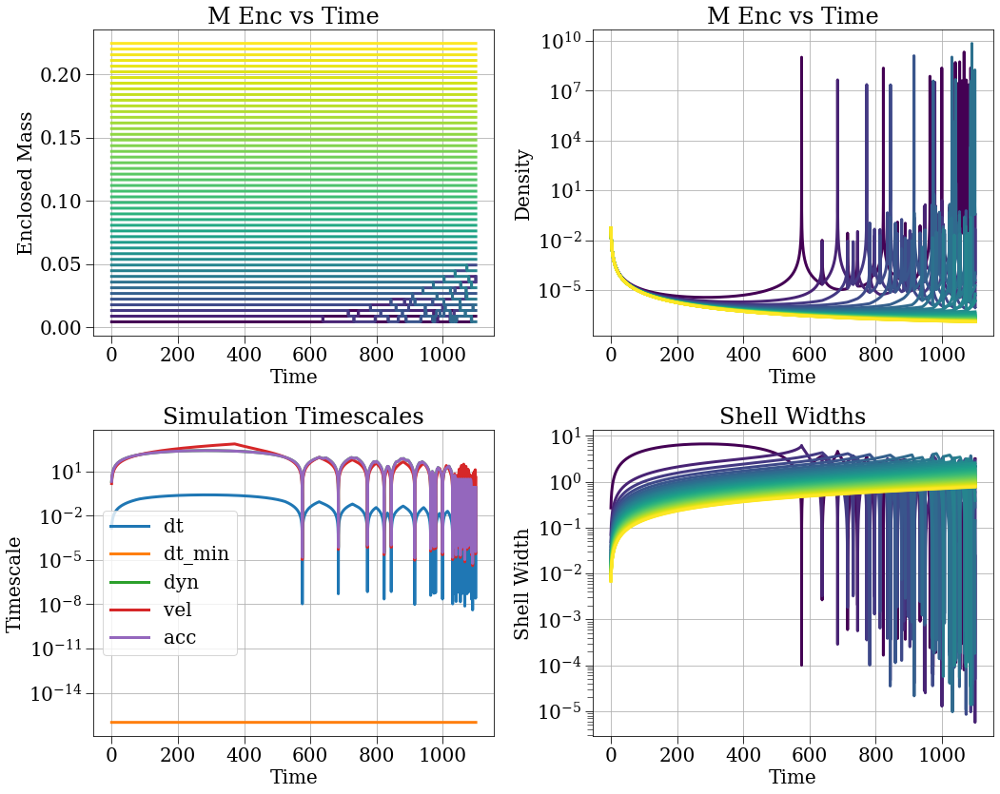

In [34]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)

In [75]:
r_max = 1
j_coef = 1e-4
N = 50
t_max = 1300
safety_factor = 1e-3
delta = 1e-2
irs = 'equal_mass'#'r0min_start_equal'
ivs = 'peculiar'
gamma = -1

: 

In [76]:
config = make_config(N=N, r_min=0, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy='background_plus_power_law', delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_kdk',  timescale_strategy='dyn_vel_acc', H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

2025-07-03 02:44:06,497 - collapse - INFO - Simulation setup complete


: 

: 

In [15]:
config = make_config(N=N, r_min=0, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy='background_plus_power_law', delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy='dyn_vel_acc', H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

0.23857241960761966

In [6]:
config = make_config(N=N, r_min=0, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy='background_plus_power_law', delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_kdk',  timescale_strategy='dyn_vel_acc', H=H0, initial_radius_strategy='r0min_start_equal', gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

2025-07-03 10:29:00,080 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

In [ ]:
config = make_config(N=N, r_min=0, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy='background_plus_power_law', delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy='dyn_vel_acc', H=H0, initial_radius_strategy='r0min_start_equal', gamma=gamma, initial_v_strategy=ivs)
sc, results, plotter = run_sc(config)

In [70]:
t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
theta_vals = np.linspace(0, 2*np.pi, 1000)

def delta_m(m_pert):
    return m_pert / (4*np.pi*rho_H)
def lambda_theta(theta):
    # Add small epsilon to avoid division by zero
    eps = 1e-10
    return 0.5*(1-np.cos(theta))*((theta-np.sin(theta) + eps)/np.pi)**(-8/9)
# Create theta_vals and corresponding lambda_vals
theta_vals = np.linspace(1e-6, 2*np.pi, 1000)
lambda_vals = lambda_theta(theta_vals)

# Create the inverse mapping (lambda -> theta)
theta_lambda = interp1d(lambda_vals, theta_vals, bounds_error=False, fill_value=np.nan)
def r_ta(r_i, m_pert):
    return r_i**4 / (3*delta_m(m_pert))
def t_ta(r_i, m_pert, H):
    return np.pi*r_i**(9/2) / (6*np.sqrt(3)*H*delta_m(m_pert)**(3/2))
def r_theta(r_i, m_pert, theta):
    return r_ta(r_i, m_pert)/2 * (1-np.cos(theta))
def t_theta(r_i, m_pert, H, theta):
    return t_ta(r_i, m_pert, H)/np.pi * (theta-np.sin(theta))
def theta_t(r_i, m_pert, H, t):
    return interp1d(theta_vals, t_theta(r_i, m_pert, H, theta_vals), fill_value=0)(t)
def v_lambda(lam):
    theta = theta_lambda(lam)
    return lam * (np.sin(theta)*(theta-np.sin(theta)))/(1-np.cos(theta))**2
def tau(t, t_i):
    return t_i + t/t_i
def shifted_t(t, t_i):
    return t + t_i
def r_cta(t, m_pert, H):
    return (1/3)*(6*np.sqrt(3)*H/np.pi)**(8/9) * delta_m(m_pert)**(1/3) * (shifted_t(t, t_i))**(8/9)
def lambda_rt(r, t, m_pert, H):
    return r / r_cta(t, m_pert, H)
def m_lambda(lam, H):
    theta = theta_lambda(lam)
    return lam**3 * (2/H**2) * (theta-np.sin(theta))**2/(1-np.cos(theta))**3
def d_lambda(lam, H):
    return m_lambda(lam, H)/lam**3 * 1/(4-(9/2)*v_lambda(lam)/lam)
def rho_H_t(t):
    return rho_H * (1+t/t_i)**(-2)
def m_from_results(t, m_enc, m_pert, H):
    return m_enc / (4/3 * np.pi * rho_H_t(t) * r_cta(t, m_pert, H)**3)
def d_from_results(t, m_shell, r_shell, r_prev_shell):
    vol_shell = 4/3 * np.pi * (r_shell**3 - r_prev_shell**3)
    return (m_shell/vol_shell) / rho_H_t(t)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in power
/home/jsipple/.conda/envs/j

(0.0, 1.0)

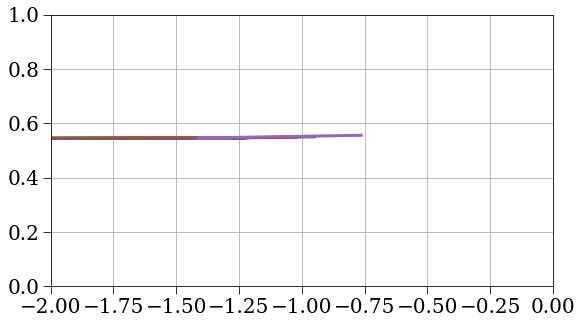

In [72]:
tvals = results['t']
for i in range(N):
    rvals = results['r'][:, i]
    mval = results['m_enc'][0, i]
    m_pert = mval - 4/3 * np.pi * rvals**3 * rho_H
    lam = lambda_rt(rvals, tvals, m_pert, H0)
    plt.plot(np.log10(lam), np.log10(m_lambda(lam, H0)))
plt.xlim(-2, 0)
plt.ylim(0, 1)

2025-06-30 15:43:20,218 - collapse - INFO - Simulation setup complete


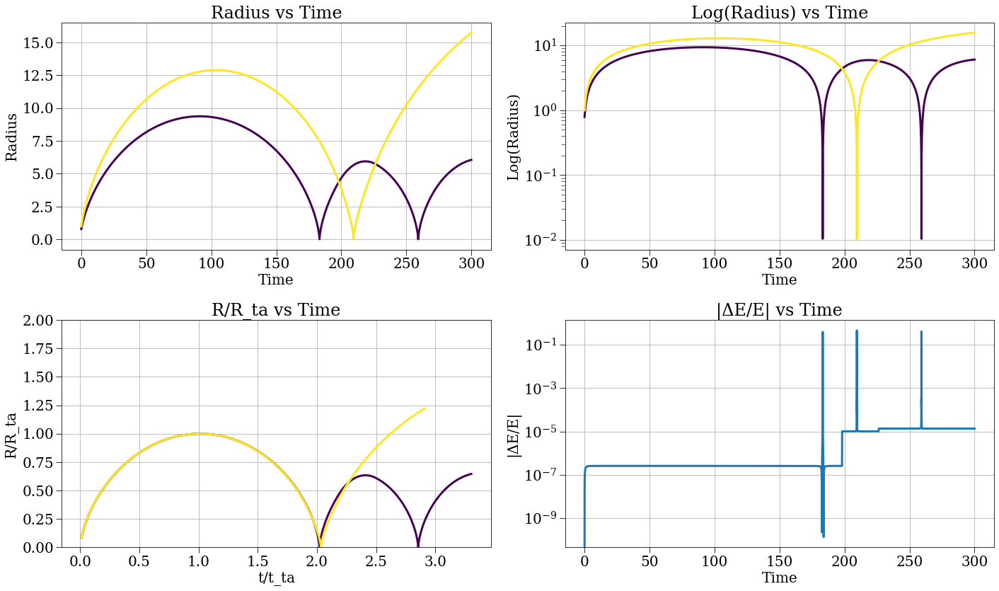

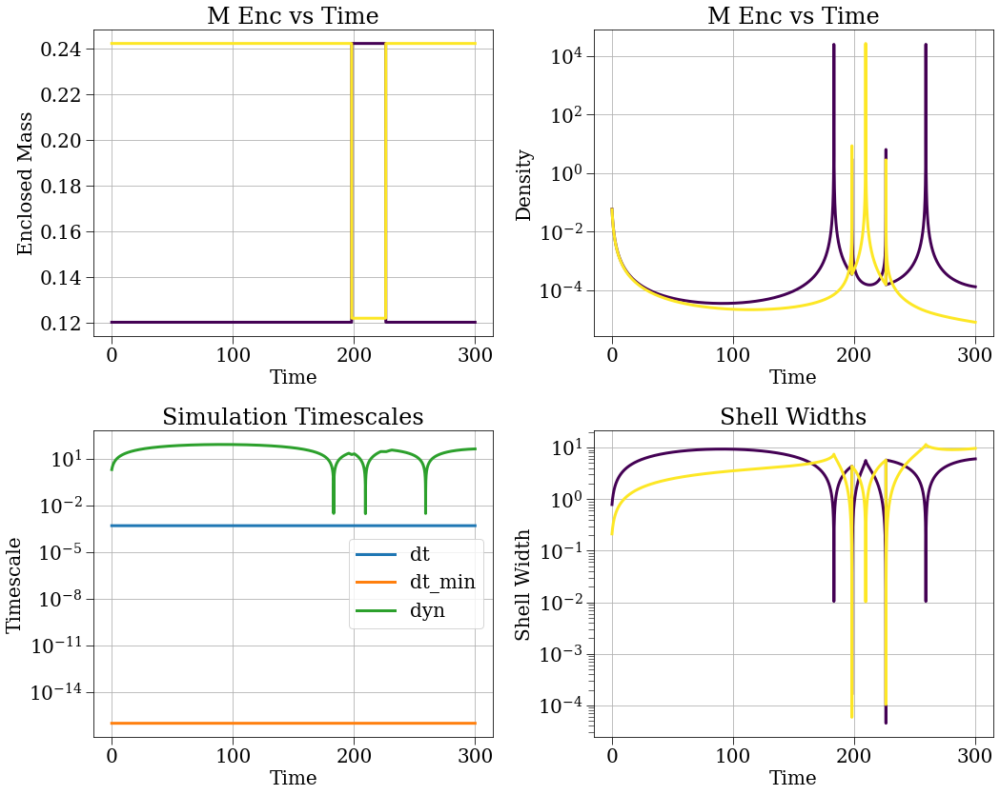

In [25]:
config = make_config(N=N, r_min=0, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=1e-4, density_strategy='background_plus_gaussian', tophat_radius=1, delta=0.2, safety_factor=safety_factor, stepper_strategy='leapfrog_kdk',  timestep_strategy='const', dt=5e-4, H=H0, initial_radius_strategy=irs)
sc, results, plotter = run_sc(config)

### Fixed Time Step

2025-06-19 02:39:30,580 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


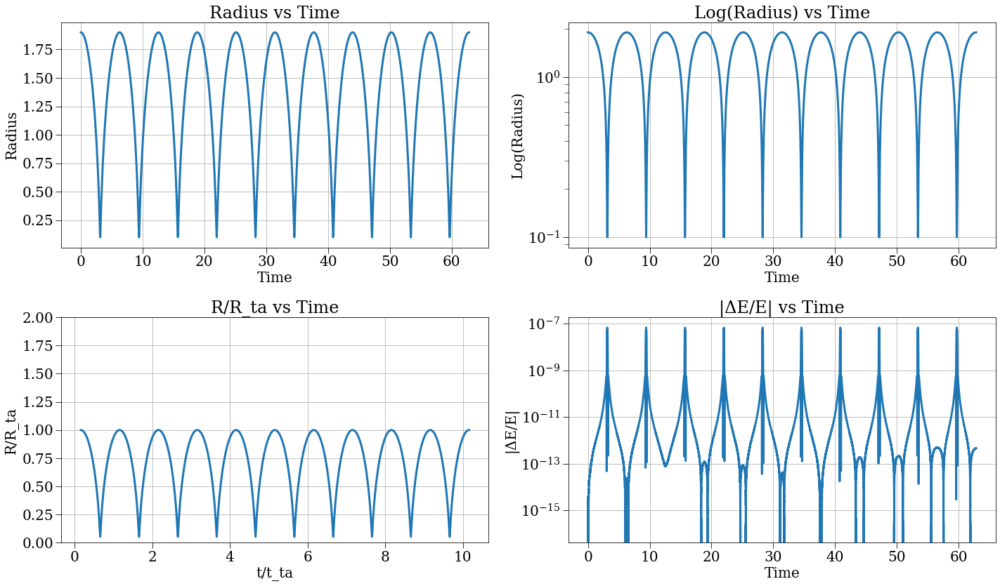

In [26]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1+e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=20*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=5e-3, stepper_strategy='leapfrog_kdk', timestep_strategy='const', dt=1e-5)
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$\\Delta T_{peri}$')

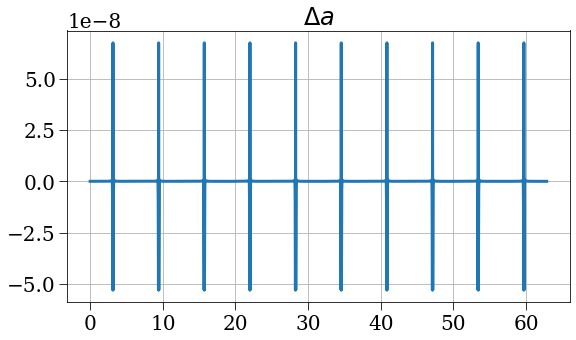

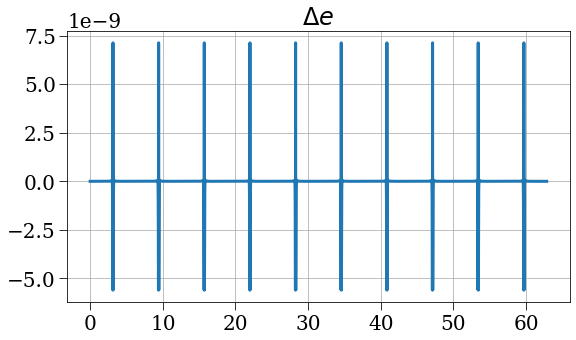

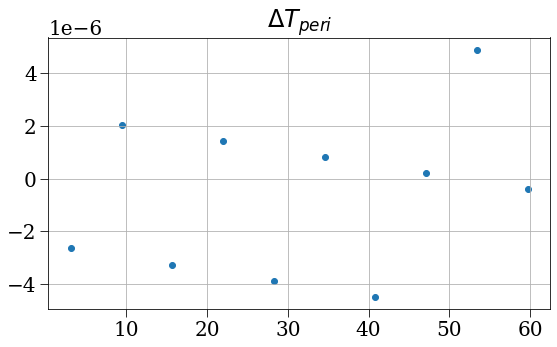

In [27]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

minima_idx = sps.argrelmin(r)
t_minima = t[minima_idx]
r_minima = r[minima_idx]

# continues past 2pi
#M_anom = np.unwrap(M_anom)

# T_peri = t - 1/np.sqrt(menc) * M_anom
# T = 2*np.pi * np.sqrt(a**3/menc)
# T_peri_true = (T - t) % T
# print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
t_peri_true = [(2*k+1)*np.pi for k in range(10)]
plt.scatter(t_minima, t_minima-t_peri_true)
plt.title(r'$\Delta T_{peri}$')


# plt.figure()
# plt.plot(t, M_anom)
# plt.title(r'$M_{anom}$')
# plt.figure()
# plt.plot(t, T_peri % T)
# plt.title(r'$T_{peri}$')
# plt.figure()
# plt.plot(t, (T_peri % T) - T_peri_true)
# plt.title(r'$T_{peri}$')

2025-06-19 02:35:00,864 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


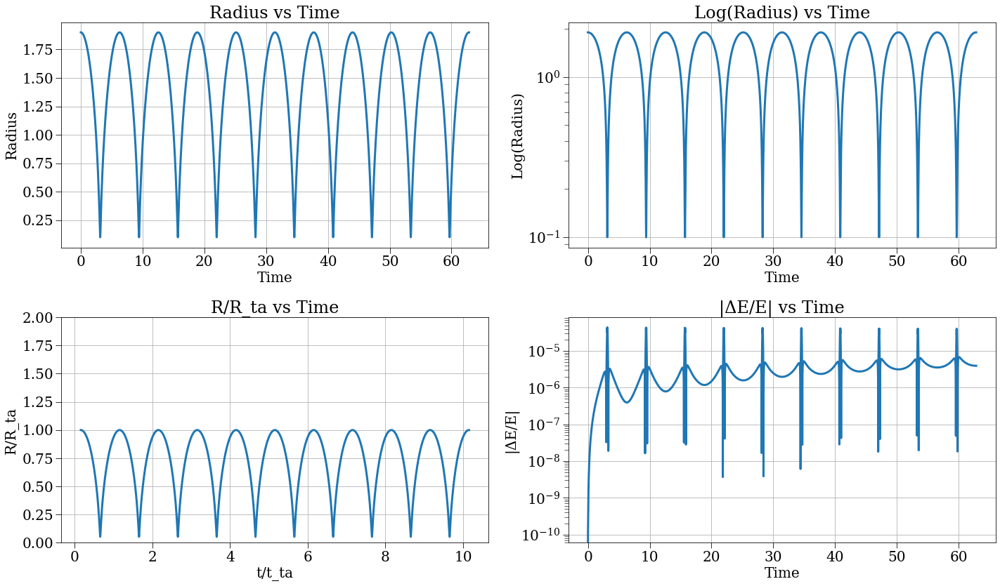

In [22]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1+e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=20*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=5e-3, stepper_strategy='beeman',)
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$\\Delta T_{peri}$')

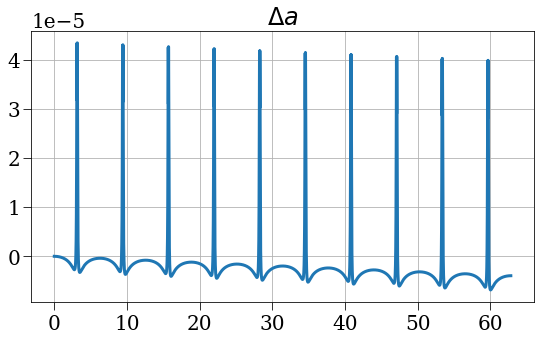

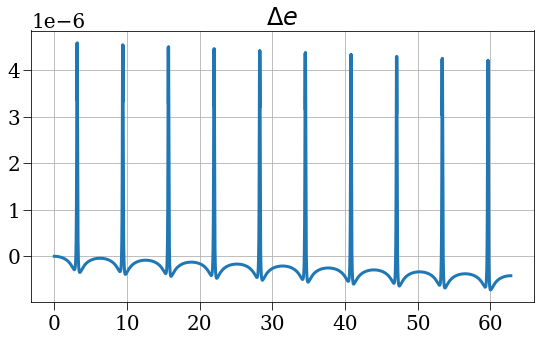

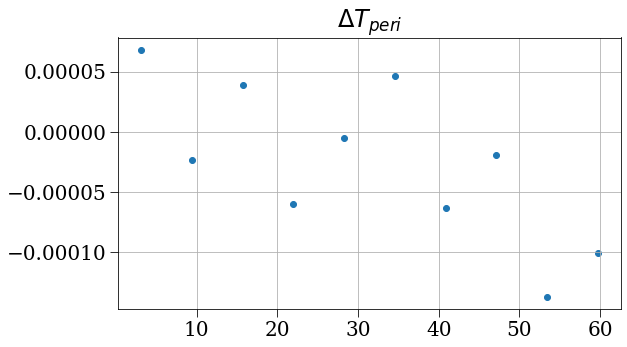

In [23]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

minima_idx = sps.argrelmin(r)
t_minima = t[minima_idx]
r_minima = r[minima_idx]

# continues past 2pi
#M_anom = np.unwrap(M_anom)

# T_peri = t - 1/np.sqrt(menc) * M_anom
# T = 2*np.pi * np.sqrt(a**3/menc)
# T_peri_true = (T - t) % T
# print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
t_peri_true = [(2*k+1)*np.pi for k in range(10)]
plt.scatter(t_minima, t_minima-t_peri_true)
plt.title(r'$\Delta T_{peri}$')


# plt.figure()
# plt.plot(t, M_anom)
# plt.title(r'$M_{anom}$')
# plt.figure()
# plt.plot(t, T_peri % T)
# plt.title(r'$T_{peri}$')
# plt.figure()
# plt.plot(t, (T_peri % T) - T_peri_true)
# plt.title(r'$T_{peri}$')

### 'Symplectic' Leapfrog - 10 orbits - ~1000 steps per orbit

2025-06-19 11:39:10,316 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


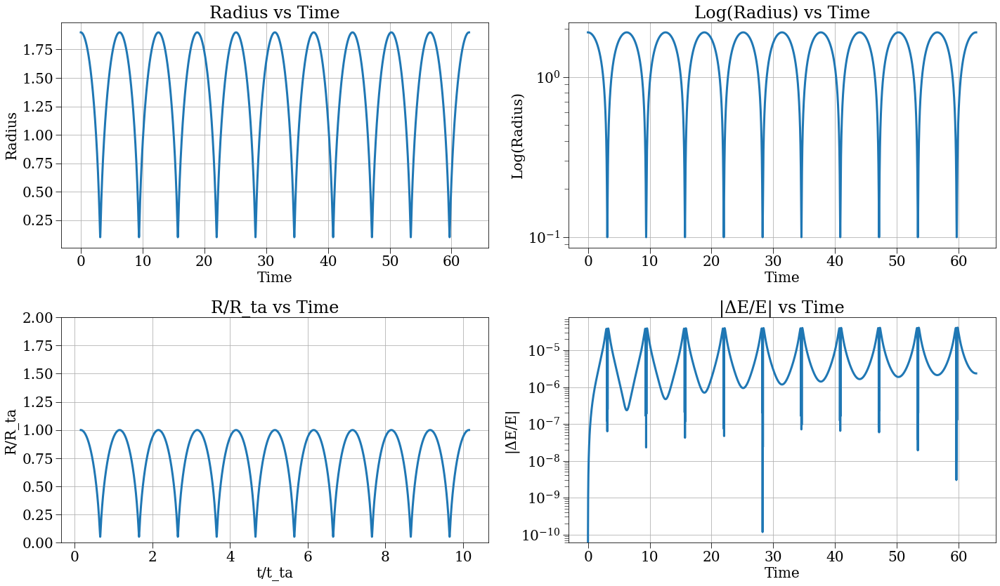

In [8]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1+e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=20*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=5e-3, stepper_strategy='leapfrog_hut', timestep_strategy='const_but_calculate')
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

Text(0.5, 1.0, 'dt')

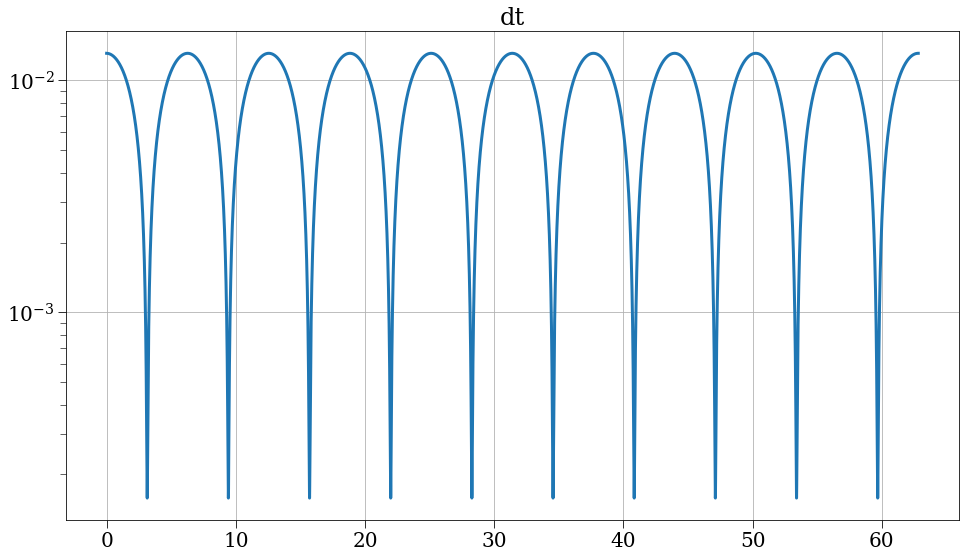

In [11]:
tvals = results['t'] 
plt.figure(figsize=(16,9))
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$\\Delta T_{peri}$')

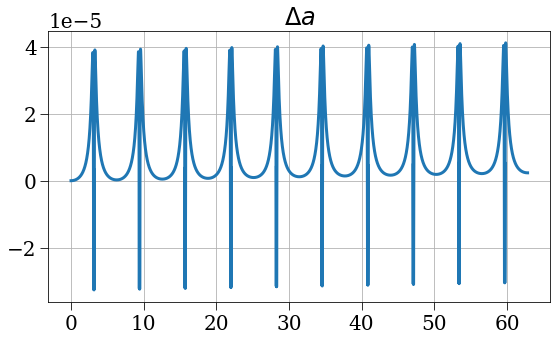

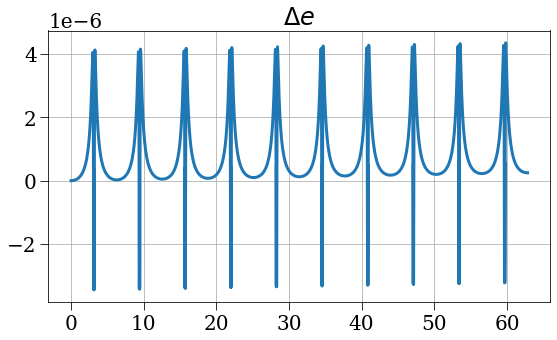

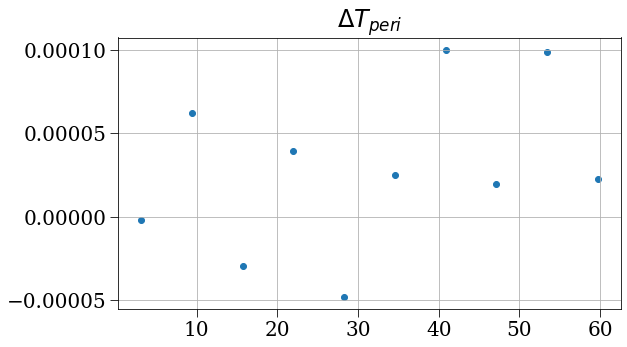

In [9]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

minima_idx = sps.argrelmin(r)
t_minima = t[minima_idx]
r_minima = r[minima_idx]

# continues past 2pi
#M_anom = np.unwrap(M_anom)

# T_peri = t - 1/np.sqrt(menc) * M_anom
# T = 2*np.pi * np.sqrt(a**3/menc)
# T_peri_true = (T - t) % T
# print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
t_peri_true = [(2*k+1)*np.pi for k in range(10)]
plt.scatter(t_minima, t_minima-t_peri_true)
plt.title(r'$\Delta T_{peri}$')


# plt.figure()
# plt.plot(t, M_anom)
# plt.title(r'$M_{anom}$')
# plt.figure()
# plt.plot(t, T_peri % T)
# plt.title(r'$T_{peri}$')
# plt.figure()
# plt.plot(t, (T_peri % T) - T_peri_true)
# plt.title(r'$T_{peri}$')

### Naive Leapfrog - 10 orbits - ~1000 steps per orbit

2025-06-19 02:30:13,346 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


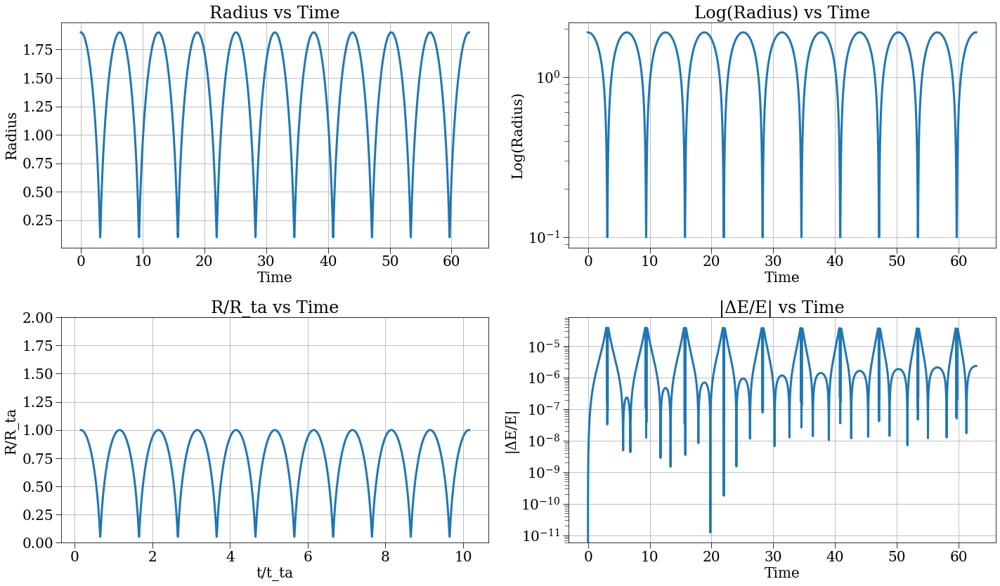

In [20]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1-e**2) / (1-e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=20*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=5e-3,)
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$\\Delta T_{peri}$')

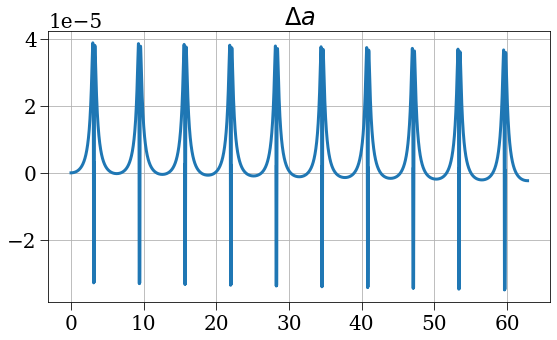

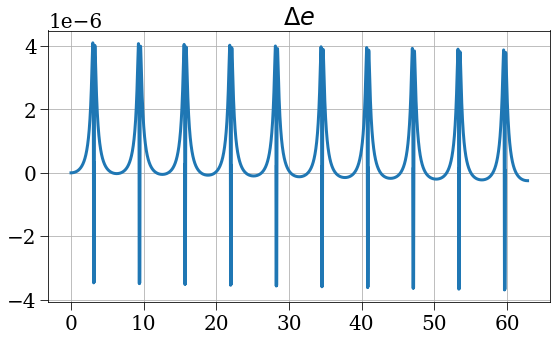

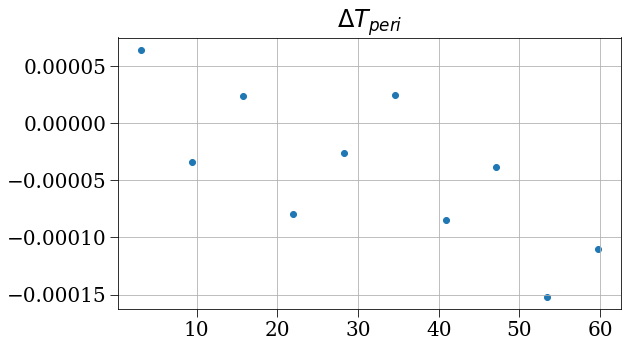

In [21]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

minima_idx = sps.argrelmin(r)
t_minima = t[minima_idx]
r_minima = r[minima_idx]

# continues past 2pi
#M_anom = np.unwrap(M_anom)

# T_peri = t - 1/np.sqrt(menc) * M_anom
# T = 2*np.pi * np.sqrt(a**3/menc)
# T_peri_true = (T - t) % T
# print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
t_peri_true = [(2*k+1)*np.pi for k in range(10)]
plt.scatter(t_minima, t_minima-t_peri_true)
plt.title(r'$\Delta T_{peri}$')


# plt.figure()
# plt.plot(t, M_anom)
# plt.title(r'$M_{anom}$')
# plt.figure()
# plt.plot(t, T_peri % T)
# plt.title(r'$T_{peri}$')
# plt.figure()
# plt.plot(t, (T_peri % T) - T_peri_true)
# plt.title(r'$T_{peri}$')

2025-06-18 19:20:23,336 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


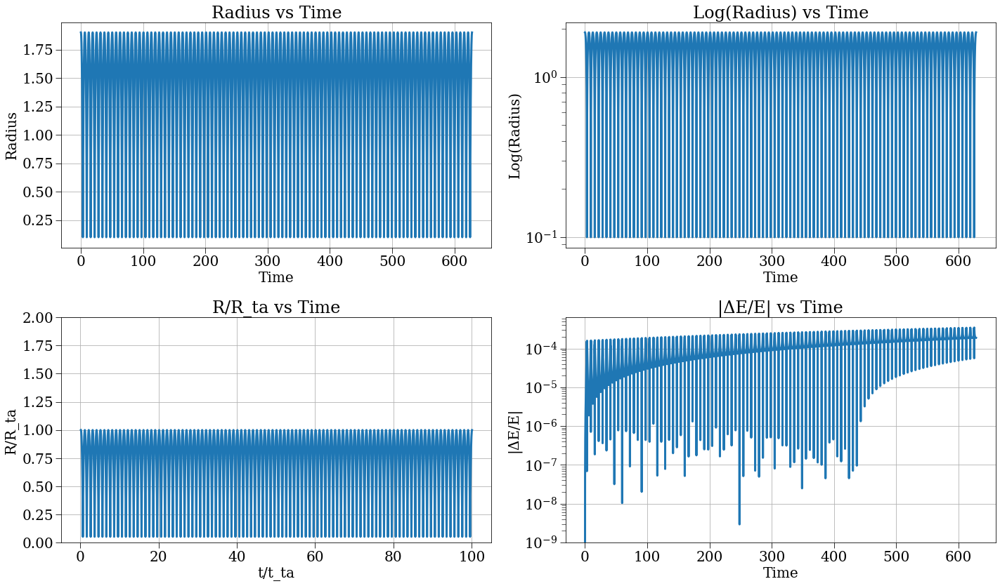

In [7]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1-e**2) / (1-e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=200*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=1e-2, stepper_strategy='leapfrog_hut', timestep_strategy='const_but_calculate')
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

[6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$T_{peri}$')

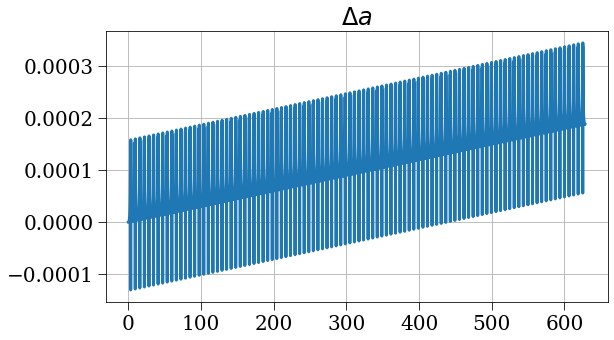

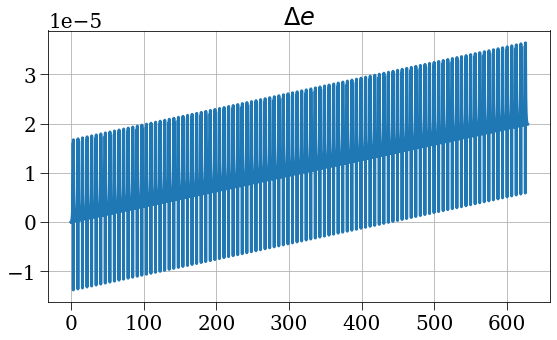

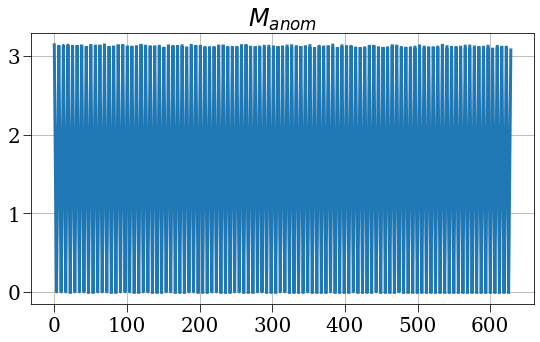

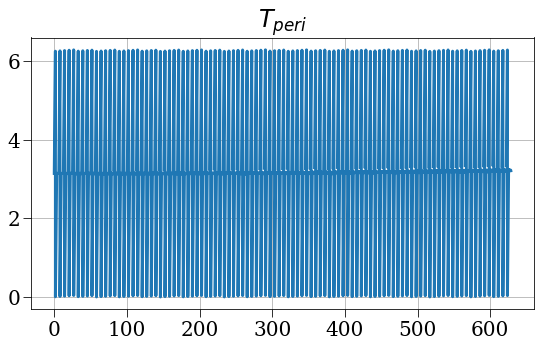

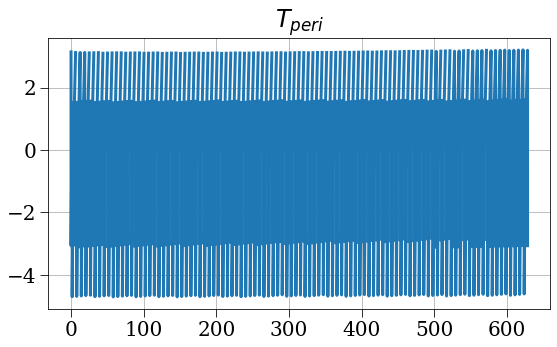

In [8]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

# continues past 2pi
#M_anom = np.unwrap(M_anom)

T_peri = t - 1/np.sqrt(menc) * M_anom
T = 2*np.pi * np.sqrt(a**3/menc)
T_peri_true = (T - t) % T
print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
plt.plot(t, M_anom)
plt.title(r'$M_{anom}$')
plt.figure()
plt.plot(t, T_peri % T)
plt.title(r'$T_{peri}$')
plt.figure()
plt.plot(t, (T_peri % T) - T_peri_true)
plt.title(r'$T_{peri}$')

In [6]:
min(results['dt'])

1e-05

2025-06-18 17:40:39,220 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


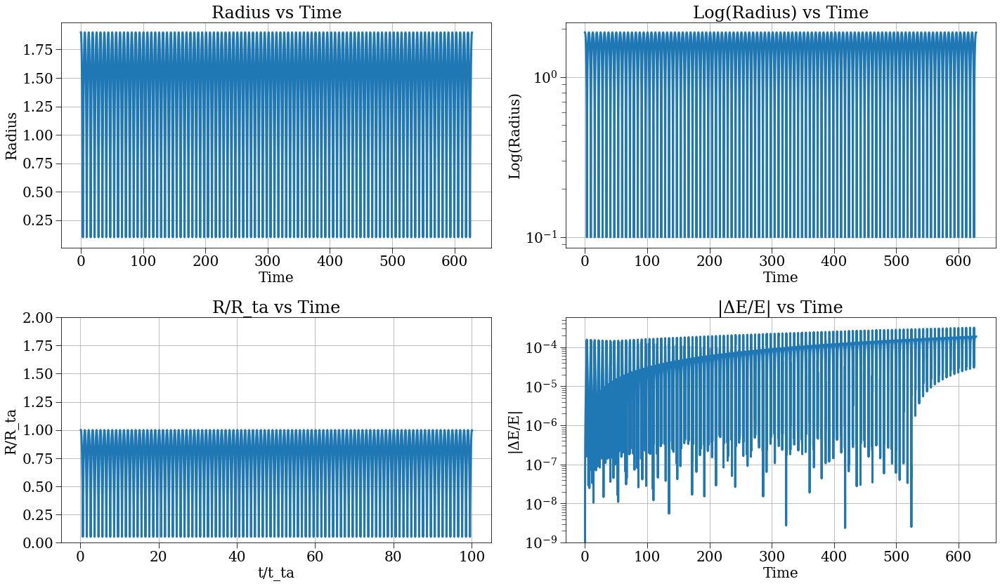

In [33]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1-e**2) / (1-e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=200*np.pi, j_coef=j_coef, save_dt=1e-4, rho_bar=rho_bar, safety_factor=1e-2,)
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

[6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


Text(0.5, 1.0, '$T_{peri}$')

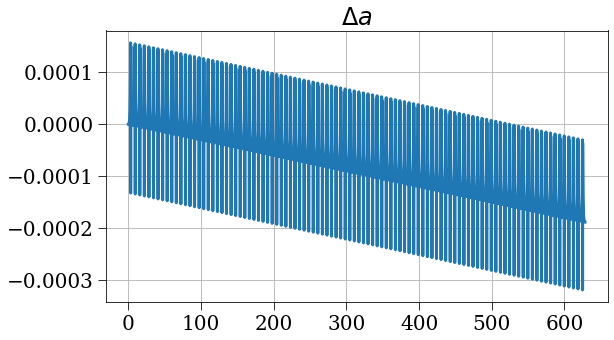

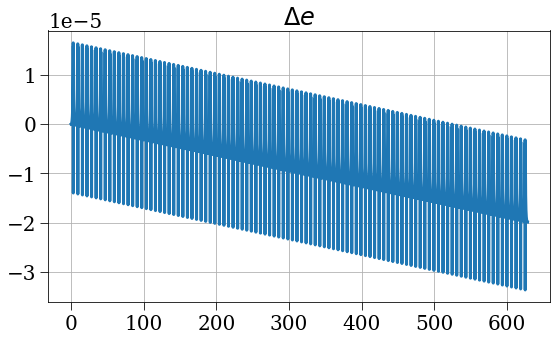

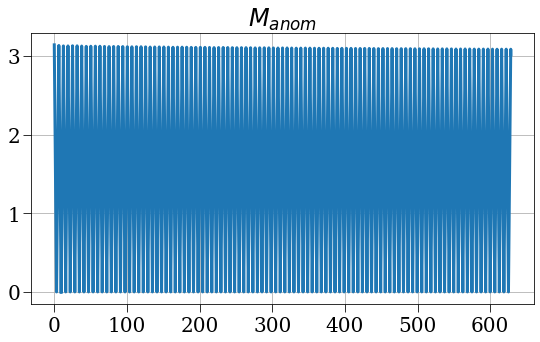

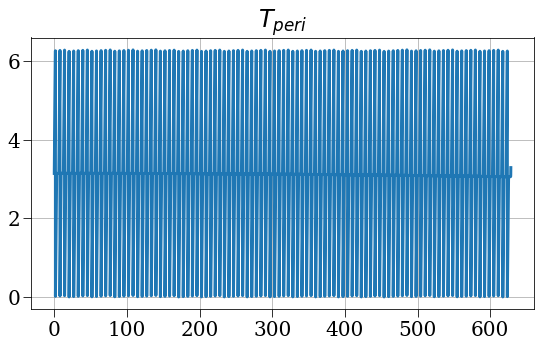

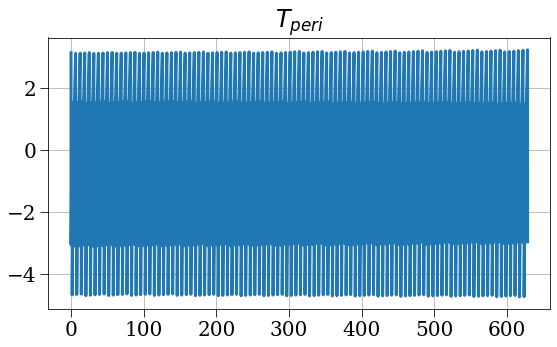

In [34]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

# continues past 2pi
#M_anom = np.unwrap(M_anom)

T_peri = t - 1/np.sqrt(menc) * M_anom
T = 2*np.pi * np.sqrt(a**3/menc)
T_peri_true = (T - t) % T
print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
plt.plot(t, M_anom)
plt.title(r'$M_{anom}$')
plt.figure()
plt.plot(t, T_peri % T)
plt.title(r'$T_{peri}$')
plt.figure()
plt.plot(t, (T_peri % T) - T_peri_true)
plt.title(r'$T_{peri}$')

### 'Symplectic' Leapfrog - 1000 orbits - ~5000 steps per orbit

1.9 0.9999999999999999
0.9


2025-06-19 10:40:05,286 - collapse - INFO - Simulation setup complete


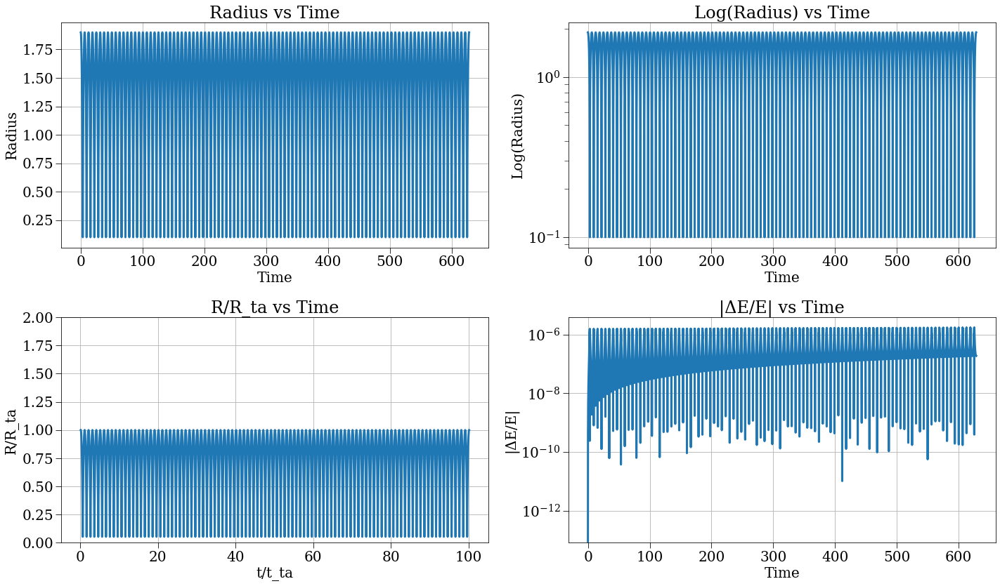

In [6]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1-e**2) / (1-e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=200*np.pi, j_coef=j_coef, save_dt=1e-4, rho_bar=rho_bar, safety_factor=1e-3, stepper_strategy='leapfrog_hut', timestep_strategy='const_but_calculate')
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


[6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]


Text(0.5, 1.0, '$T_{peri}$')

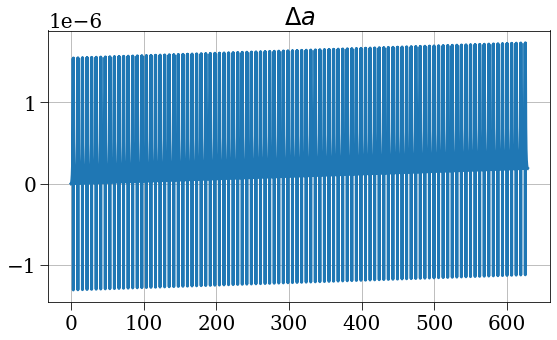

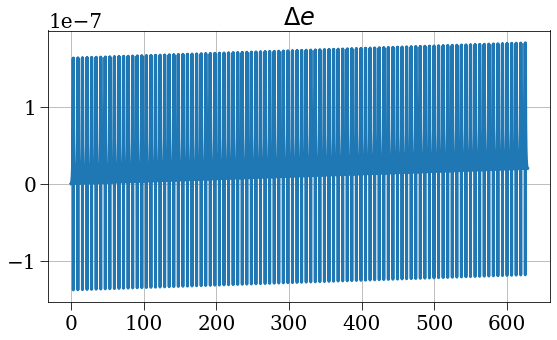

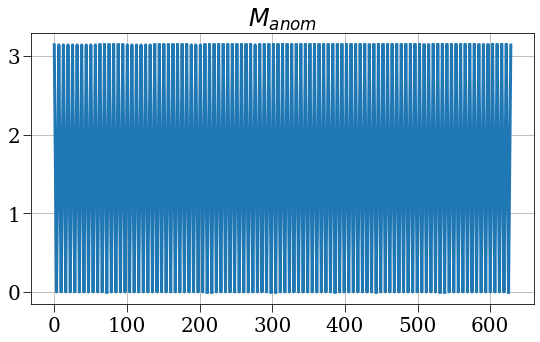

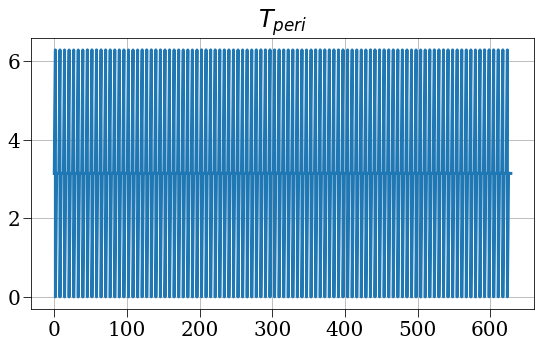

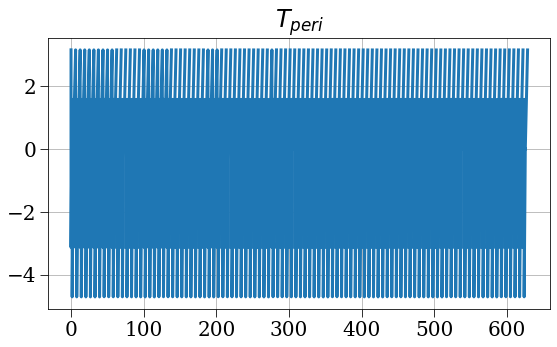

In [28]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

# continues past 2pi
#M_anom = np.unwrap(M_anom)

T_peri = t - 1/np.sqrt(menc) * M_anom
T = 2*np.pi * np.sqrt(a**3/menc)
T_peri_true = (T - t) % T
print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
plt.plot(t, M_anom)
plt.title(r'$M_{anom}$')
plt.figure()
plt.plot(t, T_peri % T)
plt.title(r'$T_{peri}$')
plt.figure()
plt.plot(t, (T_peri % T) - T_peri_true)
plt.title(r'$T_{peri}$')

### Naive Leapfrog - 1000 orbits - ~5000 steps per orbit

2025-06-18 17:35:17,585 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


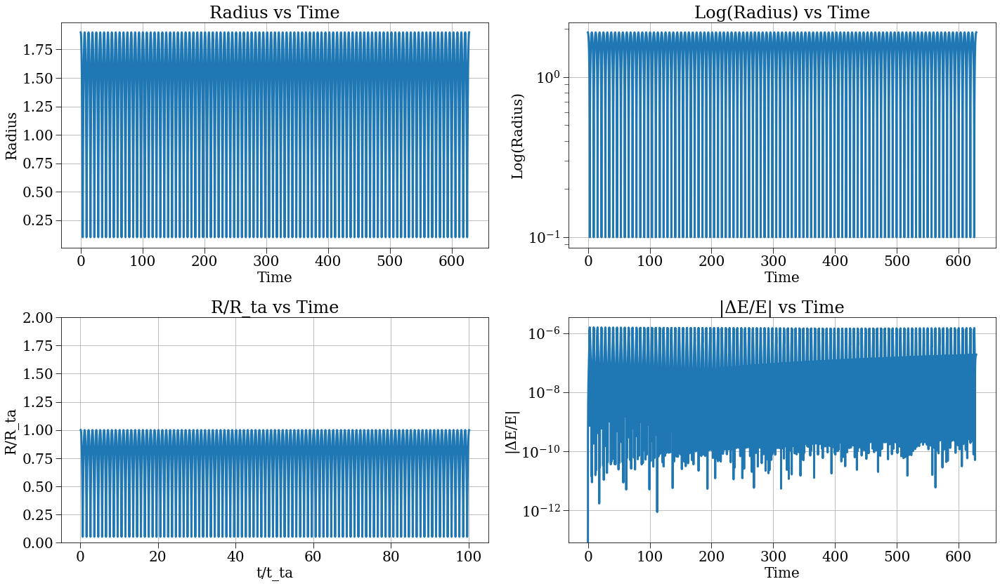

In [29]:
# to get menc = 1 ---> rho_bar = 3/(4pi)
a = 1
e = 0.9
r_max = a * (1-e**2) / (1-e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=200*np.pi, j_coef=j_coef, save_dt=1e-4, rho_bar=rho_bar, safety_factor=1e-3,)
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in arccos
  


[6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]


Text(0.5, 1.0, '$T_{peri}$')

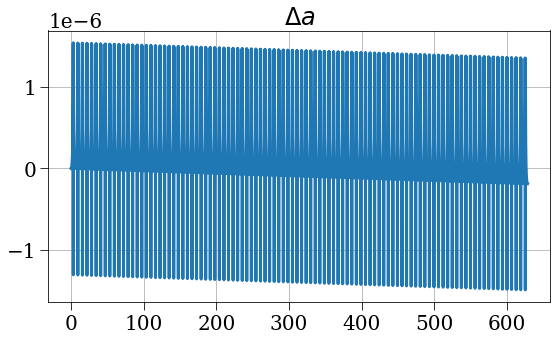

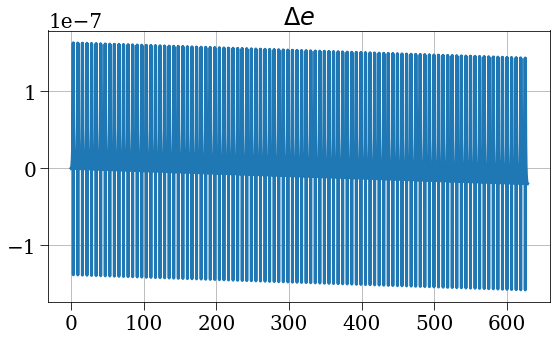

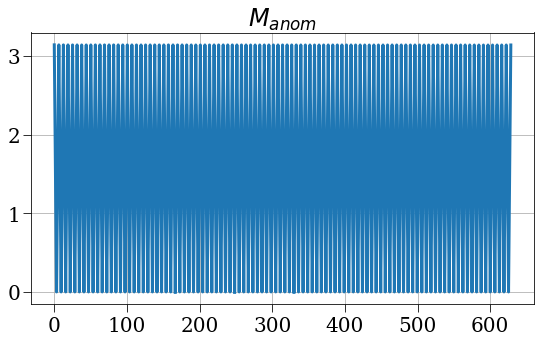

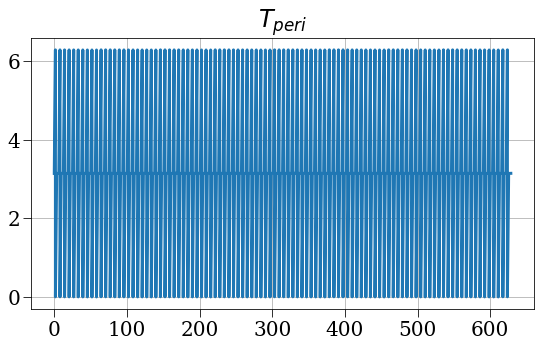

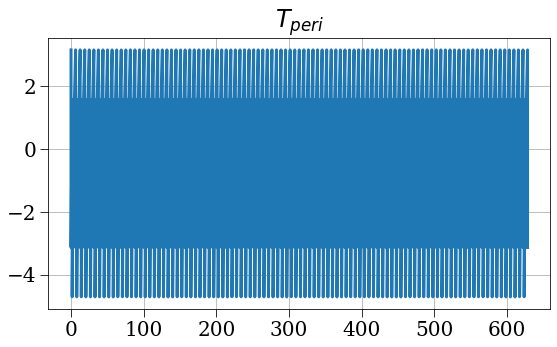

In [30]:
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False

r = results['r'][:,0]
E_tot = results['e_tot'][:,0]
menc = results['m_enc'][:,0]
t = results['t']
E_anom = np.arccos((1-r/a)/e)
avals = menc / np.abs(2*E_tot)
evals = np.sqrt(1 + 2*E_tot*j_coef**2/menc**2)
M_anom = E_anom - evals*np.sin(E_anom)

# continues past 2pi
#M_anom = np.unwrap(M_anom)

T_peri = t - 1/np.sqrt(menc) * M_anom
T = 2*np.pi * np.sqrt(a**3/menc)
T_peri_true = (T - t) % T
print(T)

plt.plot(t, avals-a)
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(t, evals-e)
plt.title(r'$\Delta e$')
plt.figure()
plt.plot(t, M_anom)
plt.title(r'$M_{anom}$')
plt.figure()
plt.plot(t, T_peri % T)
plt.title(r'$T_{peri}$')
plt.figure()
plt.plot(t, (T_peri % T) - T_peri_true)
plt.title(r'$T_{peri}$')

2025-06-18 19:42:41,359 - collapse - INFO - Simulation setup complete


1.9 0.9999999999999999
0.9


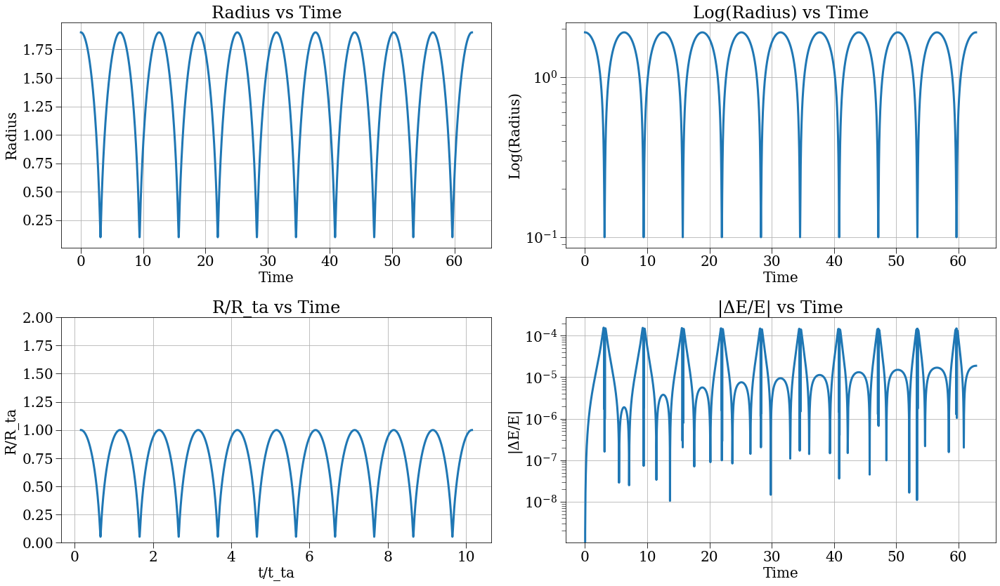

In [26]:
a = 1
e = 0.9
r_max = a * (1+e)
rho_bar = 3/(4*np.pi) * 1/r_max**3
menc = 4/3 * np.pi * r_max**3 * rho_bar
print(r_max, menc)
j_coef = np.sqrt(0.19)
config = make_config(N=1, r_min=0, r_max=r_max, t_max=20*np.pi, j_coef=j_coef, save_dt=1e-5, rho_bar=rho_bar, safety_factor=1e-2, stepper_strategy='leapfrog_kdk')
e = kepler_e(menc=menc, r=r_max, v=0, j=j_coef)
print(e)
sc, results, plotter = run_sc(config)

### 1000 steps per orbit

1.9
Number of steps: 1673665
Number of steps: 1673550
Max loops: inf


Text(0.5, 1.0, 'dt')

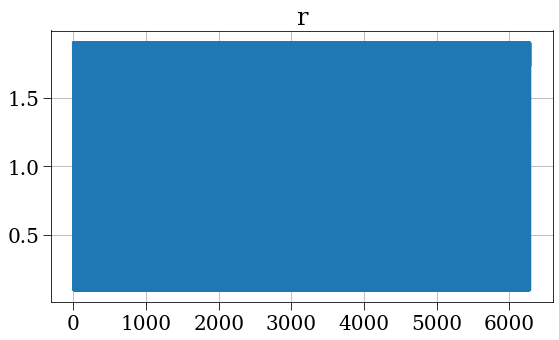

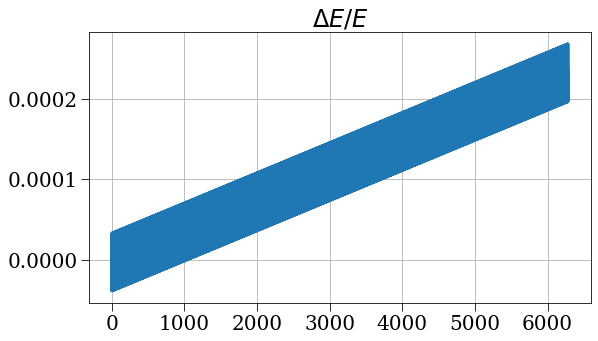

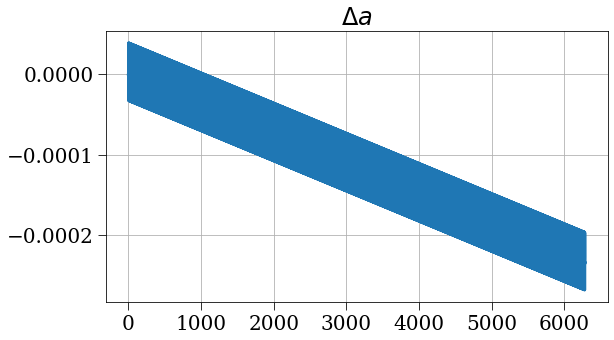

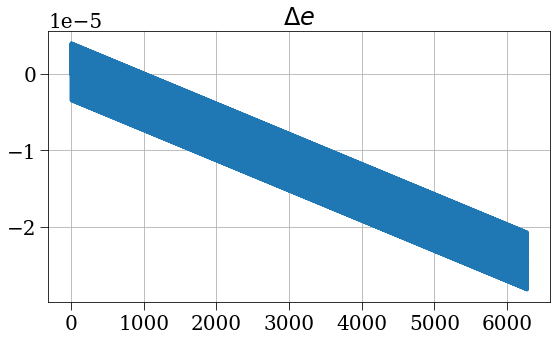

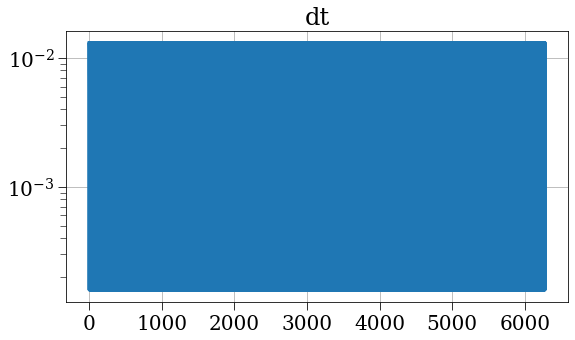

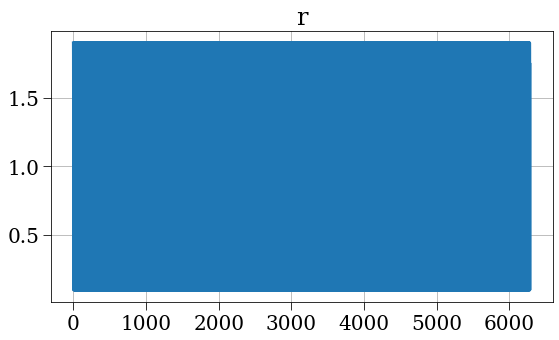

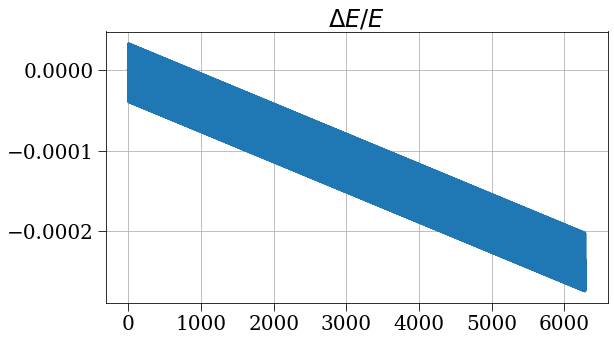

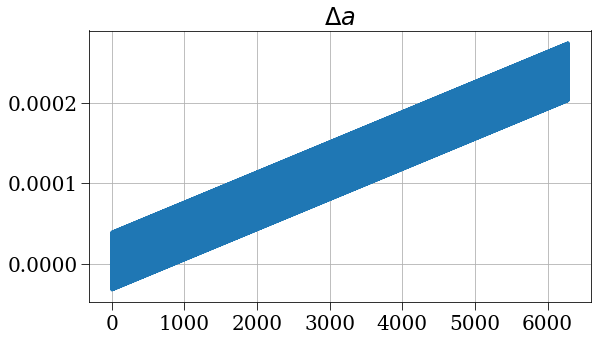

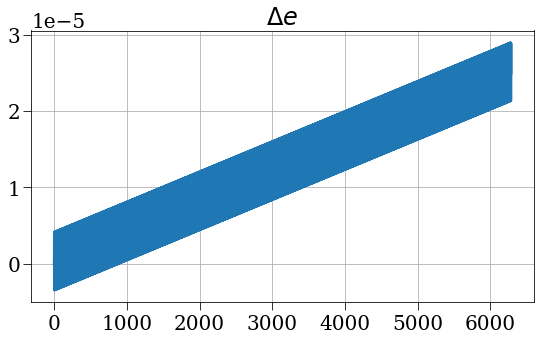

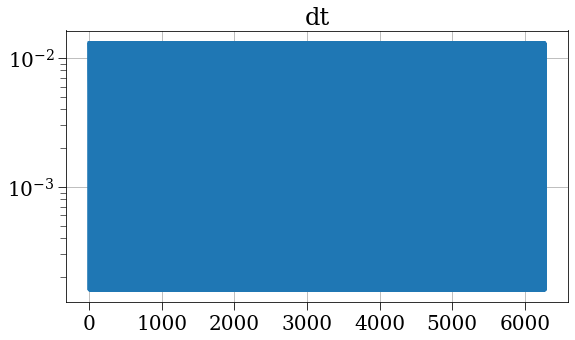

In [66]:
a = 1
e = 0.9
r_max = a * (1+e)
print(r_max)

def calc_a(r, M, j):
    return -M/r**2 + j**2/r**3

def kick(v, a, dt):
    return v + 0.5*a*dt

def drift(r, v, dt):
    return r + v*dt

def take_step(r, v, dt, M, j):
    a = calc_a(r, M, j) 
    v_half = kick(v, a, dt)
    r_new = drift(r, v_half, dt)
    a = calc_a(r_new, M, j)
    v_new = kick(v_half, a, dt)
    return r_new, v_new

def t_dyn(r, M):
    return np.sqrt(r**3/M)

def dt_calc(r, M, safety):
    return t_dyn(r, M) * safety

def simulate(r0=r_max, v0=0, M=1, j=np.sqrt(0.19), safety_factor=1e-2, t_max=10):
    rvals = [r0]
    vvals = [v0]
    tvals = [0]
    dt = dt_calc(r0, M, safety_factor)
    n_steps = 0
    while tvals[-1] < t_max:
        r_new, v_new = take_step(rvals[-1], vvals[-1], dt, M, j)
        rvals.append(r_new)
        vvals.append(v_new)
        tvals.append(tvals[-1] + dt)
        dt = dt_calc(r_new, M, safety_factor)
        n_steps += 1
    print(f"Number of steps: {n_steps}")
    return tvals, rvals, vvals

def simulate_symplectic(r0=r_max, v0=0, M=1, j=np.sqrt(0.19), safety_factor=1e-2, t_max=10, max_loops=np.inf):
    rvals = [r0]
    vvals = [v0]
    tvals = [0]
    dt = dt_calc(r0, M, safety_factor)
    n_steps = 0
    while tvals[-1] < t_max:
        # iterate until dt is converged
        loops = 0
        while loops < max_loops:
            loops += 1
            r_new, v_new = take_step(rvals[-1], vvals[-1], dt, M, j)
            dt_new = dt_calc(r_new, M, safety_factor)
            if np.abs(dt_new - dt) < 1e-10:
                max_loops = max(max_loops, loops)
                break
            dt = 0.5 * (dt + dt_new)
        rvals.append(r_new)
        vvals.append(v_new)
        tvals.append(tvals[-1] + dt)
        dt = dt_calc(r_new, M, safety_factor)
        n_steps += 1
    print(f"Number of steps: {n_steps}")
    print(f"Max loops: {max_loops}")
    return tvals, rvals, vvals

def calc_E(r, v, M, j):
    return 0.5*v**2 - M/r + j**2/(2*r**2)

def calc_semi_major_axis(r, v, M, j):
    E = calc_E(r, v, M, j)
    return M/(2*np.abs(E))

def calc_e(r, v, M, j):
    E = calc_E(r, v, M, j)
    return np.sqrt(1 + 2*E*j**2/M**2)

tvals, rvals, vvals = simulate(r0=r_max, v0=0, M=1, safety_factor=5e-3, t_max=2000*np.pi, j=np.sqrt(0.19))
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, 1, np.sqrt(0.19))
a_vals = calc_semi_major_axis(rvals, vvals, 1, np.sqrt(0.19))
e_vals = calc_e(rvals, vvals, 1, np.sqrt(0.19))
plt.figure()
plt.plot(tvals, rvals)
plt.title('r')
plt.figure()
plt.plot(tvals, (Evals-Evals[0])/Evals[0])
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')

tvals, rvals, vvals = simulate_symplectic(r0=r_max, v0=0, M=1, safety_factor=5e-3, t_max=2000*np.pi, j=np.sqrt(0.19))
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, 1, np.sqrt(0.19))
a_vals = calc_semi_major_axis(rvals, vvals, 1, np.sqrt(0.19))
e_vals = calc_e(rvals, vvals, 1, np.sqrt(0.19))
plt.figure()
plt.plot(tvals, rvals)
plt.title('r')
plt.figure()
plt.plot(tvals, (Evals-Evals[0])/Evals[0])
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')


### 10,000 steps per orbit

Number of steps: 16736163
Number of steps: 16736162
Max loops: 14


Text(0.5, 1.0, 'dt')

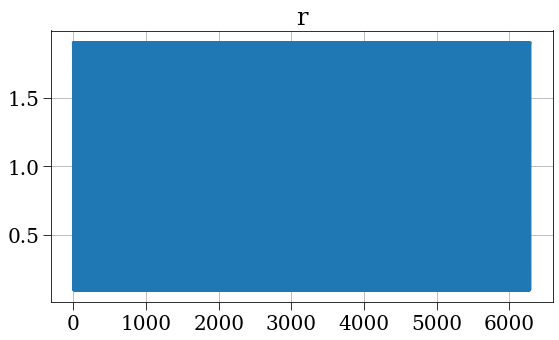

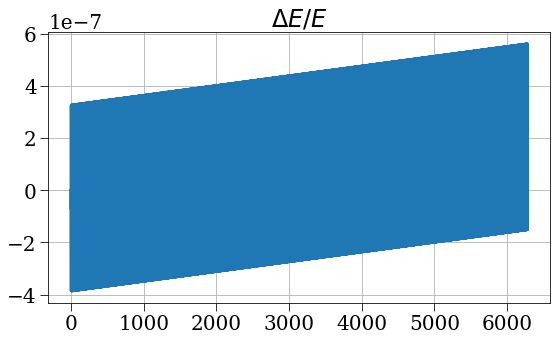

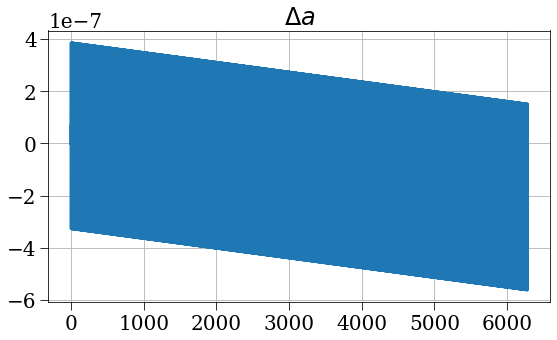

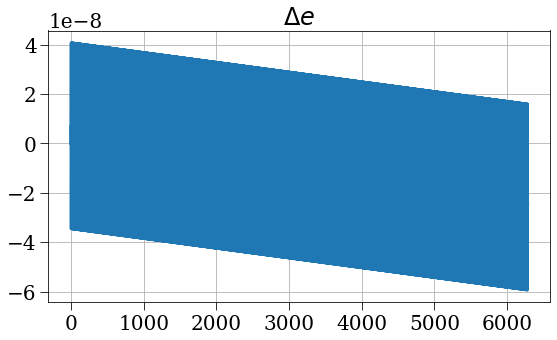

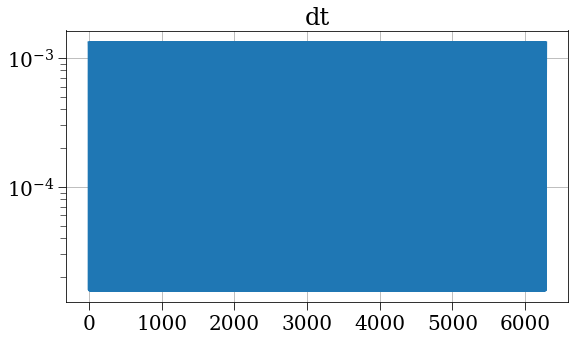

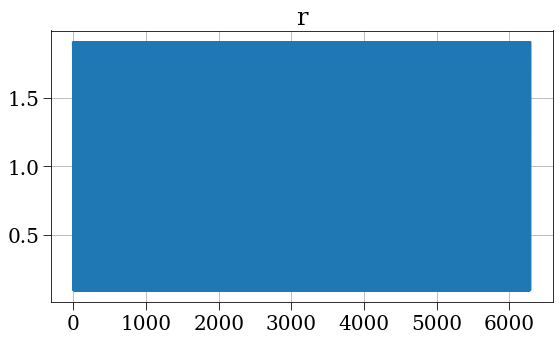

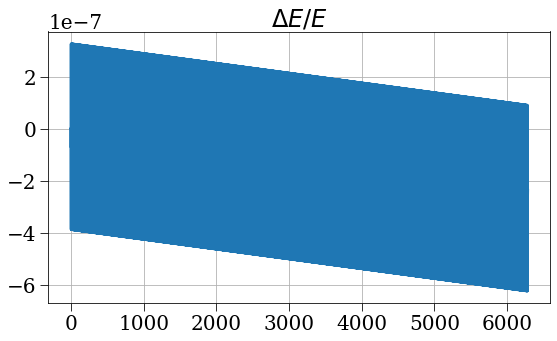

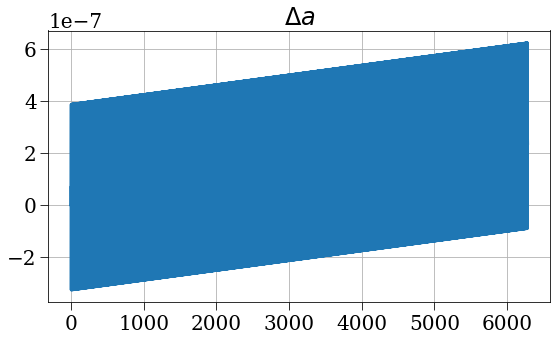

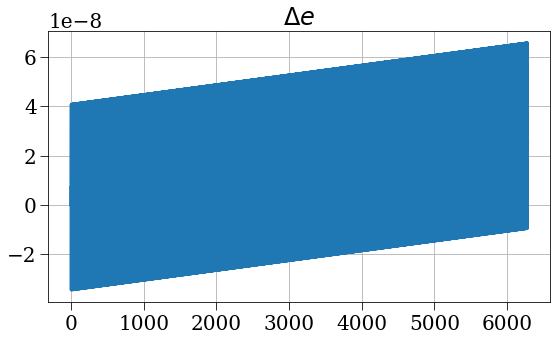

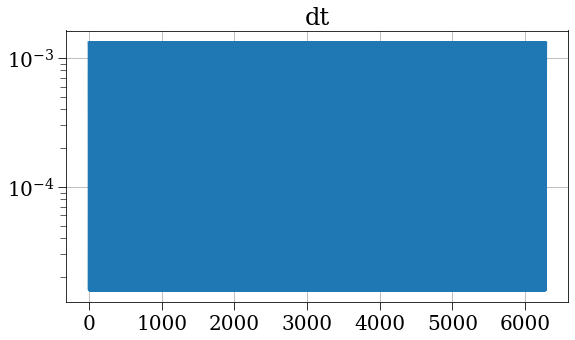

In [65]:
tvals, rvals, vvals = simulate(r0=r_max, v0=0, M=1, safety_factor=5e-4, t_max=2000*np.pi, j=np.sqrt(0.19))
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, 1, np.sqrt(0.19))
a_vals = calc_semi_major_axis(rvals, vvals, 1, np.sqrt(0.19))
e_vals = calc_e(rvals, vvals, 1, np.sqrt(0.19))
plt.figure()
plt.plot(tvals, rvals)
plt.title('r')
plt.figure()
plt.plot(tvals, (Evals-Evals[0])/Evals[0])
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')

tvals, rvals, vvals = simulate_symplectic(r0=r_max, v0=0, M=1, safety_factor=5e-4, t_max=2000*np.pi, j=np.sqrt(0.19))
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, 1, np.sqrt(0.19))
a_vals = calc_semi_major_axis(rvals, vvals, 1, np.sqrt(0.19))
e_vals = calc_e(rvals, vvals, 1, np.sqrt(0.19))
plt.figure()
plt.plot(tvals, rvals)
plt.title('r')
plt.figure()
plt.plot(tvals, (Evals-Evals[0])/Evals[0])
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')


Number of steps: 1673665
Max loops: 1


Text(0.5, 1.0, 'dt')

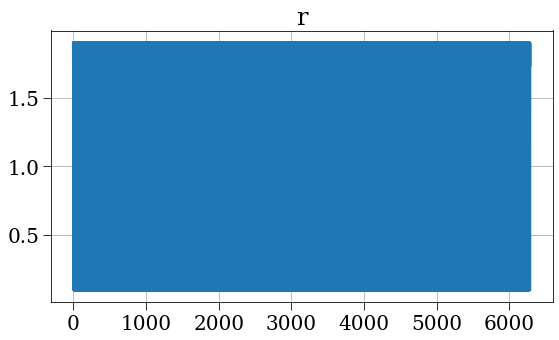

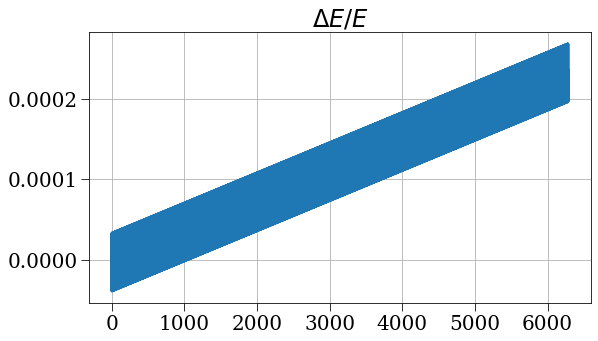

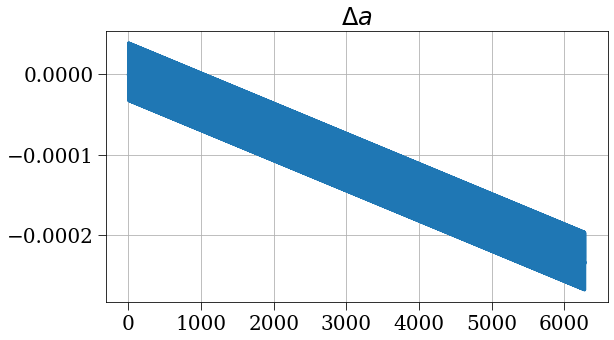

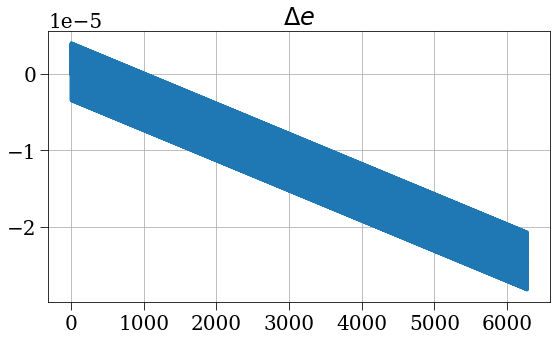

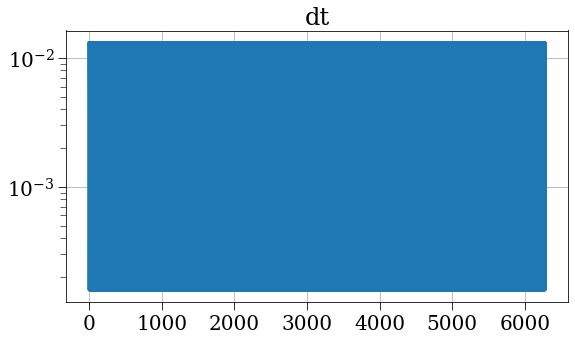

In [67]:
tvals, rvals, vvals = simulate_symplectic(r0=r_max, v0=0, M=1, safety_factor=5e-3, t_max=2000*np.pi, j=np.sqrt(0.19), max_loops=1)
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, 1, np.sqrt(0.19))
a_vals = calc_semi_major_axis(rvals, vvals, 1, np.sqrt(0.19))
e_vals = calc_e(rvals, vvals, 1, np.sqrt(0.19))
plt.figure()
plt.plot(tvals, rvals)
plt.title('r')
plt.figure()
plt.plot(tvals, (Evals-Evals[0])/Evals[0])
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')

### minimal examples

In [4]:
def calc_a(r, M, j, eps=0):
    return -M/(r**2 + eps**2) + j**2/r**3

def kick(v, a, dt):
    return v + 0.5*a*dt

def drift(r, v, dt):
    return r + v*dt

def take_step(r, v, dt, M, j):
    a = calc_a(r, M, j) 
    v_half = kick(v, a, dt)
    r_new = drift(r, v_half, dt)
    a = calc_a(r_new, M, j)
    v_new = kick(v_half, a, dt)
    return r_new, v_new

def t_dyn(r, M):
    return np.sqrt(r**3/M)

def t_vel(r, v):
    return r/np.abs(v)

def dt_calc(r, M, v, safety, use_vel=False, fixed_dt=None):
    if fixed_dt is not None:
        return fixed_dt
    t_dyn_step = t_dyn(r, M) * safety
    if use_vel:
        t_vel_step = t_vel(r, v)*safety
        if t_vel_step < t_dyn_step:
            #print(f"Using velocity time step: {t_vel_step} vs {t_dyn_step} dynamic time step")
            return t_vel_step
    return t_dyn_step

def simulate(r0=1.9, v0=0, M=1, j=np.sqrt(0.19), safety_factor=1e-2, t_max=10, use_vel=False, fixed_dt=None):
    rvals = [r0]
    vvals = [v0]
    tvals = [0]
    dt = dt_calc(r0, M, v0, safety_factor, use_vel, fixed_dt)
    n_steps = 0
    while tvals[-1] < t_max:
        r_new, v_new = take_step(rvals[-1], vvals[-1], dt, M, j)
        rvals.append(r_new)
        vvals.append(v_new)
        tvals.append(tvals[-1] + dt)
        dt = dt_calc(r_new, M, v_new, safety_factor, use_vel, fixed_dt)
        n_steps += 1
    print(f"Number of steps: {n_steps}")
    return tvals, rvals, vvals

def simulate_symplectic(r0=1.9, v0=0, M=1, j=np.sqrt(0.19), safety_factor=1e-2, t_max=10, max_loops=np.inf, iterate=True, use_vel=False, fixed_dt=None):
    rvals = [r0]
    vvals = [v0]
    tvals = [0]
    dt = dt_calc(r0, M, v0, safety_factor, use_vel, fixed_dt)
    dt_guess = dt
    dt_new = np.inf
    n_steps = 0
    max_iters = 0
    while tvals[-1] < t_max:
        if iterate:
        # iterate until dt is converged
            loops = 0
            while (not np.isclose(dt_guess, dt_new, atol=1e-16, rtol=1e-9)) and (loops < max_loops):
                loops += 1
                r_new, v_new = take_step(rvals[-1], vvals[-1], dt_guess, M, j)
                dt_new = dt_calc(r_new, M, v_new, safety_factor, use_vel, fixed_dt)
                dt_guess = 0.5 * (dt + dt_new)
                max_iters = max(max_iters, loops)
            dt = dt_guess             
        else:
            # perform 1 step to get correct symmetric dt
            r_new, v_new = take_step(rvals[-1], vvals[-1], dt, M, j)
            dt_new = dt_calc(r_new, M, v_new, safety_factor, use_vel, fixed_dt)
            dt = 0.5 * (dt + dt_new)
            # take the actual step using the calculated dt
            r_new, v_new = take_step(rvals[-1], vvals[-1], dt, M, j)
        rvals.append(r_new)
        vvals.append(v_new)
        tvals.append(tvals[-1] + dt)
        dt = dt_calc(r_new, M, v_new, safety_factor, use_vel, fixed_dt)
        n_steps += 1
    print(f"Number of steps: {n_steps}")
    print(f"Max number of iterations: {max_iters}")
    return tvals, rvals, vvals

def calc_E(r, v, M, j):
    return 0.5*v**2 - M/r + j**2/(2*r**2)

def calc_semi_major_axis(r, v, M, j):
    E = calc_E(r, v, M, j)
    return M/(2*np.abs(E))

def calc_e(r, v, M, j):
    E = calc_E(r, v, M, j)
    return np.sqrt(1 + 2*E*j**2/M**2)

0.00019998999999992775
Number of steps: 17845
Number of steps: 17928
Max number of iterations: 0
Number of steps: 17927
Max number of iterations: 100


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:130: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memo

Text(0.5, 1.0, 'dt')

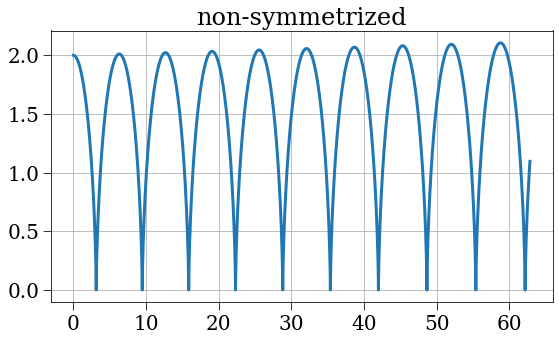

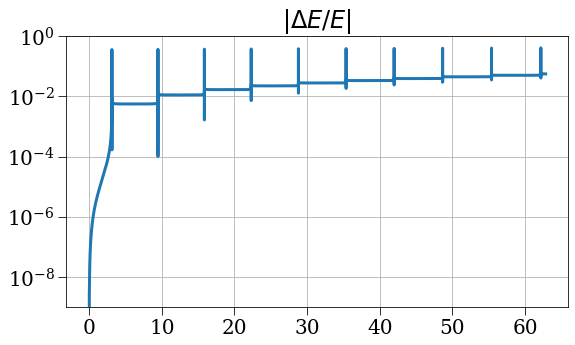

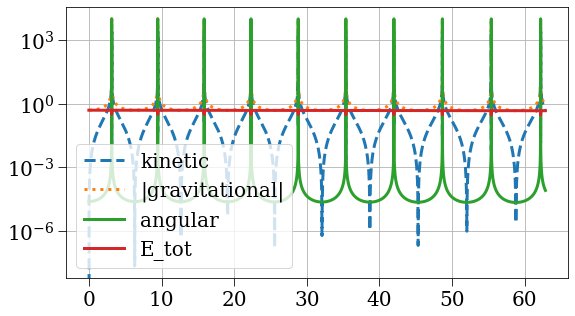

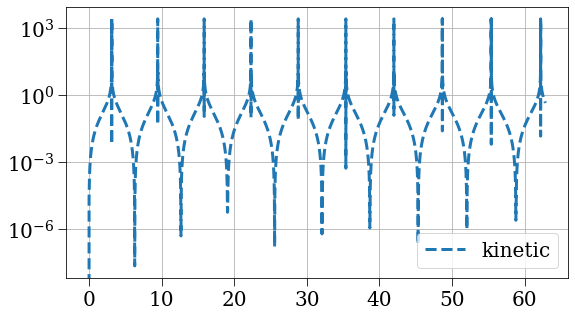

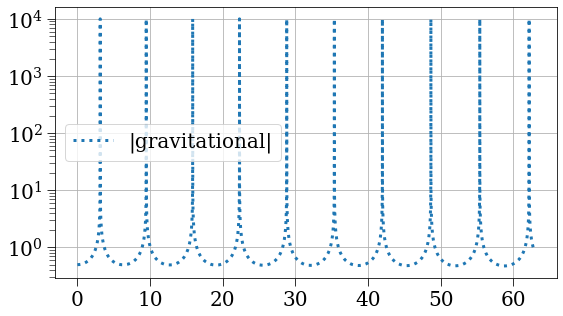

...

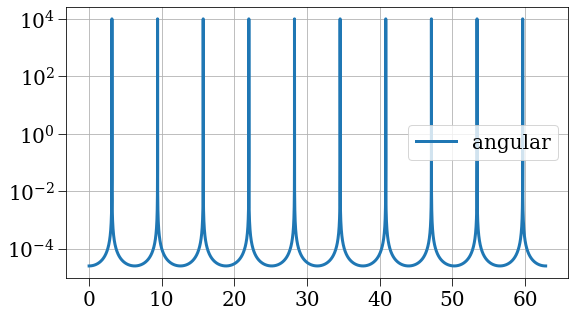

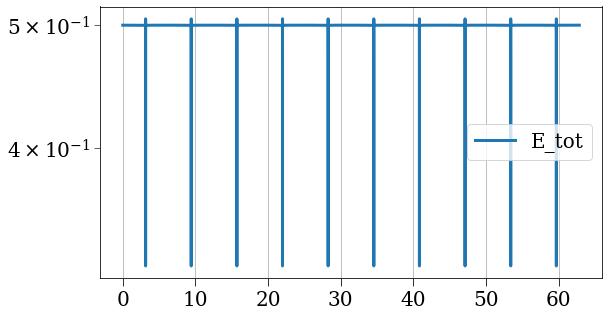

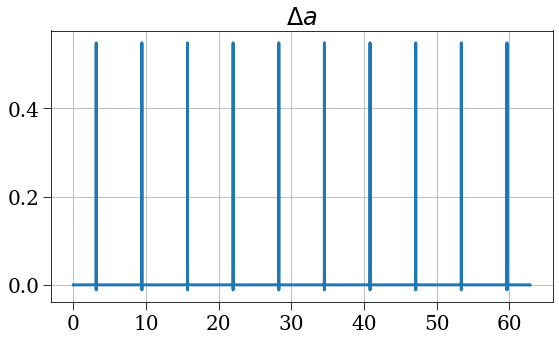

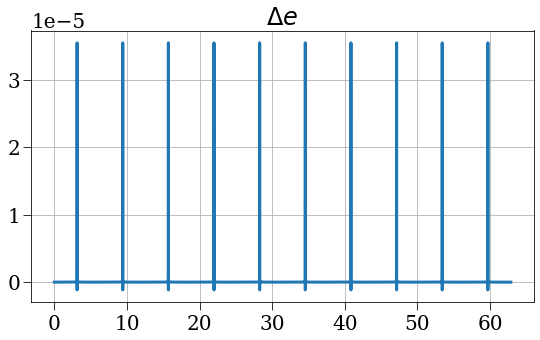

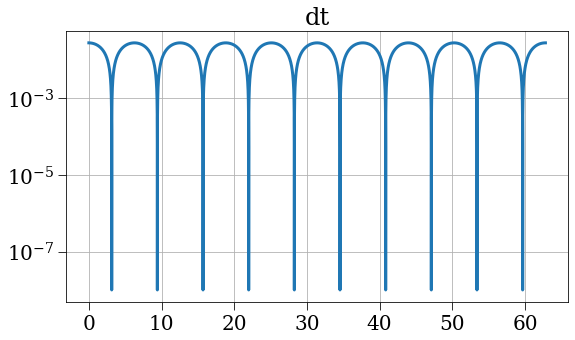

In [9]:
a = 1
e = 0.9999
r_max = a * (1+e)
r0 = r_max
v0 = 0
M = 1
safety_factor = 1e-2
j = np.sqrt(1-e**2)
t_max = 20*np.pi
use_vel = False
print(j**2)
energy_xlim = None#(np.pi-1e-5, np.pi+1e-5)

tvals, rvals, vvals = simulate(r0=r0, v0=v0, M=M, safety_factor=safety_factor, t_max=t_max, j=j, use_vel=use_vel)
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, M, j)
a_vals = calc_semi_major_axis(rvals, vvals, M, j)
e_vals = calc_e(rvals, vvals, M, j)
plt.figure()
plt.title('non-symmetrized')
plt.plot(tvals, rvals)
#plt.title('r')
plt.figure()
del_E_on_E = np.abs((Evals-Evals[0])/Evals[0])
plt.semilogy(tvals, del_E_on_E)
plt.title(r'$\left|\Delta E/E\right|$')
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')

tvals, rvals, vvals = simulate_symplectic(r0=r0, v0=v0, M=M, safety_factor=safety_factor, t_max=t_max, j=j, iterate=False, use_vel=use_vel)
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, M, j)
a_vals = calc_semi_major_axis(rvals, vvals, M, j)
e_vals = calc_e(rvals, vvals, M, j)
plt.figure()
plt.title('symmetrized')
plt.plot(tvals, rvals)
#plt.title('r')
plt.figure()
del_E_on_E = np.abs((Evals-Evals[0])/Evals[0])
plt.semilogy(tvals, del_E_on_E)
plt.title(r'$\left|\Delta E/E\right|$')
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')

tvals, rvals, vvals = simulate_symplectic(r0=r0, v0=v0, M=M, safety_factor=safety_factor, t_max=t_max, j=j, iterate=True, max_loops=100, use_vel=use_vel)
tvals, rvals, vvals = np.array(tvals), np.array(rvals), np.array(vvals)
Evals = calc_E(rvals, vvals, M, j)
a_vals = calc_semi_major_axis(rvals, vvals, M, j)
e_vals = calc_e(rvals, vvals, M, j)
plt.figure()
plt.title('iterative symmetrized')
plt.plot(tvals, rvals)
plt.figure()
del_E_on_E = np.abs((Evals-Evals[0])/Evals[0])
plt.semilogy(tvals, del_E_on_E)
plt.title(r'$\left|\Delta E/E\right|$')
plt.title(r'$\Delta E/E$')
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.xlim(energy_xlim)
plt.figure()
plt.plot(tvals, 0.5*vvals**2, label='kinetic', ls='--')
plt.legend()
plt.yscale('log')
plt.figure()
plt.plot(tvals, M/rvals, label='|gravitational|', ls=':')
plt.legend()
plt.yscale('log')
plt.figure()
plt.plot(tvals, j**2/(2*rvals**2), label='angular')
plt.legend()
plt.yscale('log')
plt.figure()
plt.plot(tvals, np.abs(Evals), label='E_tot')
plt.legend()
plt.yscale('log')
plt.figure()
plt.plot(tvals, a_vals-a_vals[0])
plt.title(r'$\Delta a$')
plt.figure()
plt.plot(tvals, e_vals-e_vals[0])
plt.title(r'$\Delta e$')
plt.figure()
plt.semilogy(tvals[:-1], np.abs(tvals[1:]-tvals[:-1]))
plt.title('dt')
